## IGO17543 KP Slc4a11-MCD Rosa26 - mTmG/+ (and Hopx-MACD) exposed tog Tamoxifen for 14d at 12 weeks
7/17/25 - Data generated from 12 week KP Slc4a11-MCD/+ R26-mTmG/+ tumors; data submitted by CHP/EB on 7/?/2025; analyzed by JC 7/30/2025

Analyze global run on cellranger v8 data and create h5_ad files for further analysis - w/o introns

In [10]:
import numpy as np
import pandas as pd
import scanpy as sc

import math
import matplotlib

from pathlib import Path
import anndata

In [11]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=80, facecolor='white')
np.random.seed(1573)   #fix so we can reproduce later

In [12]:
#Path("./figures/umapfigures").mkdir(parents=True, exist_ok=True) # generate figures here
Path("./write").mkdir(parents=True, exist_ok=True) # write h5ad here

In [13]:
results_file = 'write/IGO17543-KP12w14dTraced.h5ad'  # the file that will store the analysis results

Read in the count matrix into an [`AnnData`](https://anndata.readthedocs.io/en/latest/anndata.AnnData.html) object, which holds many slots for annotations and different representations of the data. It also comes with its own HDF5 file format: `.h5ad`.

In [14]:
adata = sc.read_10x_h5('IGO17543-filtered_feature_bc_matrix.h5', gex_only=False)

reading IGO17543-filtered_feature_bc_matrix.h5
 (0:00:00)


/Users/chanj2/opt/miniconda3/envs/scbackup3/lib/python3.11/site-packages/anndata/_core/anndata.py:1758: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [15]:
adata.var_names_make_unique()  # this is unnecessary if using `var_names='gene_ids'` in `sc.read_10x_mtx`

In [16]:
samples = list(adata[:,adata.var['feature_types']=='Antibody Capture'].var.index)

In [17]:
# Now filter out barcodes
hashadata = adata[:,samples]
adata = adata[:,[y for y in adata.var_names if y not in samples]]

In [18]:
hashadata.var

,gene_ids,feature_types,genome,pattern,read,sequence
BR1582_B0306,BR1582_B0306,Antibody Capture,,5PNNNNNNNNNN(BC)NNNNNNNNN,R2,TATGCTGCCACGGTA
BR1608_B0307,BR1608_B0307,Antibody Capture,,5PNNNNNNNNNN(BC)NNNNNNNNN,R2,GAGTCTGCCAGTATC
BQ1920_B0308,BQ1920_B0308,Antibody Capture,,5PNNNNNNNNNN(BC)NNNNNNNNN,R2,TATAGAACGCCAGGC
BP1479_B0309,BP1479_B0309,Antibody Capture,,5PNNNNNNNNNN(BC)NNNNNNNNN,R2,TGCCTATGAAACAAG


## Preprocessing

/Users/chanj2/opt/miniconda3/envs/scbackup3/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:269: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:00)


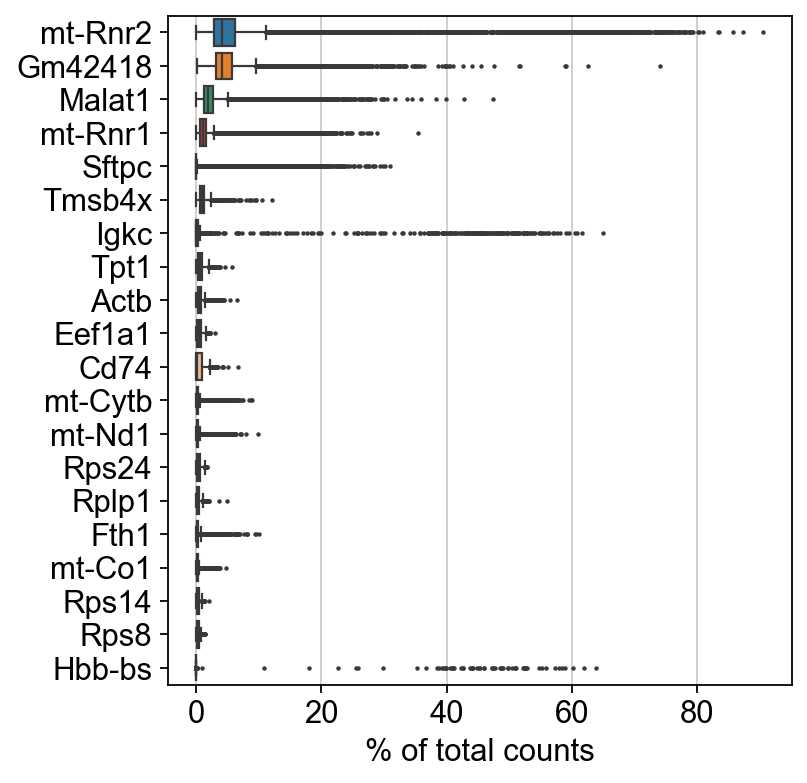

In [19]:
sc.pl.highest_expr_genes(adata, n_top=20, )

In [20]:
sc.pp.filter_cells(adata, min_counts=1500)
sc.pp.filter_cells(adata, min_genes=300)
sc.pp.filter_genes(adata, min_cells=3)

filtered out 870 cells that have less than 1500 counts
filtered out 378 cells that have less than 300 genes expressed
filtered out 31634 genes that are detected in less than 3 cells


In [21]:
adata.var['mt'] = adata.var_names.str.startswith('mt-') # annotate the group of mitochondrial genes as 'MT'
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

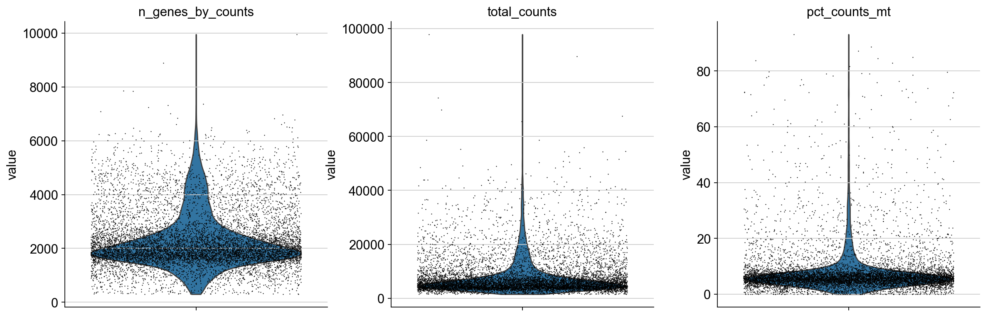

In [22]:
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True, rotation=90)

(array([6.000e+00, 2.000e+00, 6.000e+00, 2.600e+01, 1.250e+02, 1.210e+02,
        2.320e+02, 1.487e+03, 5.784e+03, 1.450e+03]),
 array([0.60104734, 0.63398546, 0.66692357, 0.69986169, 0.73279981,
        0.76573792, 0.79867604, 0.83161415, 0.86455227, 0.89749039,
        0.9304285 ]),
 <BarContainer object of 10 artists>)

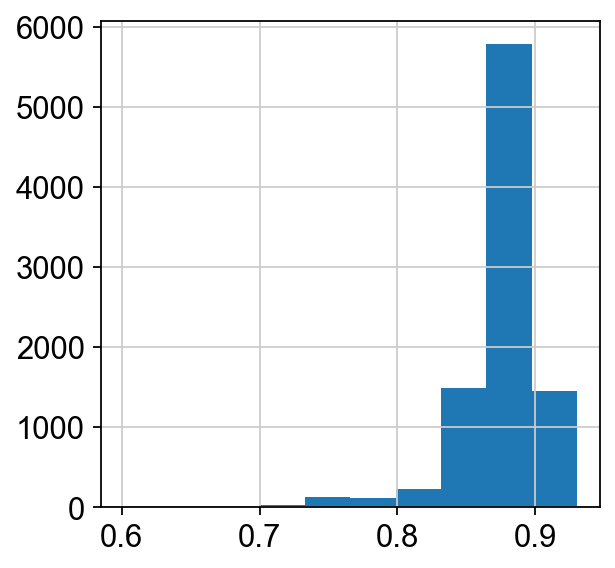

In [23]:
adata.obs["log10GenesPerUMI"] = adata.obs['n_genes_by_counts'].apply(math.log10) / adata.obs['total_counts'].apply(math.log10)
matplotlib.pyplot.hist(adata.obs["log10GenesPerUMI"])

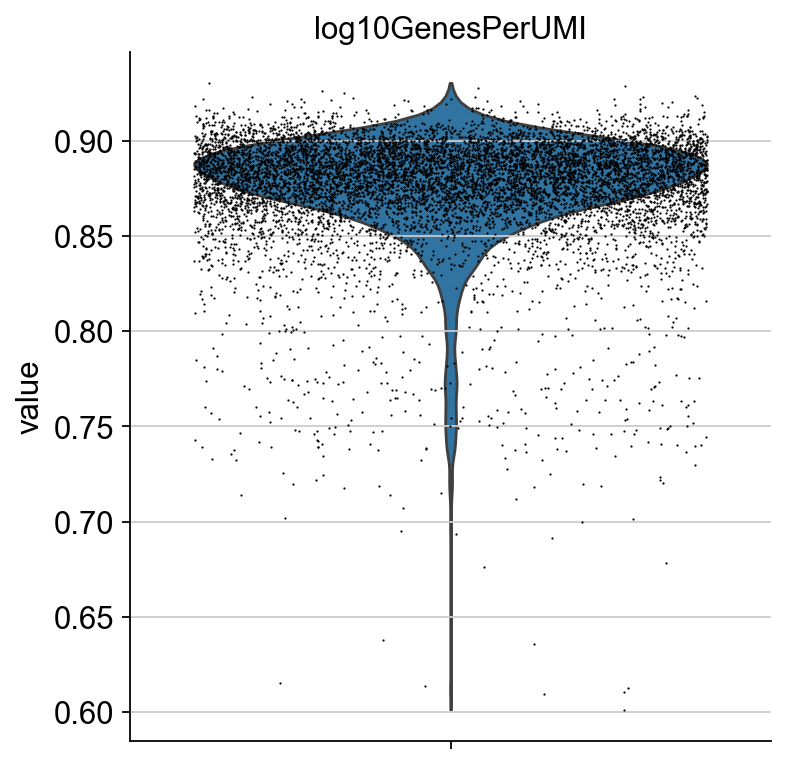

In [24]:
sc.pl.violin(adata, ['log10GenesPerUMI'],
             jitter=0.4, multi_panel=True, rotation=90)

In [25]:
#Filter by Log10GenesPerUMI
adata = adata[adata.obs.log10GenesPerUMI >= 0.8,:]

In [26]:
adata = adata[adata.obs.pct_counts_mt <= 20, :]

## Run Demultiplexing

In [27]:
hashadata = hashadata[hashadata.obs.index.isin(adata.obs.index), :]

In [28]:
hashadata.var_names

Index(['BR1582_B0306', 'BR1608_B0307', 'BQ1920_B0308', 'BP1479_B0309'], dtype='object')

In [29]:
hashCounts = pd.DataFrame(hashadata.X.todense(), columns=hashadata.var_names, index=adata.obs.index)

In [30]:
hashDisc = hashCounts.describe([.1,.2,.3,.4,.5,.6,.7,.8,.9,0.99])
#hashDisc

In [31]:
hashIDs = hashCounts.copy()
hashID = hashadata.var_names
for hashName in hashadata.var_names:
    print(hashName)
    print(hashDisc.loc["90%",hashName])
    hashIDs.loc[:,hashName] = hashCounts.loc[:,hashName] > hashDisc.loc["90%",hashName]
#hashIDs

BR1582_B0306
4.0
BR1608_B0307
5308.5
BQ1920_B0308
256.0
BP1479_B0309
27.0


/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_28757/4170078627.py:6: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[False False False ...  True False False]' has dtype incompatible with float32, please explicitly cast to a compatible dtype first.
  hashIDs.loc[:,hashName] = hashCounts.loc[:,hashName] > hashDisc.loc["90%",hashName]
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_28757/4170078627.py:6: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[ True False False ... False False False]' has dtype incompatible with float32, please explicitly cast to a compatible dtype first.
  hashIDs.loc[:,hashName] = hashCounts.loc[:,hashName] > hashDisc.loc["90%",hashName]
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_28757/4170078627.py:6: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise 

In [32]:
from matplotlib import pyplot as plt

In [33]:
plt.rcParams['svg.fonttype'] = 'none'
plt.rcParams["font.family"] = "Arial"
plt.rcParams['figure.figsize'] = (3,4)

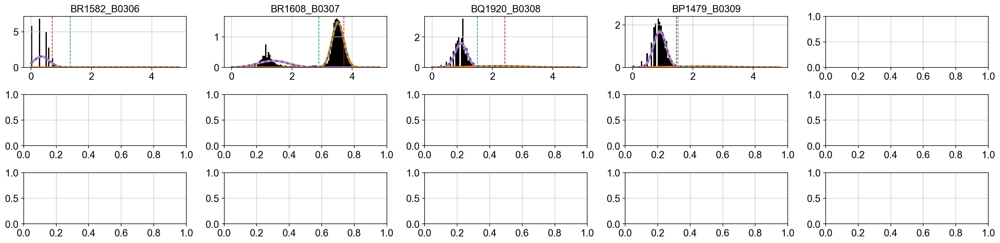

In [34]:
from sklearn.mixture import BayesianGaussianMixture
from scipy.stats import norm
fig, axs = plt.subplots(3,5, figsize =(20, 5))
dfHashBoundry = pd.DataFrame(np.zeros(len(hashadata.var_names)),hashadata.var_names, columns=["boundry"])
gmm = BayesianGaussianMixture(n_components=2, random_state=250,init_params='k-means++')
binEx = np.arange(0,5,5/100).reshape(-1,1)

import pdb
for i, hashName in enumerate(hashadata.var_names):
    hashCount = np.array(np.log10(hashCounts[hashName]+1)).reshape(-1, 1)
    fitGMM = gmm.fit(hashCount)
    mean = fitGMM.means_  
    covs  = fitGMM.covariances_
    weights = fitGMM.weights_
  
    fitGmmBound = fitGMM.predict(binEx)

    if mean[0][0] < mean[1][0]:
        left_idx, right_idx = 0, 1
    else:
        left_idx, right_idx = 1, 0

    
    x_axis = np.arange(0, 5, 0.1)
    
    y_left = norm.pdf(x_axis, float(mean[left_idx][0]), np.sqrt(float(covs[left_idx][0][0]))) * weights[left_idx]
    y_right = norm.pdf(x_axis, float(mean[right_idx][0]), np.sqrt(float(covs[right_idx][0][0]))) * weights[right_idx]

    hashBoundry = False #binEx[np.where(fitGmmBound == 1)[0][0]][0]  
    #print(hashName)
    #pdb.set_trace()
    #if hashName == "BJ1609_B0303":
    #if hashName == "BK1009_B0307":    
    #   pdb.set_trace()
    #print(hashName)
    # fix text case where GMM is modeled to occur around a hash by counting the number of switches
    #if mean[0][0] < mean[1][0] and (((y_axis1 < y_axis0)[0] == False and sum(v1 != v2 for v1, v2 in zip(y_axis1 < y_axis0, (y_axis1 < y_axis0)[1:])) % 2 == 0) or 
    #sum(v1 != v2 for v1, v2 in zip(y_axis1 < y_axis0, (y_axis1 < y_axis0)[1:])) == 1):
    #    hashBoundry = x_axis[np.where(y_axis1 < y_axis0)[0][-1]+2]
    #else:
    #    hashBoundry = x_axis[np.where(y_axis0 < y_axis1)[0][-1]+2]

    diff = y_right - y_left
    crossings = np.where(np.diff(np.sign(diff)) > 0)[0]  # where right overtakes left
    
    if len(crossings) > 0:
        # Take the first crossing where right becomes dominant
        idx = crossings[0]
        hashBoundry = x_axis[idx + 1]  # slightly to the right
    else:
        # If no intersection found, fall back to right mean or a fixed value
        hashBoundry = float(mean[right_idx][0])

    
    naiveBoundry = np.log10(int(hashDisc.loc["90%",hashName])+1)
    
    dfHashBoundry.loc[hashName] = hashBoundry
    
    # Plot 2
    axs[i//5,i%5].set_title(hashName)
    axs[i//5,i%5].axvline(naiveBoundry, c='C3', linestyle='dashed', linewidth=1) #red
    axs[i//5,i%5].axvline(hashBoundry, c='C2', linestyle='dashed', linewidth=1)  #green
    axs[i//5,i%5].hist(hashCount, density=True, color='black', bins=100)        
    axs[i//5,i%5].plot(x_axis, y_left, lw=3, c='C6')                            #pink
    axs[i//5,i%5].plot(x_axis, y_right, lw=3, c='C1')                            #orange
    axs[i//5,i%5].plot(x_axis, y_left+y_right, lw=3, c='C0', ls=':')            #dotted blue
    
plt.tight_layout(pad=1.0)
#plt.rcParams["figure.figsize"] = (20,5)
plt.show()

In [35]:
hashIDs = hashCounts.copy()
hashID = hashadata.var_names
#set manual minimum threshold to be 0.5
for hashName in hashadata.var_names:
    print(hashName)
    print(dfHashBoundry.loc[hashName].values[0])
    #manually set minimum threshold to 0.5 given poor HashData
#    if (dfHashBoundry.loc[hashName].values[0] < 1):
#        dfHashBoundry.loc[hashName].values[0] = 1
#    elif (dfHashBoundry.loc[hashName].values[0] > 2):
#        dfHashBoundry.loc[hashName].values[0] = 2
    print(dfHashBoundry.loc[hashName].values[0])
    hashIDs.loc[:,hashName] = np.log10(hashCounts.loc[:,hashName]+1) > dfHashBoundry.loc[hashName].values[0]
#hashIDs

BR1582_B0306
1.3
1.3
BR1608_B0307
2.9000000000000004
2.9000000000000004
BQ1920_B0308
1.5
1.5
BP1479_B0309
1.5
1.5


/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_28757/3886175043.py:13: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[False False False ...  True False False]' has dtype incompatible with float32, please explicitly cast to a compatible dtype first.
  hashIDs.loc[:,hashName] = np.log10(hashCounts.loc[:,hashName]+1) > dfHashBoundry.loc[hashName].values[0]
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_28757/3886175043.py:13: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[ True  True  True ... False  True  True]' has dtype incompatible with float32, please explicitly cast to a compatible dtype first.
  hashIDs.loc[:,hashName] = np.log10(hashCounts.loc[:,hashName]+1) > dfHashBoundry.loc[hashName].values[0]
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_28757/3886175043.py:13: FutureWarning: Setting an item of inc

In [36]:
classification = np.empty(len(adata), dtype="object")
i = 0
for cellBar, hashBool in hashIDs.iterrows():
    numHashes = sum(hashBool)
    if (numHashes == 1):
        classif = hashID[hashBool.values].values[0]
    elif (numHashes > 1):
        classif = "doublet"
    else:
        classif = "negative"
    classification[i] = classif
    i = i + 1
    #break

In [37]:
adata.obs["Classification"] = classification
hashadata.obs["Classification"] = classification
adata.obs["Classification"].value_counts()

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_28757/4135005838.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["Classification"] = classification
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_28757/4135005838.py:2: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  hashadata.obs["Classification"] = classification


Classification
BR1608_B0307    5716
BQ1920_B0308     993
negative         713
doublet          562
BP1479_B0309     531
BR1582_B0306      41
Name: count, dtype: int64

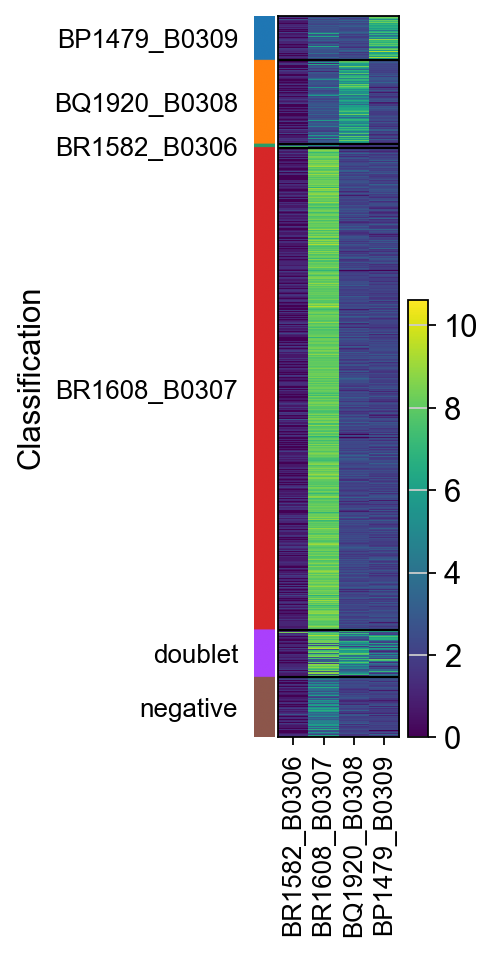

In [38]:
#output visulaization of hashing
sc.pl.heatmap(hashadata, hashadata.var_names, groupby="Classification", log=True)#, save = f"_{figName}_hash.png")

## set highly variable genes before moving all mean to 0

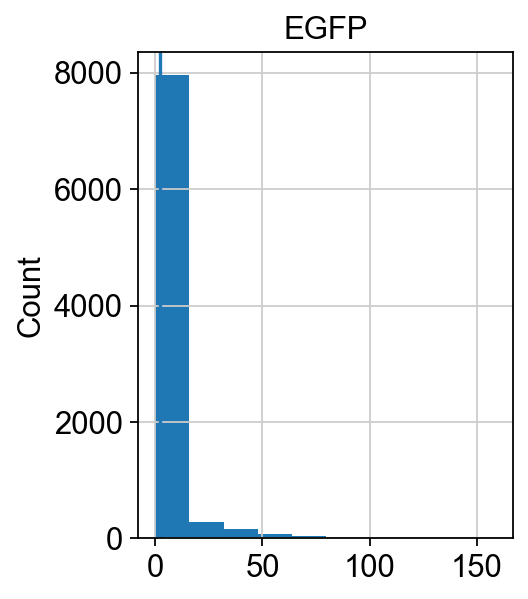

In [39]:
import matplotlib.pyplot as plt
_ = plt.hist(adata.X[:,adata.var.index.isin(['EGFP'])].toarray())
plt.ylabel("Count")
plt.title("EGFP")
plt.axvline(x=2)
plt.show()

In [40]:
adata.obs['EGFP_count'] = adata.X[:,adata.var.index.isin(['EGFP'])].toarray()

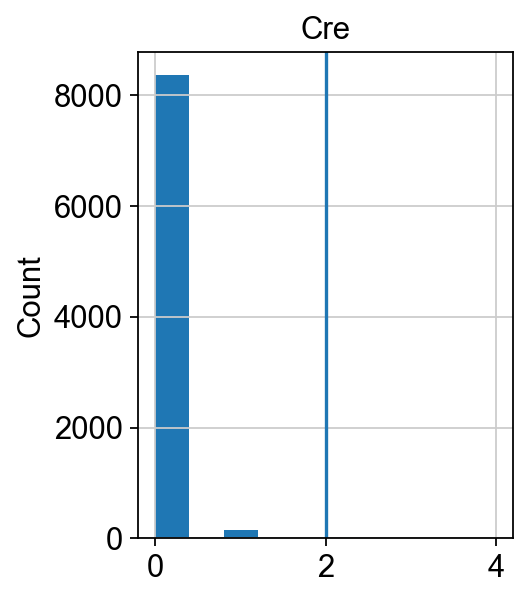

In [41]:
import matplotlib.pyplot as plt
_ = plt.hist(adata.X[:,adata.var.index.isin(['Cre'])].toarray())
plt.ylabel("Count")
plt.title("Cre")
plt.axvline(x=2)
plt.show()

In [42]:
adata.obs['Cre_count'] = adata.X[:,adata.var.index.isin(['Cre'])].toarray()

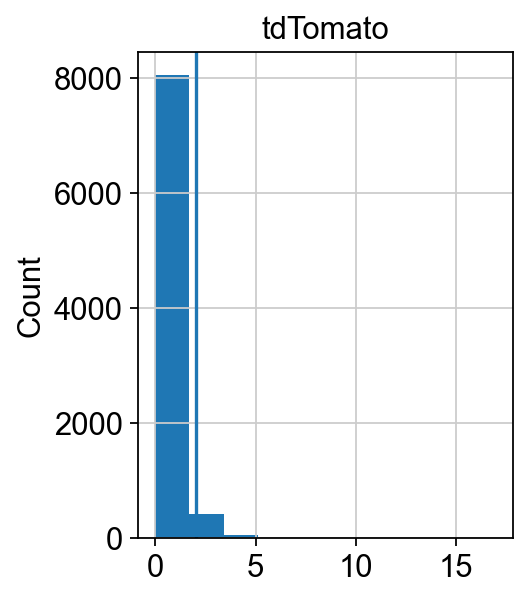

In [43]:
import matplotlib.pyplot as plt
_ = plt.hist(adata.X[:,adata.var.index.isin(['tdTomato'])].toarray())
plt.ylabel("Count")
plt.title("tdTomato")
plt.axvline(x=2)
plt.show()

In [44]:
adata.obs['tdTomato_count'] = adata.X[:,adata.var.index.isin(['tdTomato'])].toarray()

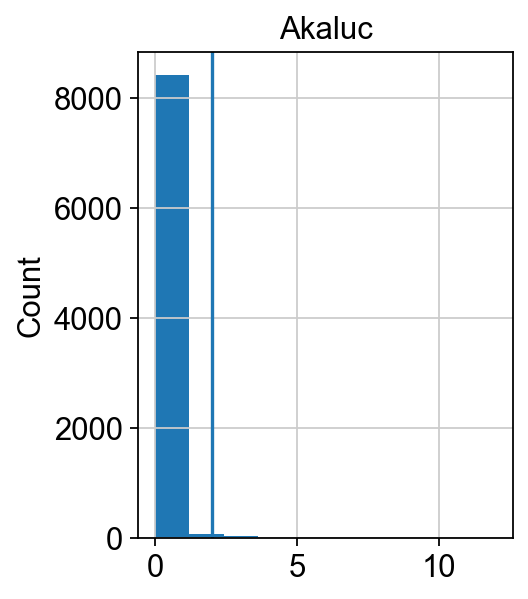

In [45]:
import matplotlib.pyplot as plt
_ = plt.hist(adata.X[:,adata.var.index.isin(['Akaluc'])].toarray())
plt.ylabel("Count")
plt.title("Akaluc")
plt.axvline(x=2)
plt.show()

In [46]:
adata.obs['Akaluc_count'] = adata.X[:,adata.var.index.isin(['Akaluc'])].toarray()

## Filter doublets and negative cells

In [47]:
adata.obs.Classification.value_counts()

Classification
BR1608_B0307    5716
BQ1920_B0308     993
negative         713
doublet          562
BP1479_B0309     531
BR1582_B0306      41
Name: count, dtype: int64

In [41]:
adata

AnnData object with n_obs × n_vars = 8556 × 23215
    obs: 'n_counts', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'log10GenesPerUMI', 'Classification', 'EGFP_count', 'Cre_count', 'tdTomato_count', 'Akaluc_count'
    var: 'gene_ids', 'feature_types', 'genome', 'pattern', 'read', 'sequence', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

In [49]:
adata.obs.Classification.value_counts()


Classification
BR1608_B0307    5716
BQ1920_B0308     993
negative         713
doublet          562
BP1479_B0309     531
BR1582_B0306      41
Name: count, dtype: int64

In [50]:
adata = adata[~adata.obs['Classification'].isin(['doublet','negative']),:]
# consider trying without BN1351_B0302 -> hashing looks strange

In [51]:
adata.obs.Classification.value_counts()

Classification
BR1608_B0307    5716
BQ1920_B0308     993
BP1479_B0309     531
BR1582_B0306      41
Name: count, dtype: int64

## Set Groups

In [46]:
samples

['BR1582_B0306', 'BR1608_B0307', 'BQ1920_B0308', 'BP1479_B0309']

In [52]:
#Set groups
adata.obs['Group'] = 'Slc4a11_12wk_14d'
adata.obs['Group'][adata.obs.Classification.isin(['BR1608_B0307'])] = 'Carrier'
adata.obs['Group'][adata.obs.Classification.isin(['BQ1920_B0308','BP1479_B0309'])] = 'Hopx_12wk_14d'

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_28757/717154860.py:2: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['Group'] = 'Slc4a11_12wk_14d'
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_28757/717154860.py:3: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documenta

In [53]:
adata.layers['counts']=adata.X.copy()

In [54]:
sc.pp.normalize_total(adata, target_sum=1e4)

normalizing counts per cell
    finished (0:00:00)


Logarithmize the data:

In [55]:
sc.pp.log1p(adata)

In [56]:
sc.pp.highly_variable_genes(adata) #batch_key=Classification

extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


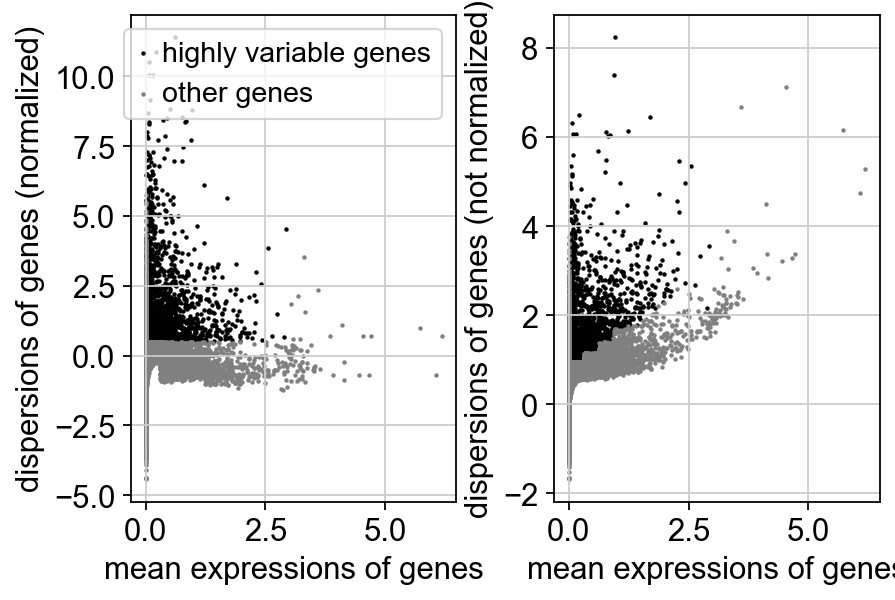

In [57]:
sc.pl.highly_variable_genes(adata)

In [58]:
#will need to update this after realignment
#Ensure marker genes aren't making an impact to highly variable gene analysis downstream
adata.var.highly_variable['EGFP'] = False
adata.var.highly_variable['mScarlet'] = False
adata.var.highly_variable['Cre'] = False
adata.var.highly_variable['ERT'] = False
adata.var.highly_variable['iDTR'] = False
adata.var.highly_variable['tagBFP'] = False
adata.var.highly_variable['mKate2'] = False
adata.var.highly_variable['Akaluc'] = False
adata.var.highly_variable['tdTomato'] = False
adata.var.highly_variable['GLuc'] = False
adata.var.highly_variable['CLuc'] = False

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_28757/2467826253.py:3: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata.var.highly_variable['EGFP'] = False
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_28757/246782

In [59]:
adata.raw = adata

In [60]:
adata.write('write/allmice-IGO17543.h5ad', compression='gzip')

In [61]:
sc.pp.scale(adata, max_value=10)

/Users/chanj2/opt/miniconda3/envs/scbackup3/lib/python3.11/functools.py:909: UserWarning: zero-centering a sparse array/matrix densifies it.
  return dispatch(args[0].__class__)(*args, **kw)


## Principal component analysis

In [62]:
sc.tl.pca(adata, svd_solver='arpack', n_comps=150)

computing PCA
    with n_comps=150
    finished (0:00:03)


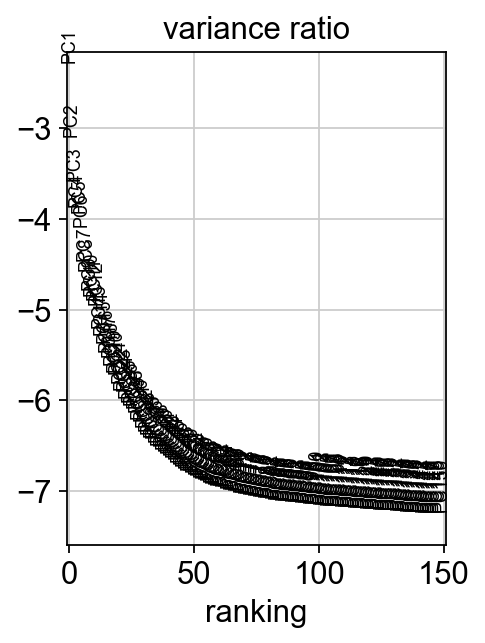

In [63]:
sc.pl.pca_variance_ratio(adata, log=True, n_pcs=150)

Save the result.

In [64]:
adata.write(results_file, compression='gzip')

## Computing the neighborhood graph

In [65]:
sc.pp.neighbors(adata, n_neighbors=15, n_pcs=50)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:04)


## Embedding the neighborhood graph

In [66]:
sc.tl.umap(adata)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:00:10)


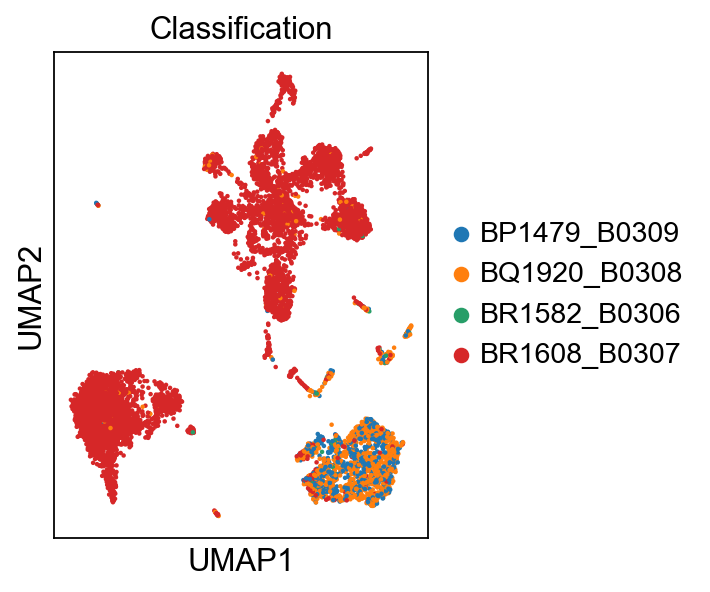

In [67]:
sc.pl.umap(adata, color=['Classification'])

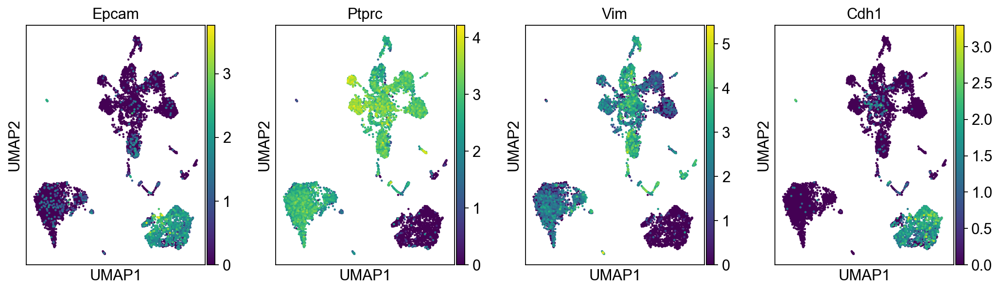

In [68]:
sc.pl.umap(adata, color=['Epcam','Ptprc','Vim', 'Cdh1',]) #'Ptprc','Cdh2'

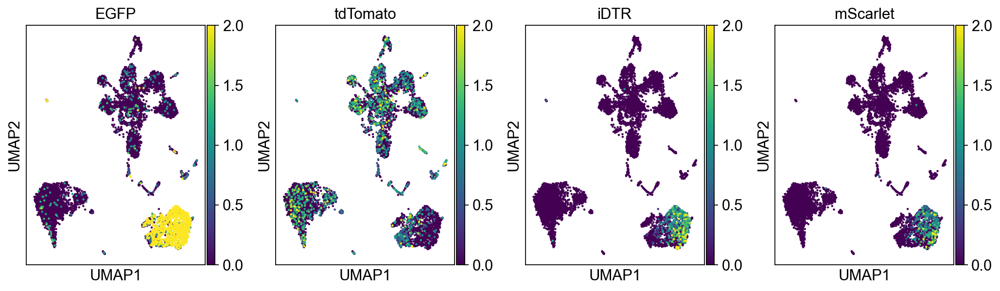

In [69]:
sc.pl.umap(adata, color=['EGFP','tdTomato','iDTR','mScarlet'], vmax=2)

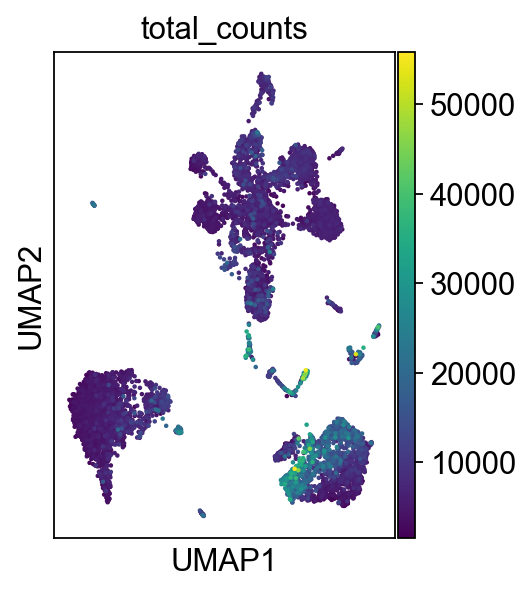

In [70]:
sc.pl.umap(adata, color=['total_counts'])

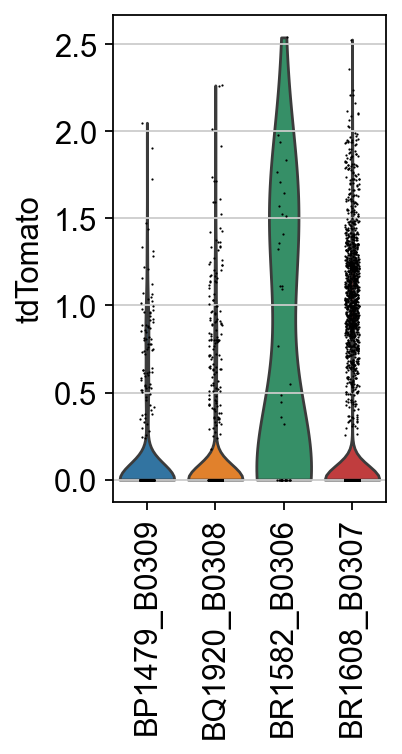

In [72]:
sc.pl.violin(adata, 'tdTomato','Classification',rotation=90)

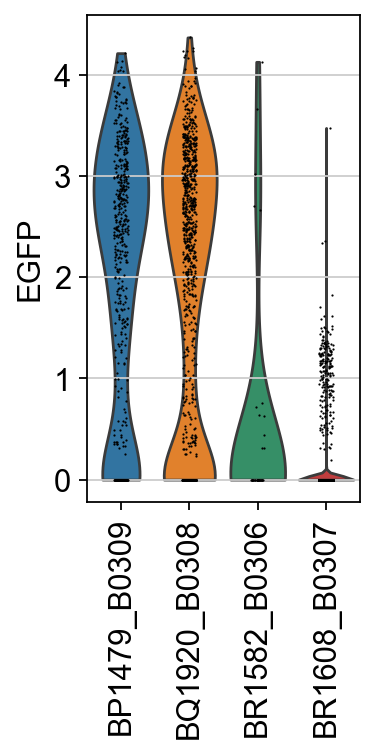

In [73]:
sc.pl.violin(adata, 'EGFP','Classification',rotation=90)

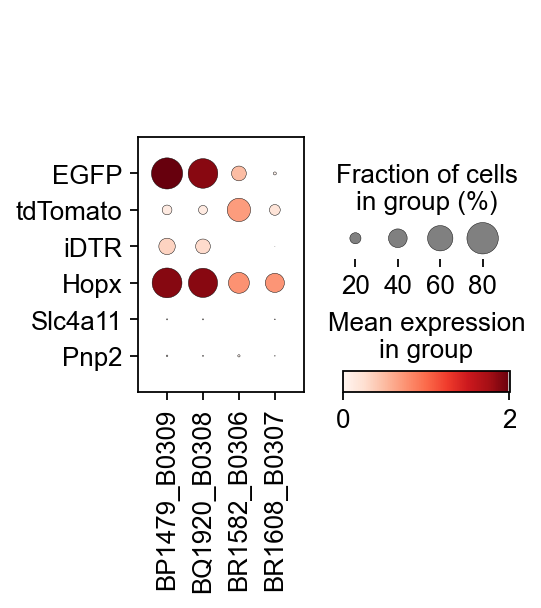

In [74]:
sc.pl.dotplot(adata, ['EGFP','tdTomato','iDTR','Hopx','Slc4a11','Pnp2'],'Classification',swap_axes=True)

In [75]:
adata.obs.Classification.value_counts()

Classification
BR1608_B0307    5716
BQ1920_B0308     993
BP1479_B0309     531
BR1582_B0306      41
Name: count, dtype: int64

## Define scoring Functions

In [78]:
# Score Cluster 5 cells
import csv
clusters = {}
clusterkeys = []
HPCS = False

def resetClusters(hpcs = 'cell2020'):
    clusters = {}
    clusterkeys = []
    HPCS = False
    try:
        if hpcs == 'cell2020':         
            with open('../../common_files/clusters_cell2020.csv',encoding='utf-8-sig') as csvfile:
                csvreader = csv.reader(csvfile, delimiter=",")
                for row in csvreader:
                    clusters[row[0]] = [x for x in row[1:] if x != '']
            for i in range(1,13):
                #if i == 9: continue
                clusterkeys.append('Cluster %i' % i)
            HPCS = 'Cluster 5'
        else:
            raise ValueError
    except ValueError:
        print("%s is an invalid choice" % hpcs)
        raise
    return (clusters, clusterkeys, HPCS)

(clusters, clusterkeys, HPCS) = resetClusters('cell2020')

In [79]:
def scoreAndPlot(ad, excludeList = None, groupby="Classification",rotation=90,numgenes=500,ctlgenes=25):
    #cmap = 'Reds' #colormap
    cmap = 'jet' #colormap
    if excludeList == None:
        for i in clusterkeys:
            if (numgenes > ctlgenes):
                ctlgenes = numgenes
            sc.tl.score_genes(ad, clusters[i][0:numgenes],score_name="%s" % i, ctrl_size=ctlgenes)  
  
        sc.pl.umap(ad, color=clusterkeys, color_map=cmap)
        sc.pl.dotplot(ad, clusterkeys, groupby=groupby, swap_axes=True)

In [80]:
from scipy.stats import ranksums

def HPCSViolinPlot(ad, cluster='0', groupby='leiden', score='Cluster5', save=None, singleGene=False):
    ad.obs['Cl5'] = 'not HPCS'
    ad.obs.loc[ad.obs[groupby].isin([cluster]), 'Cl5'] = 'HPCS'

    if singleGene:
        pvalue = ranksums(ad[ad.obs['Cl5'].isin(['HPCS'])][:,score].X.toarray(),ad[~ad.obs['Cl5'].isin(['HPCS'])][:,score].X.toarray())[1]
    else:
        pvalue = ranksums(ad[ad.obs['Cl5'].isin(['HPCS'])].obs[score],ad[ad.obs['Cl5'].isin(['not HPCS'])].obs[score])[1]
    sc.pl.violin(ad, score, groupby='Cl5', xlabel = 'p = ' + str(pvalue), save=save)

computing score 'Cluster 1'
    finished: added
    'Cluster 1', score of gene set (adata.obs).
    1891 total control genes are used. (0:00:00)
computing score 'Cluster 2'
    finished: added
    'Cluster 2', score of gene set (adata.obs).
    1599 total control genes are used. (0:00:00)
computing score 'Cluster 3'
    finished: added
    'Cluster 3', score of gene set (adata.obs).
    1392 total control genes are used. (0:00:00)
computing score 'Cluster 4'
    finished: added
    'Cluster 4', score of gene set (adata.obs).
    2095 total control genes are used. (0:00:00)
computing score 'Cluster 5'
    finished: added
    'Cluster 5', score of gene set (adata.obs).
    2187 total control genes are used. (0:00:00)
computing score 'Cluster 6'
       'Rps2-ps6', 'Fam46c', 'Gm6139', 'Gm10179', 'Ldha-ps2', 'Gm5864'],
      dtype='object')
    finished: added
    'Cluster 6', score of gene set (adata.obs).
    2189 total control genes are used. (0:00:00)
computing score 'Cluster 7'
    fin

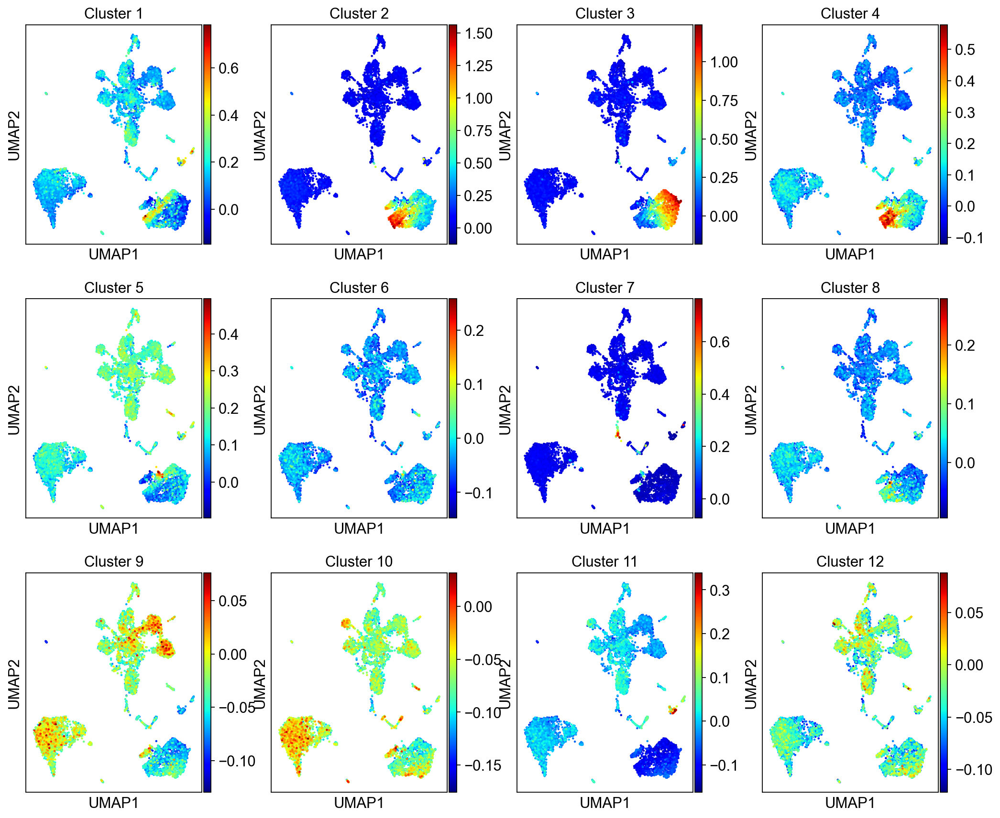

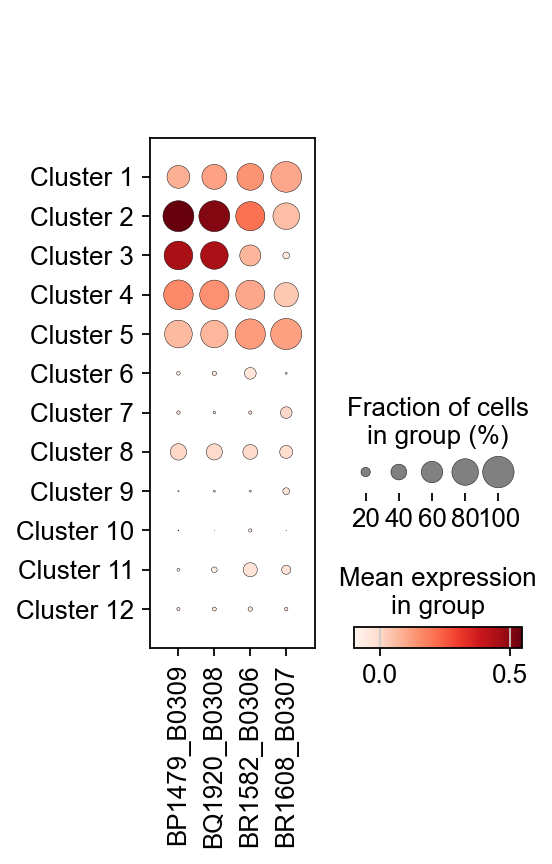

In [81]:
scoreAndPlot(adata, numgenes=100)

## Clustering the neighborhood graph

In [82]:
sc.tl.leiden(adata, resolution=0.15)

running Leiden clustering


/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_28757/2358901094.py:1: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata, resolution=0.15)


    finished: found 12 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


Plot the clusters

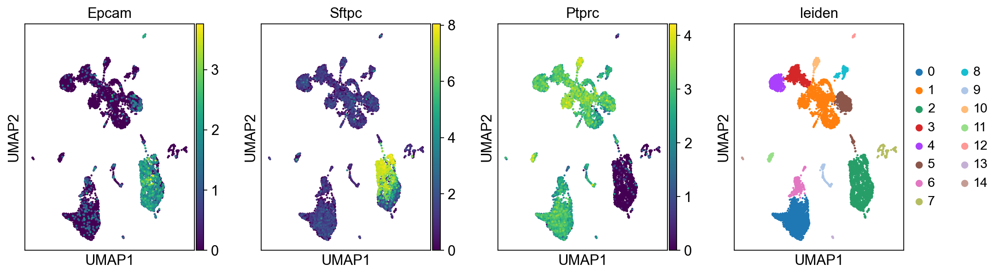

(None,)

In [75]:
sc.pl.umap(adata, color=['Epcam', 'Sftpc', # Tumor cells
                         'Ptprc','leiden']), #immune
                         #  'Cd4', 'Cd8a', #T cell #'Cd3e',
                         # 'Cd19', 'Ms4a1', 'Cd22', # B cell
                         # #'Itgax', 'Il3ra', # Dendritic Cell
                         # 'Ncam1',# 'Ncr1', # NK Cell
                         # 'Cd34', # Hematopoetic stem cell
                         # #'Cd14', 'Cd33', # macrophage
                         # #'Ceacam8' # Granulocyte
                         # 'Itga2b', 'Itgb3', 'Selp', #platelet
                         # #'Gypa',  # erythrocyte
                         # #'Mcam', 'Vcam1', 'Pecam1', 'Sele', # endothelial cell
                         # 'Cd109', 'Wnt5a', 'Kras'])

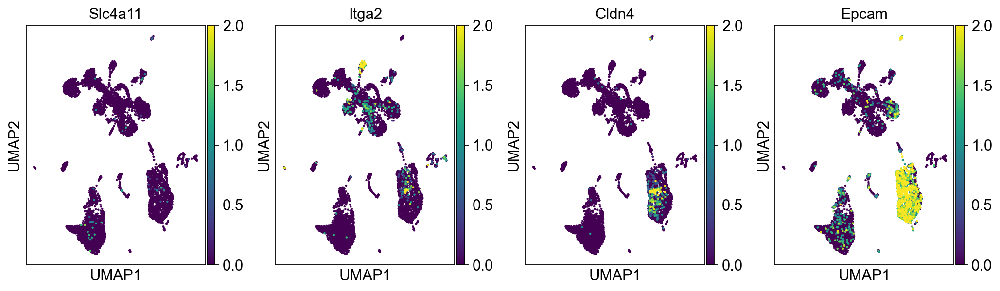

In [76]:
sc.pl.umap(adata, color=['Slc4a11', 'Itga2', 'Cldn4','Epcam'], vmax=2) #'Tigit', 

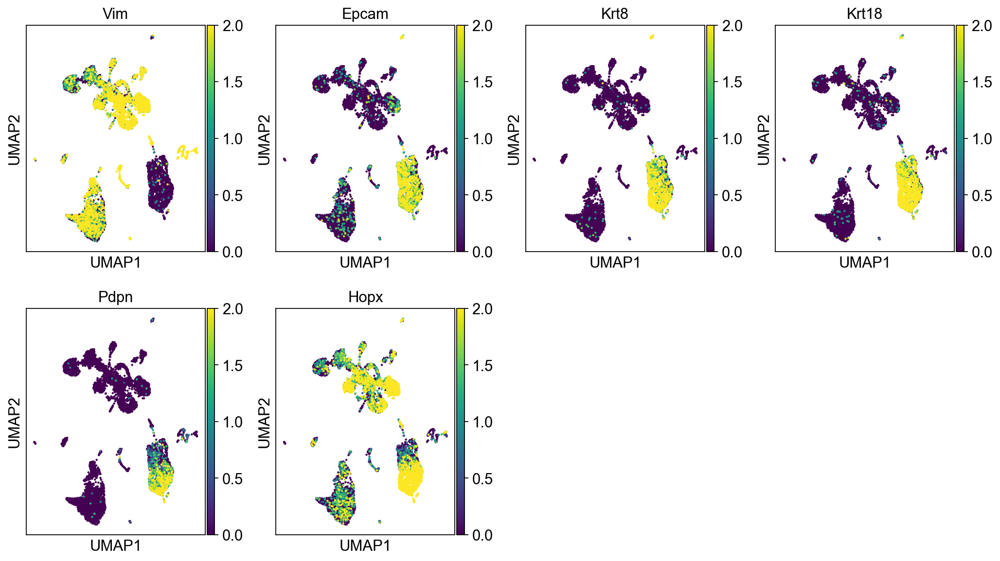

In [77]:
sc.pl.umap(adata, color=['Vim', 'Epcam', 'Krt8', 'Krt18', 'Pdpn', 'Hopx'], vmax=2) #'Pecam1',

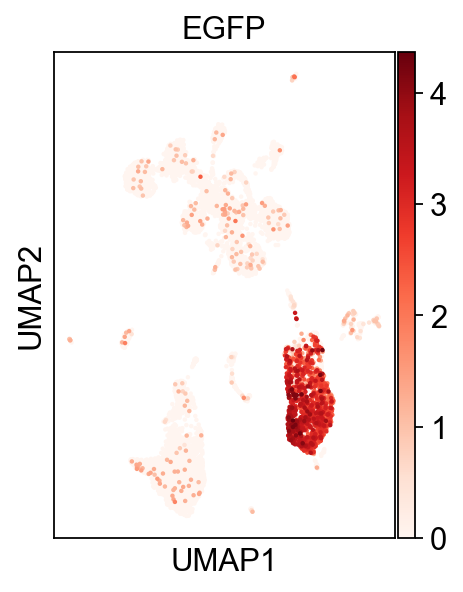

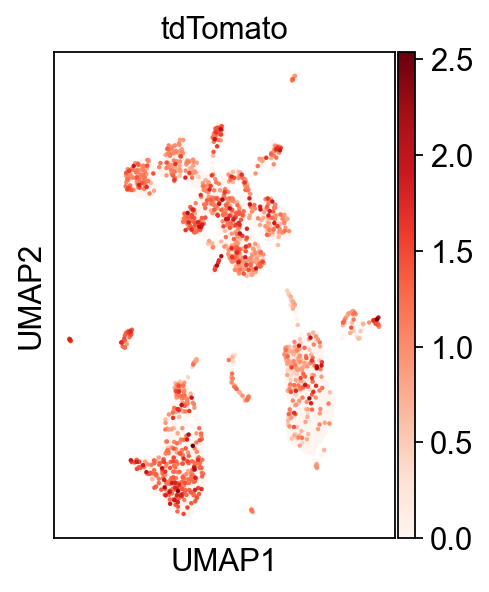

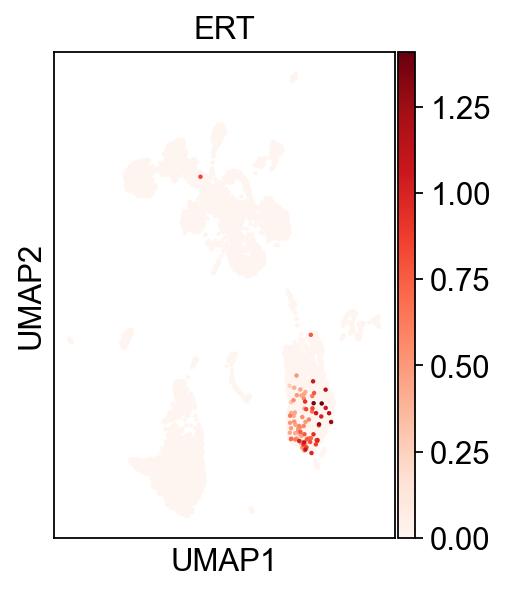

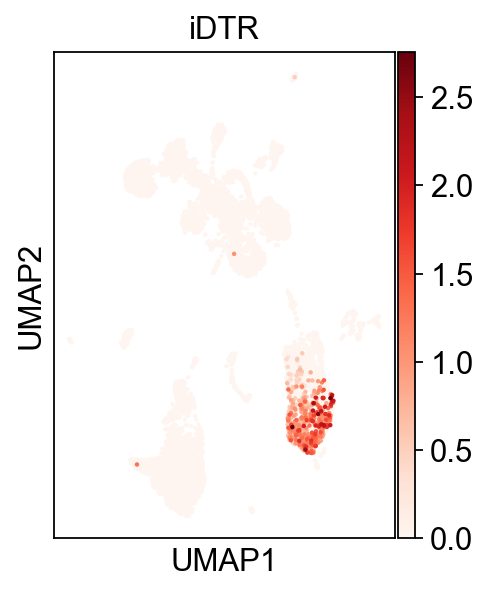

In [78]:
sc.pl.umap(adata, color=['EGFP'], cmap='Reds')
sc.pl.umap(adata, color=['tdTomato'], cmap='Reds')
sc.pl.umap(adata, color=['ERT'], cmap='Reds')
sc.pl.umap(adata, color=['iDTR'], cmap='Reds')

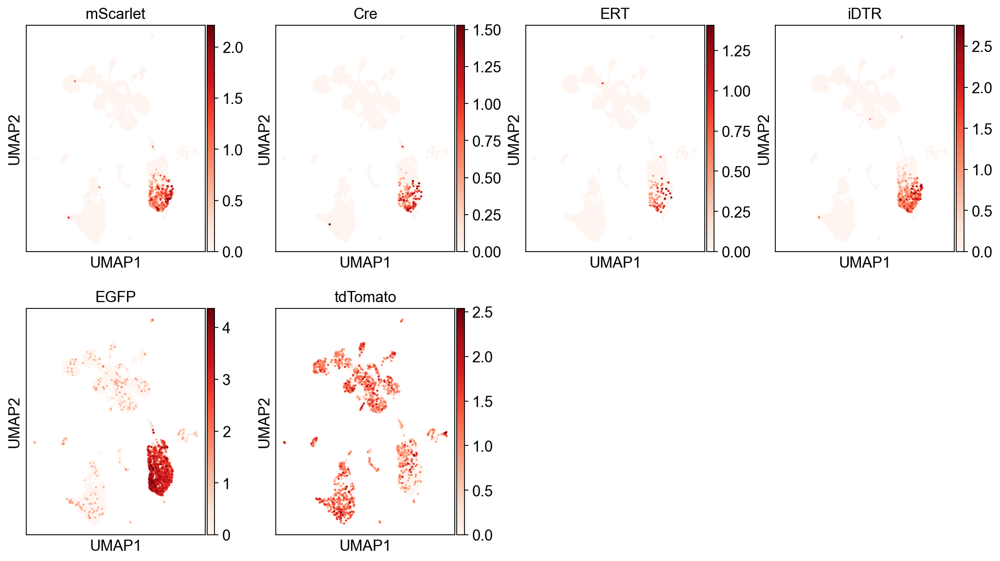

In [79]:
sc.pl.umap(adata, color=["mScarlet", "Cre", "ERT",'iDTR','EGFP','tdTomato'], cmap='Reds') #'mKate2'

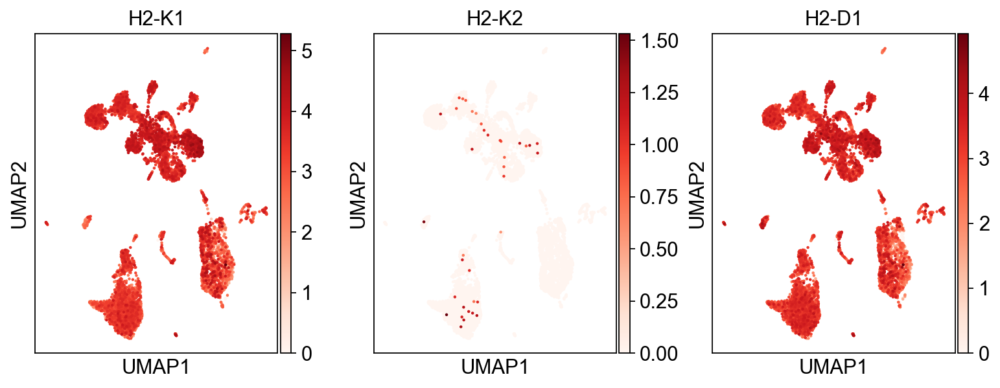

In [80]:
sc.pl.umap(adata, color=["H2-K1", "H2-K2", "H2-D1"], cmap='Reds') #'mKate2'

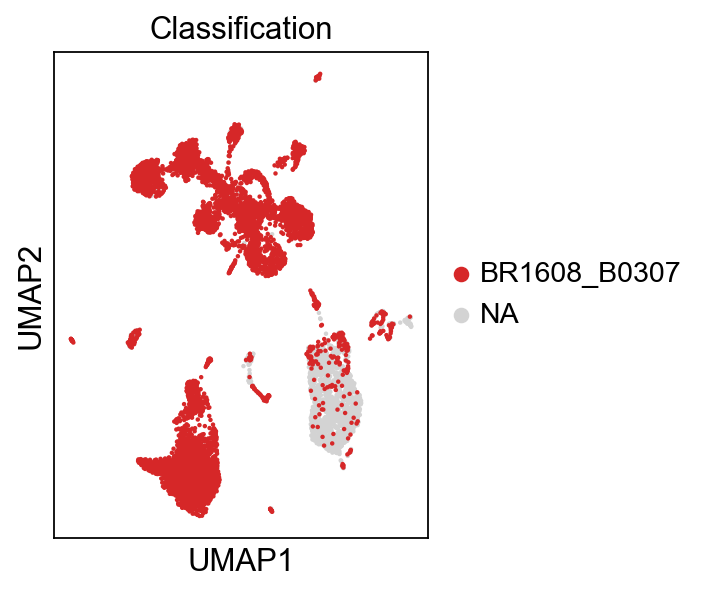

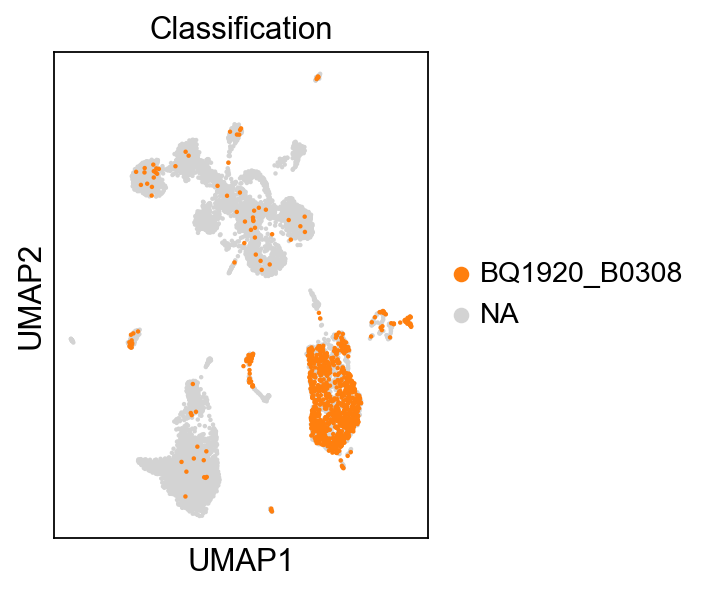

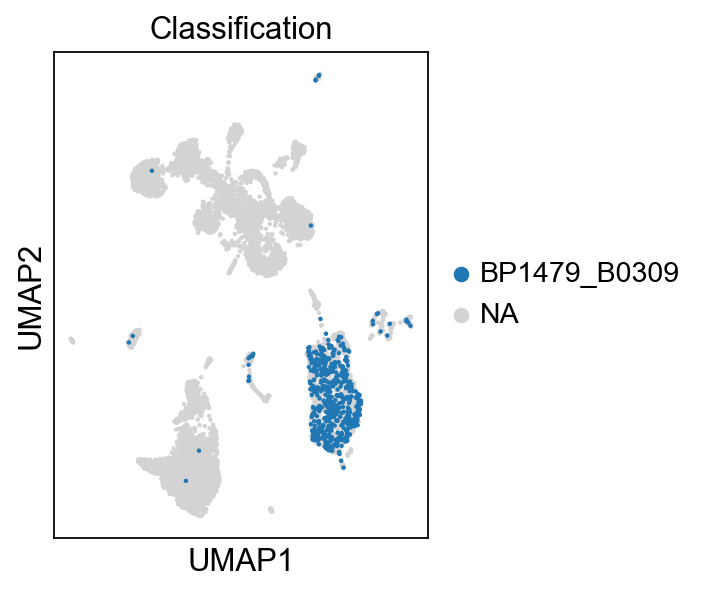

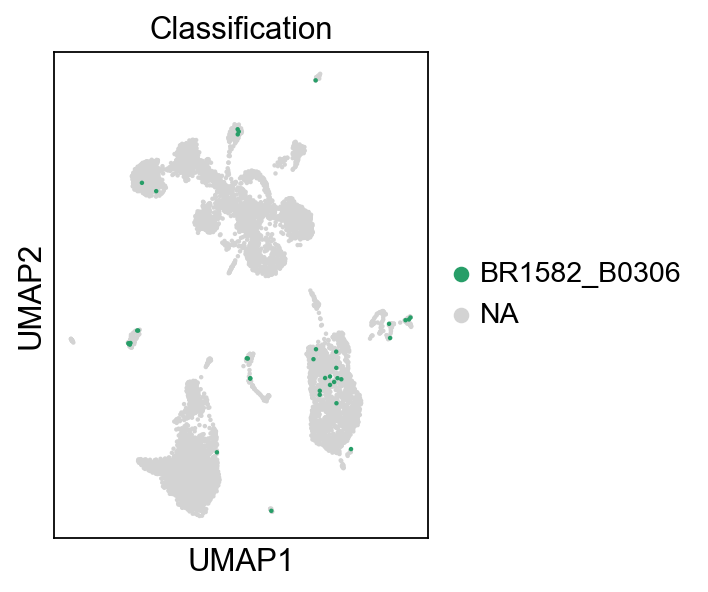

In [81]:
for label in adata.obs['Classification'].unique():
    sc.pl.umap(adata, color='Classification',groups=[label])

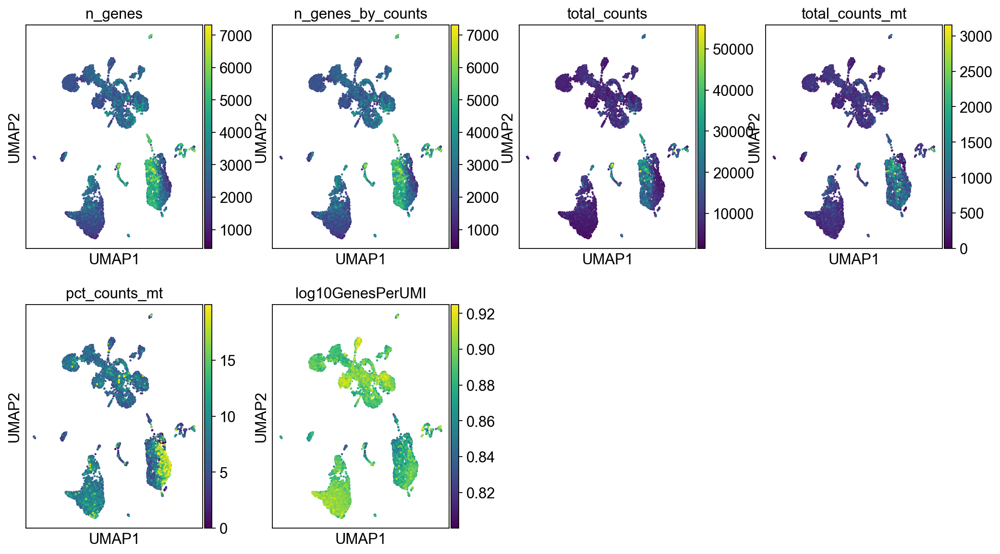

In [82]:
sc.pl.umap(adata,color=['n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt',
       'pct_counts_mt', 'log10GenesPerUMI'])

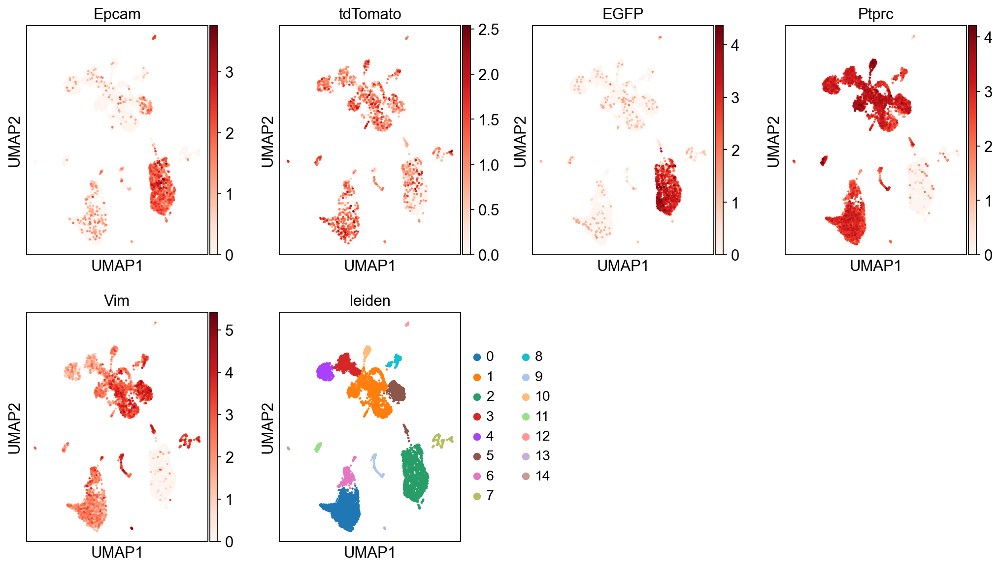

In [83]:
sc.pl.umap(adata, color=['Epcam','tdTomato','EGFP','Ptprc','Vim','leiden',],cmap="Reds")

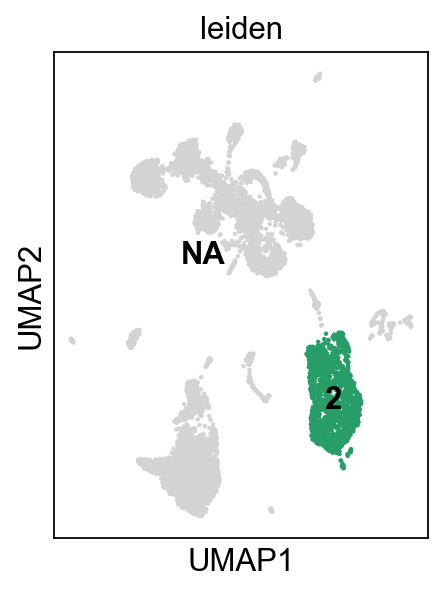

In [84]:
sc.pl.umap(adata, color=['leiden'], groups=['2'],legend_loc='on data')

## Select Tumor Cells

In [85]:
# Select only those subset of cells that are useful
adata2 = sc.read('write/allmice-IGO17543.h5ad')
adata = adata2[adata.obs['leiden'].isin(['2']),:] # keep tumor cells
adata = adata[~adata.obs.Classification.isin(['BR1608_B0307']),:]
del adata2

In [86]:
#fix a bug; 'base' is None but that doesn't seem to have transferred
adata.uns['log1p'] = {}
adata.uns['log1p']['base'] = None

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_9696/2000007.py:2: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns['log1p'] = {}


In [87]:
sc.pp.highly_variable_genes(adata)#, batch_key='Classification')

extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


In [88]:
#Ensure marker genes aren't making an impact to highly variable gene analysis downstream
adata.var.highly_variable['EGFP'] = False
adata.var.highly_variable['mScarlet'] = False
adata.var.highly_variable['Cre'] = False
adata.var.highly_variable['ERT'] = False
adata.var.highly_variable['iDTR'] = False
adata.var.highly_variable['tagBFP'] = False
adata.var.highly_variable['mKate2'] = False
adata.var.highly_variable['Akaluc'] = False
adata.var.highly_variable['tdTomato'] = False
adata.var.highly_variable['GLuc'] = False
adata.var.highly_variable['CLuc'] = False

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_9696/114365792.py:2: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata.var.highly_variable['EGFP'] = False
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_9696/114365792

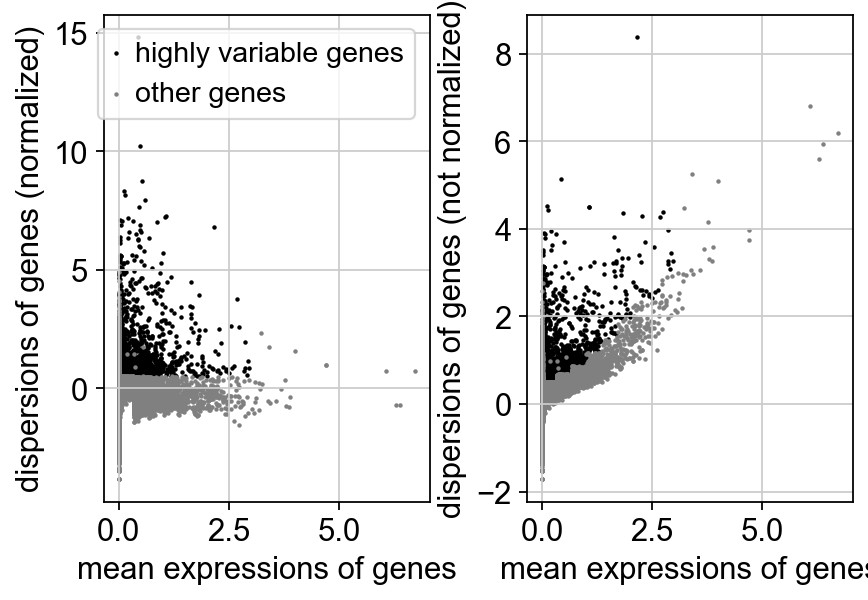

In [89]:
sc.pl.highly_variable_genes(adata)

In [90]:
adata.raw = adata

In [91]:
adata.write('write/allmice-tumor-IGO17543.h5ad', compression='gzip')
#adata = sc.read('write/allmice-tumor.h5ad')

## Now rerun algorithm

In [92]:
adata.obs.Classification.value_counts()

Classification
BQ1920_B0308    784
BP1479_B0309    480
BR1582_B0306     14
Name: count, dtype: int64

In [93]:
sc.pp.scale(adata, max_value=10)

/Users/chanj2/opt/miniconda3/envs/scbackup3/lib/python3.11/functools.py:909: UserWarning: zero-centering a sparse array/matrix densifies it.
  return dispatch(args[0].__class__)(*args, **kw)


## Principal component analysis

In [94]:
sc.tl.pca(adata, svd_solver='arpack', n_comps=200)

computing PCA
    with n_comps=200
    finished (0:00:01)


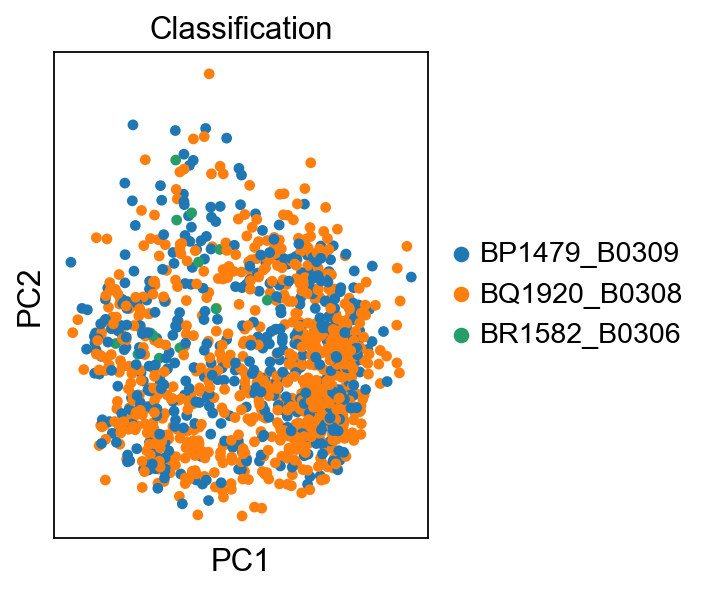

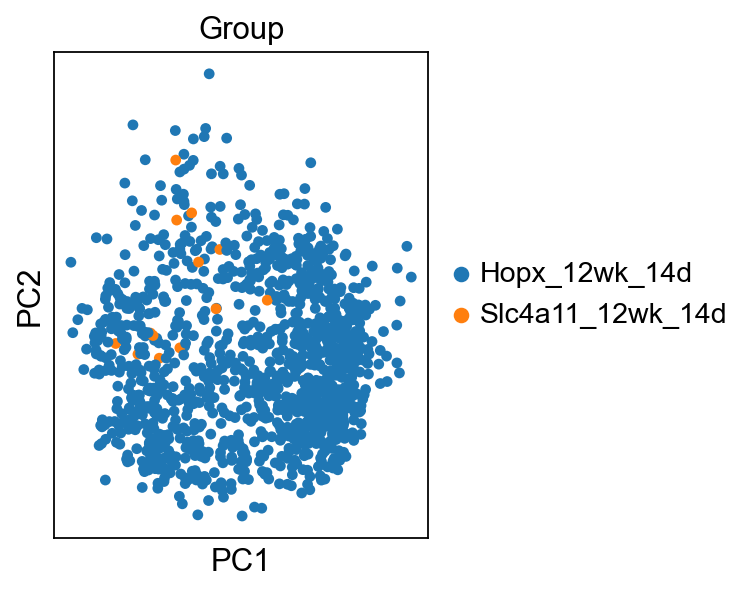

In [95]:
#sc.pl.pca(adata, color='leiden',dimensions=[(0,1)])
sc.pl.pca(adata, color='Classification',dimensions=[(0,1)])
sc.pl.pca(adata, color='Group',dimensions=[(0,1)])

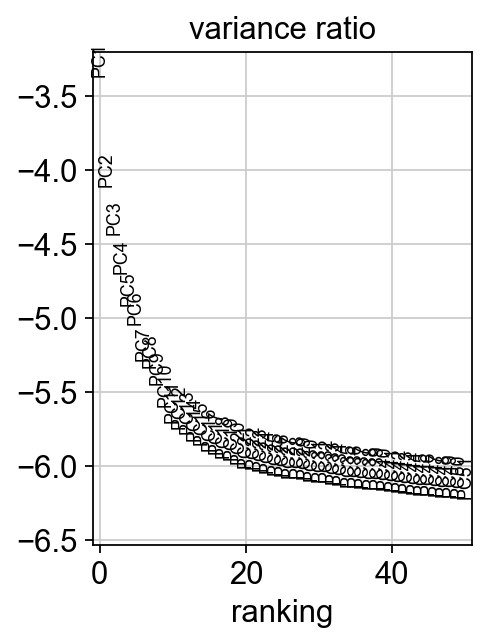

In [96]:
sc.pl.pca_variance_ratio(adata, log=True, n_pcs=50)

Save the result.

In [97]:
adata.write(results_file, compression='gzip')

In [98]:
adata.obs.Classification.value_counts()

Classification
BQ1920_B0308    784
BP1479_B0309    480
BR1582_B0306     14
Name: count, dtype: int64

## Computing the neighborhood graph

In [99]:
sc.pp.neighbors(adata, n_neighbors=15, n_pcs=15)

computing neighbors
    using 'X_pca' with n_pcs = 15
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)


## Embedding the neighborhood graph

In [100]:
sc.tl.umap(adata)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:00:01)


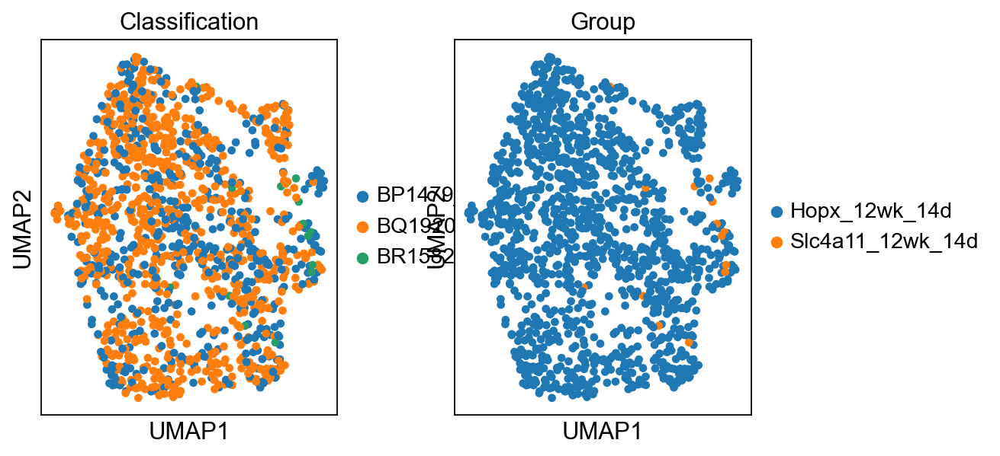

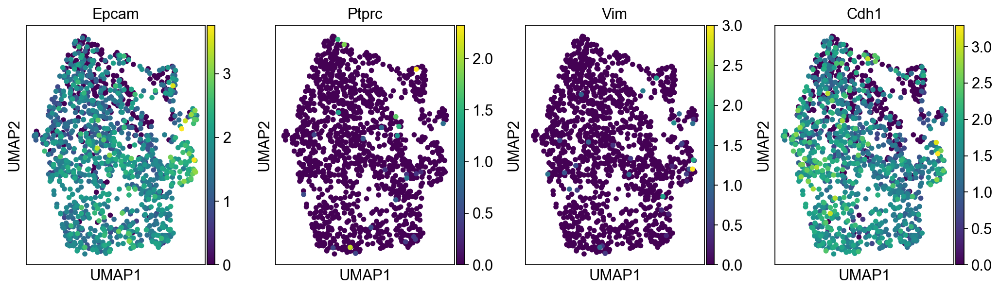

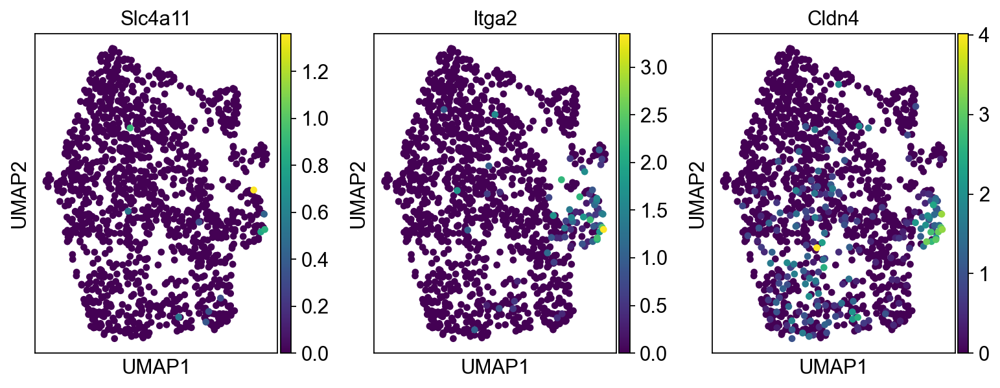

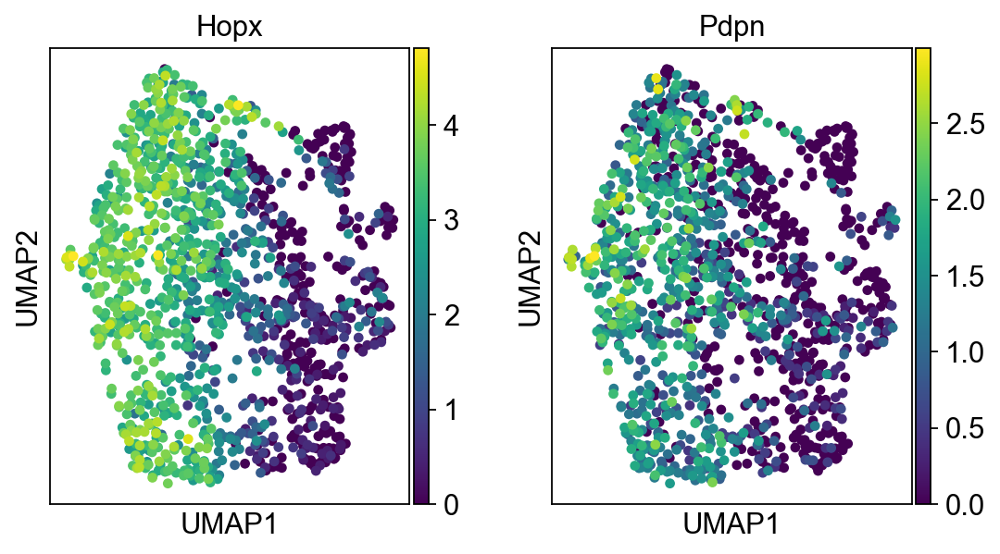

In [101]:
sc.pl.umap(adata, color=['Classification', 'Group'])
#sc.pl.umap(adata, color=['Porcn', 'Lgr5', 'Lgr6','Axin2']) #LGR5 not found #
sc.pl.umap(adata, color=['Epcam', 'Ptprc', 'Vim', 'Cdh1',]) #CDH2 not found #'Cdh2'
sc.pl.umap(adata, color=['Slc4a11', 'Itga2', 'Cldn4']) #, 'Abcb1'
sc.pl.umap(adata, color=['Hopx', 'Pdpn'])
#sc.pl.umap(adata, color=['Cd81', 'Cd19'])
#sc.pl.umap(adata, color=['Trp53','Meg3'], vmax=5)

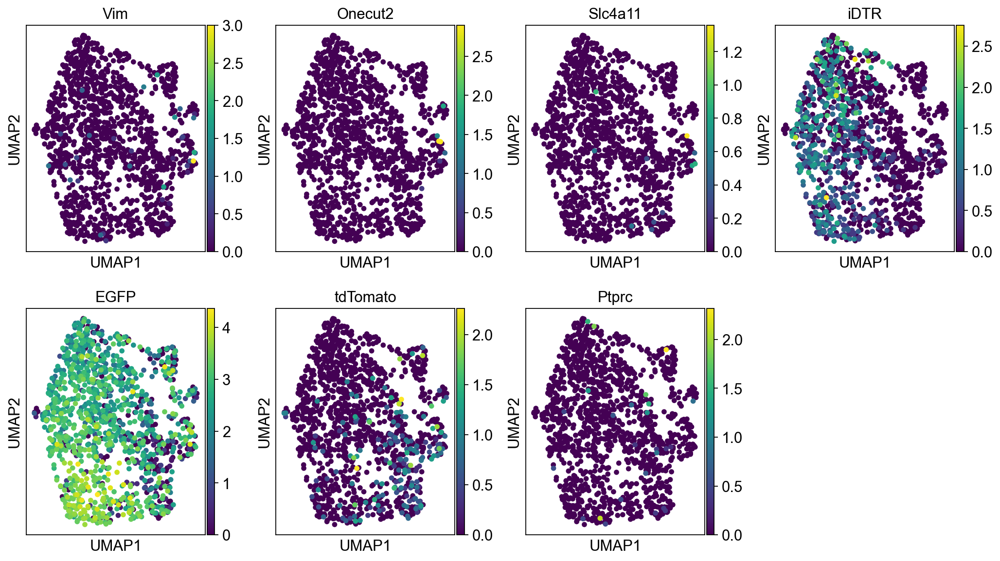

In [102]:
sc.pl.umap(adata, color=['Vim', 'Onecut2', 'Slc4a11', 'iDTR', 'EGFP','tdTomato','Ptprc']) #'Sox11', 

computing score 'Cluster 1'
    finished: added
    'Cluster 1', score of gene set (adata.obs).
    1692 total control genes are used. (0:00:00)
computing score 'Cluster 2'
    finished: added
    'Cluster 2', score of gene set (adata.obs).
    1294 total control genes are used. (0:00:00)
computing score 'Cluster 3'
    finished: added
    'Cluster 3', score of gene set (adata.obs).
    991 total control genes are used. (0:00:00)
computing score 'Cluster 4'
    finished: added
    'Cluster 4', score of gene set (adata.obs).
    1698 total control genes are used. (0:00:00)
computing score 'Cluster 5'
    finished: added
    'Cluster 5', score of gene set (adata.obs).
    2093 total control genes are used. (0:00:00)
computing score 'Cluster 6'
       'Rps2-ps6', 'Fam46c', 'Gm6139', 'Gm10179', 'Ldha-ps2', 'Gm5864'],
      dtype='object')
    finished: added
    'Cluster 6', score of gene set (adata.obs).
    1789 total control genes are used. (0:00:00)
computing score 'Cluster 7'
    fini

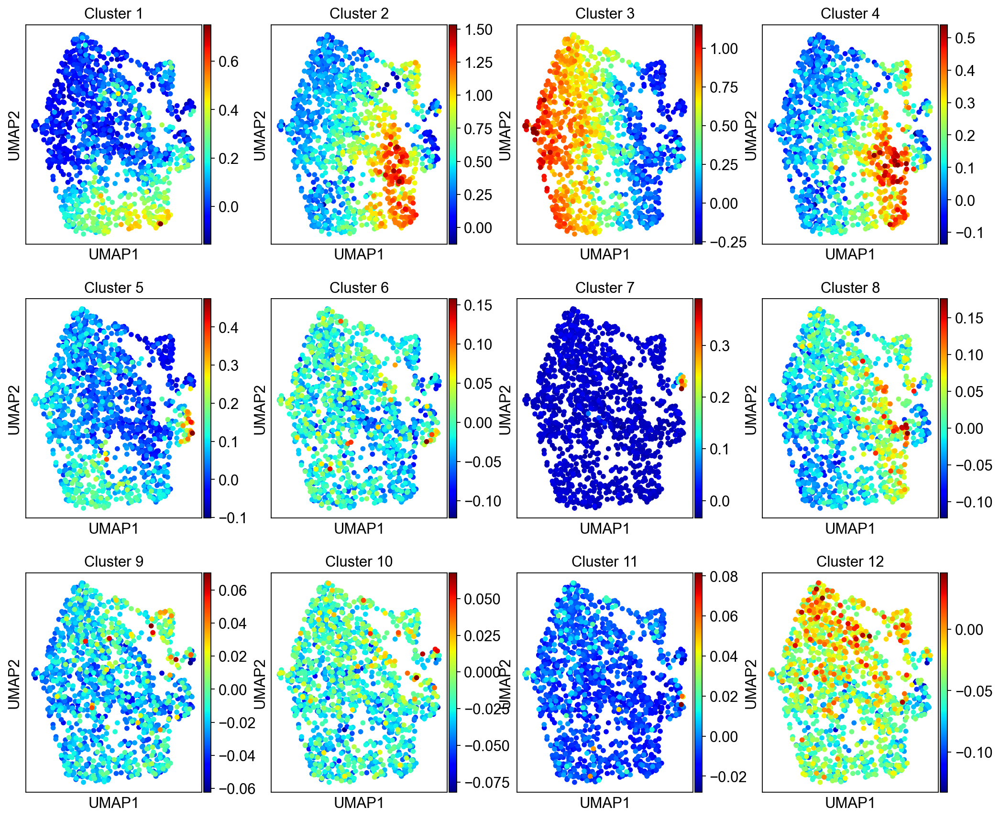

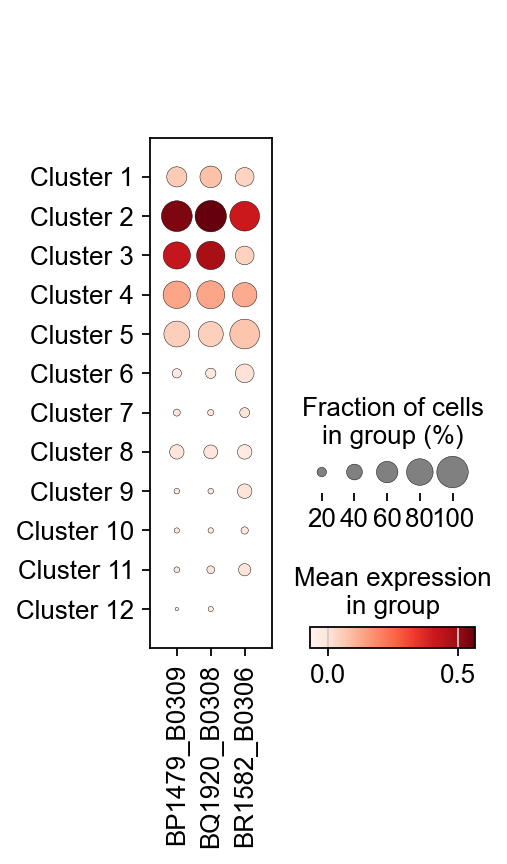

In [103]:
(clusters, clusterkeys, HPCS) = resetClusters('cell2020')
scoreAndPlot(adata, numgenes=100)

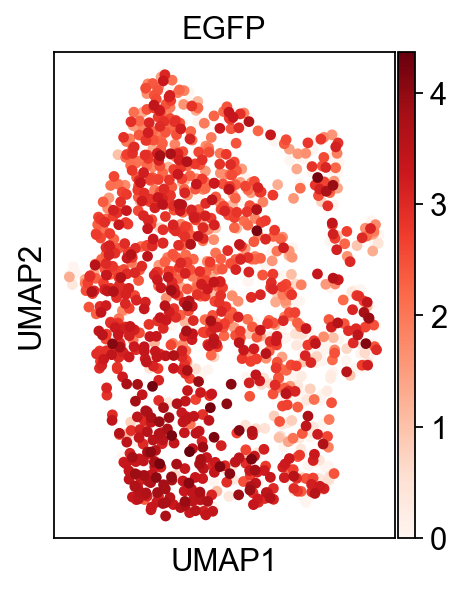

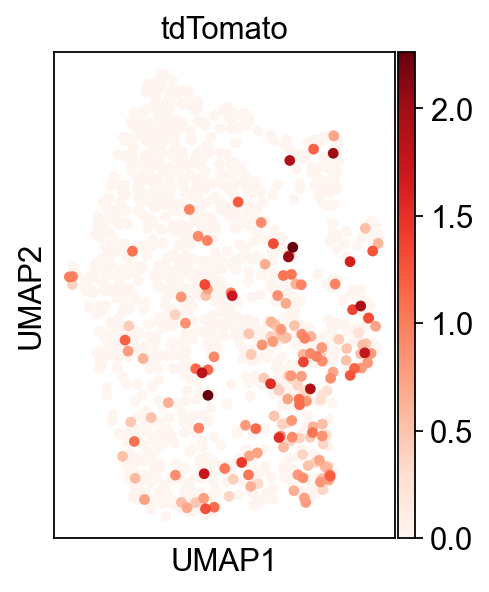

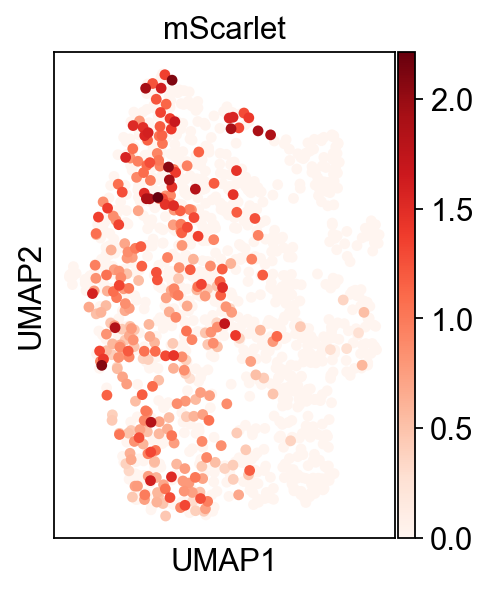

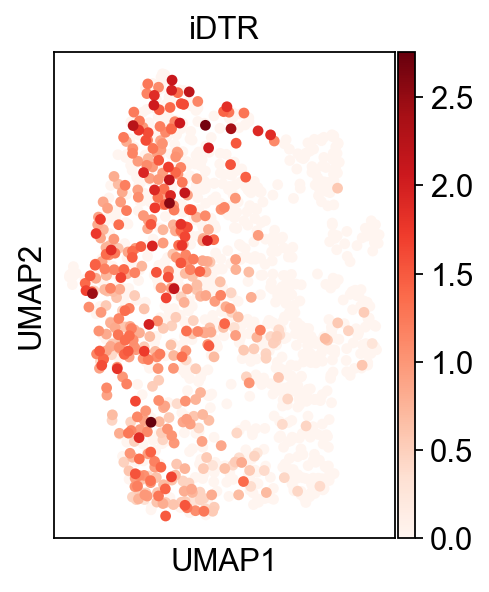

In [104]:
sc.pl.umap(adata, color=['EGFP'], cmap='Reds')
sc.pl.umap(adata, color=['tdTomato'], cmap='Reds')
sc.pl.umap(adata, color=['mScarlet'], cmap='Reds')
sc.pl.umap(adata, color=['iDTR'], cmap='Reds')

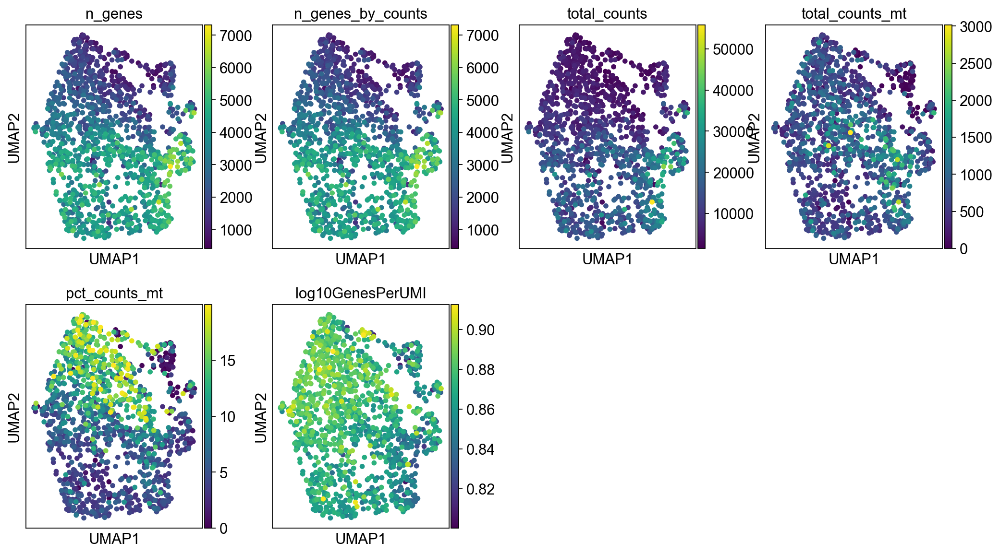

In [105]:
sc.pl.umap(adata, color=['n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt',
       'pct_counts_mt', 'log10GenesPerUMI'])

In [106]:
adata.obs.Classification.value_counts(sort=False)

Classification
BP1479_B0309    480
BQ1920_B0308    784
BR1582_B0306     14
Name: count, dtype: int64

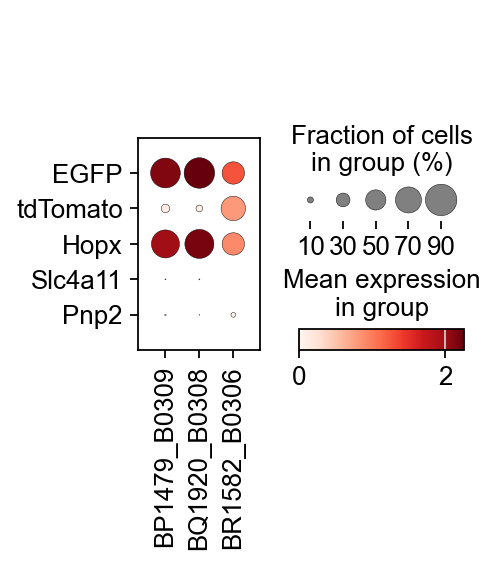

In [107]:
sc.pl.dotplot(adata, ['EGFP','tdTomato','Hopx','Slc4a11','Pnp2'],'Classification',swap_axes=True)

In [108]:
sc.tl.embedding_density(adata, basis='umap', groupby='Classification')

computing density on 'umap'
--> added
    'umap_density_Classification', densities (adata.obs)
    'umap_density_Classification_params', parameter (adata.uns)


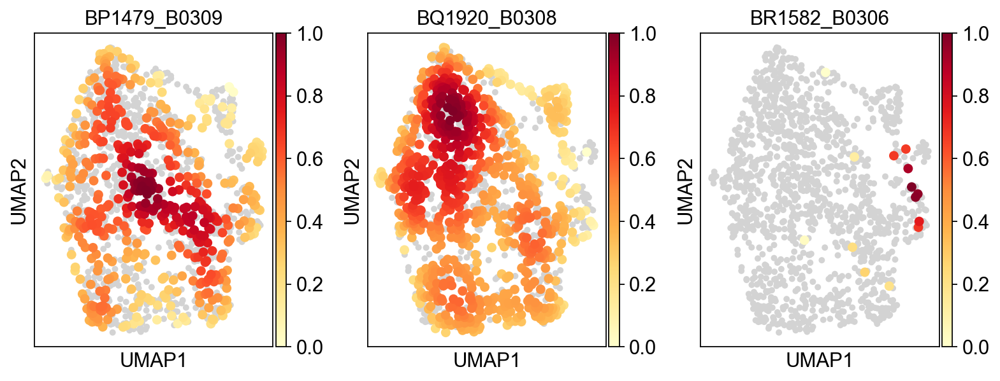

In [109]:
sc.pl.embedding_density(adata, basis='umap', key='umap_density_Classification')

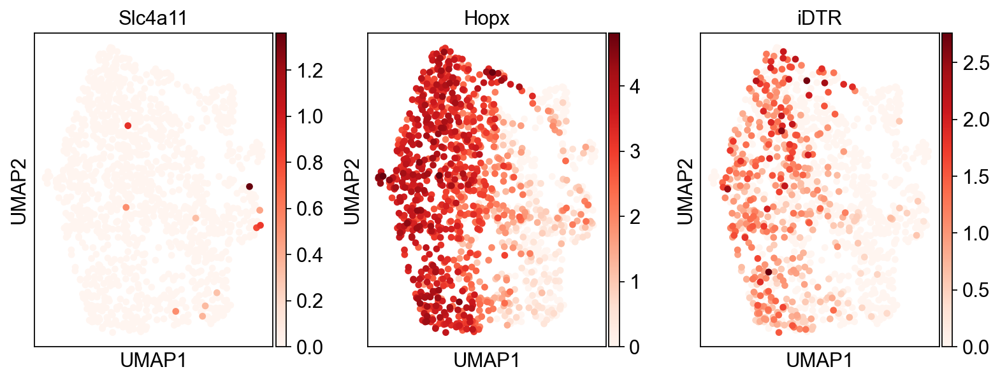

In [110]:
sc.pl.umap(adata, color=['Slc4a11','Hopx','iDTR'],cmap='Reds')

## Clustering the neighborhood graph

running Leiden clustering
    finished: found 5 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


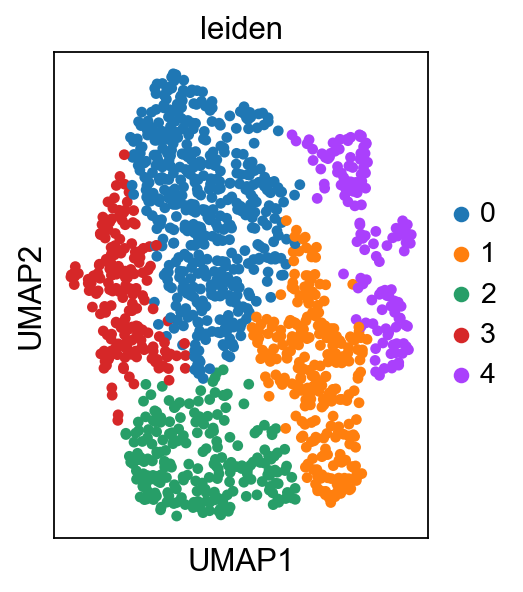

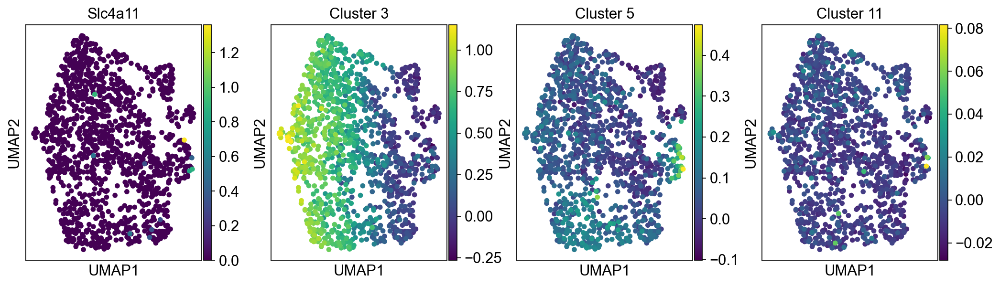

In [111]:
sc.tl.leiden(adata, resolution=.3)
sc.pl.umap(adata, color=['leiden'])
sc.pl.umap(adata, color=['Slc4a11','Cluster 3','Cluster 5','Cluster 11'])

In [112]:
adata.obs[['Classification']].value_counts(sort=False)

Classification
BP1479_B0309      480
BQ1920_B0308      784
BR1582_B0306       14
Name: count, dtype: int64

## Logistic Regression

In [113]:
from sklearn.linear_model import LogisticRegression
from joblib import dump, load
names = load('./genes.joblib')

In [114]:
adata_log = adata[:,adata.var.index.isin(names)]

In [115]:
adata_names = [x for x in adata_log.var.index]

In [116]:
goi = [x for x in adata_log.var.index]

## Load SmartSeq h5ad file

In [117]:
smartseq = anndata.read('./smartseq.h5ad')

/Users/chanj2/opt/miniconda3/envs/scbackup3/lib/python3.11/site-packages/anndata/__init__.py:42: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


## Logistic Regression against Cancer Cell 2020 Clusters intersected with 10x data

In [118]:
from sklearn.model_selection import train_test_split

names_adata = smartseq[:,smartseq.var.index.isin(goi)]

X_train, X_test, y_train, y_test = train_test_split(names_adata.X, smartseq.obs['clusterK12'], test_size=0.25, random_state=250)

In [119]:
names = [x for x in names_adata.var.index]

In [120]:
# import the class
from sklearn.linear_model import LogisticRegression

# instantiate the model (using the default parameters)
#logreg = LogisticRegression(random_state=250)
#logreg = LogisticRegression(random_state=250,multi_class='multinomial',solver='saga')
logreg = LogisticRegression(random_state=250,multi_class='multinomial', solver='lbfgs')

# fit the model with data
logreg.fit(X_train, y_train)

y_pred = logreg.predict(X_test)
y_score = logreg.predict_proba(X_test)


/Users/chanj2/opt/miniconda3/envs/scbackup3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:1264: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.
  warnings.warn(


In [121]:
# import the metrics class
from sklearn import metrics

cnf_matrix = metrics.confusion_matrix(y_test, y_pred)
cnf_matrix

array([[134,   8,   4,   0,   2,   1,   2,   0,   1,   0,   0,   0],
       [  6,  69,   0,   3,   0,   0,   0,   0,   0,   2,   0,   0],
       [  0,   0,  41,   0,   3,   0,   0,   2,   0,   1,   0,   0],
       [  1,   2,   0,  61,   0,   0,   0,  10,   2,   1,   0,   0],
       [  0,   0,   4,   0, 177,   2,   0,   3,   1,   1,   0,   1],
       [  0,   0,   0,   0,   0,  34,   0,   0,   0,   0,   0,   0],
       [  0,   0,   0,   0,   0,   0,  13,   0,   2,   0,   0,   0],
       [  0,   0,   0,   1,   1,   0,   0, 134,   4,   3,   0,   1],
       [  0,   0,   0,   0,   1,   0,   0,   2,  38,   1,   0,   0],
       [  0,   0,   1,   1,   0,   0,   0,   4,   0,  56,   0,   1],
       [  0,   0,   0,   0,   0,   0,   0,   0,   1,   0,  13,   0],
       [  0,   0,   0,   0,   1,   0,   0,   0,   1,   1,   0,  40]])

Text(0.5, 295.64444444444445, 'Predicted label')

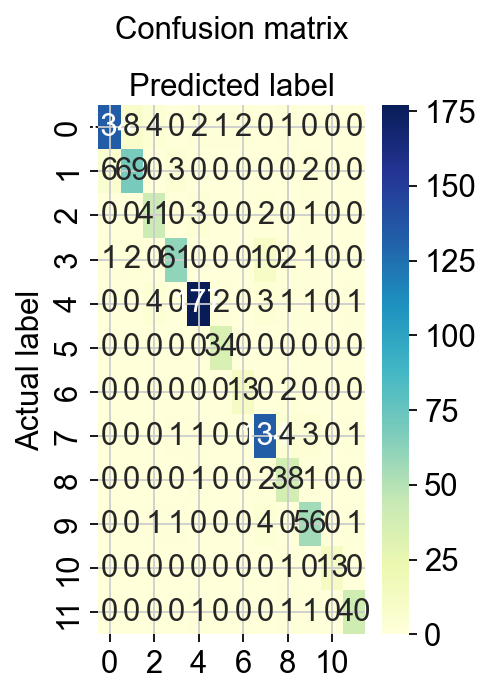

In [122]:
# import required modules
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

class_names=[0,1] # name  of classes
fig, ax = plt.subplots()
tick_marks = np.arange(len(class_names))
plt.xticks(tick_marks, class_names)
plt.yticks(tick_marks, class_names)
# create heatmap
sns.heatmap(pd.DataFrame(cnf_matrix), annot=True, cmap="YlGnBu" ,fmt='g')
ax.xaxis.set_label_position("top")
plt.tight_layout()
plt.title('Confusion matrix', y=1.1)
plt.ylabel('Actual label')
plt.xlabel('Predicted label')

#Text(0.5,257.44,'Predicted label');

In [123]:
from sklearn.metrics import classification_report
target_names = ['1', '2', '3','4','5','6','7','8','9','10','11','12']
print(classification_report(y_test, y_pred, target_names=target_names))

              precision    recall  f1-score   support

           1       0.95      0.88      0.91       152
           2       0.87      0.86      0.87        80
           3       0.82      0.87      0.85        47
           4       0.92      0.79      0.85        77
           5       0.96      0.94      0.95       189
           6       0.92      1.00      0.96        34
           7       0.87      0.87      0.87        15
           8       0.86      0.93      0.90       144
           9       0.76      0.90      0.83        42
          10       0.85      0.89      0.87        63
          11       1.00      0.93      0.96        14
          12       0.93      0.93      0.93        43

    accuracy                           0.90       900
   macro avg       0.89      0.90      0.89       900
weighted avg       0.90      0.90      0.90       900



In [124]:
from sklearn.preprocessing import LabelBinarizer

label_binarizer = LabelBinarizer().fit(y_train)
y_onehot_test = label_binarizer.transform(y_test)
y_onehot_test.shape  # (n_samples, n_classes)

(900, 12)

In [125]:
label_binarizer.classes_

array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12])

In [126]:
class_of_interest = 5
class_id = np.flatnonzero(label_binarizer.classes_ == class_of_interest)[0]
class_id

4

/Users/chanj2/opt/miniconda3/envs/scbackup3/lib/python3.11/site-packages/sklearn/utils/_plotting.py:175: FutureWarning: `**kwargs` is deprecated and will be removed in 1.9. Pass all matplotlib arguments to `curve_kwargs` as a dictionary instead.
  warnings.warn(


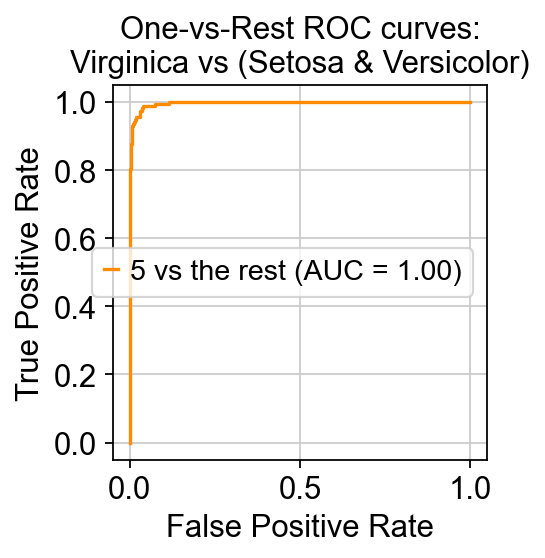

In [127]:
import matplotlib.pyplot as plt

from sklearn.metrics import RocCurveDisplay

RocCurveDisplay.from_predictions(
    y_onehot_test[:, class_id],
    y_score[:, class_id],
    name=f"{class_of_interest} vs the rest",
    color="darkorange",
    #plot_chance_level=True,
)
plt.axis("square")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("One-vs-Rest ROC curves:\nVirginica vs (Setosa & Versicolor)")
plt.legend()
plt.show()

In [128]:
y_pred = logreg.predict(smartseq[:,names].X)
y_proba = logreg.predict_proba(smartseq[:,names].X)

In [129]:
smartseq.obs['clusterK12_intersecting'] = [x for x in y_pred]
smartseq.obs['clusterK12_intersecting'] = smartseq.obs['clusterK12_intersecting'].astype('category')

In [130]:
#results_binary = y_pred
#probs_binary = y_proba

results_binary = logreg.predict(X_test)
probs_binary = logreg.predict_proba(X_test)

results_df_binary = pd.DataFrame()
results_df_binary['predicted'] = list(results_binary)
#results_df_binary['actual'] = list(smartseq.obs['clusterK12'])
results_df_binary['actual'] = list(y_test)
for x in range(0,12):
    results_df_binary["probability_%d" % (x+1)] = [i[x] for i in list(probs_binary)]
results_df_binary['highest_prob'] =results_df_binary[["probability_%d" % (x+1) for x in range(0,12)]].max(axis=1)
results_df_binary['correct'] = (results_df_binary['predicted'] == results_df_binary['actual']).astype(int)
results_df_binary

,predicted,actual,probability_1,probability_2,probability_3,probability_4,probability_5,probability_6,probability_7,probability_8,probability_9,probability_10,probability_11,probability_12,highest_prob,correct
0,3,3,1.145284e-08,6.482115e-05,5.904744e-01,2.188741e-02,2.001019e-06,1.081110e-04,2.673918e-04,3.842023e-01,1.948397e-05,1.504642e-05,7.148057e-05,2.887477e-03,0.590474,1
1,1,1,9.999999e-01,3.571974e-08,2.754714e-11,6.884062e-10,4.151598e-09,2.991691e-08,5.165145e-08,1.273974e-13,2.154250e-12,1.311926e-12,1.260848e-09,4.334755e-11,1.000000,1
2,8,8,1.273999e-06,3.832012e-05,1.946607e-04,3.055943e-05,3.687386e-05,5.194120e-05,2.591109e-04,9.929163e-01,4.238056e-03,1.940791e-03,2.589705e-04,3.314528e-05,0.992916,1
3,10,10,4.324379e-04,1.061553e-02,4.907708e-04,3.312075e-05,3.771398e-01,3.662602e-03,2.875183e-04,1.457936e-04,6.530853e-04,6.056757e-01,3.267336e-04,5.368954e-04,0.605676,1
4,8,8,2.727315e-07,7.807142e-07,2.698275e-07,5.428542e-06,1.596014e-06,4.267590e-06,7.787732e-05,9.880846e-01,1.178566e-02,8.464697e-06,5.557416e-06,2.525872e-05,0.988085,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
895,5,5,3.215541e-03,5.367374e-07,2.640175e-05,7.265989e-05,9.659568e-01,2.022521e-02,2.898445e-04,3.168739e-04,1.621906e-03,8.044446e-03,2.082650e-04,2.148322e-05,0.965957,1
896,5,5,9.002580e-08,3.987671e-04,1.007631e-05,8.039357e-05,9.994605e-01,1.033760e-05,5.418505e-06,2.166615e-11,4.841560e-07,9.797376e-08,3.135111e-05,2.443380e-06,0.999461,1
897,8,8,9.704334e-07,7.212377e-06,7.588422e-06,7.731725e-04,2.702176e-09,2.759594e-06,4.158063e-05,9.792301e-01,1.977088e-02,1.457751e-04,1.119684e-05,8.800007e-06,0.979230,1
898,5,5,3.938110e-10,2.025298e-07,4.880586e-05,2.419686e-09,9.999460e-01,1.215247e-07,1.232289e-06,2.160507e-07,1.186128e-07,8.004956e-08,2.539694e-06,6.624252e-07,0.999946,1


In [131]:
results_df_binary['bin'] = pd.qcut(results_df_binary['highest_prob'], q=7)
idx = pd.IntervalIndex(results_df_binary['bin'])
results_df_binary['low'] = idx.left
results_df_binary['high'] = idx.right
results_df_binary['prob range'] = results_df_binary['low'].round(2).astype(str) + "-" + results_df_binary['high'].round(2).astype(str)
df_bins_grouped = results_df_binary[['low','high','correct','prob range']].groupby('prob range').mean().reset_index()
df_bins_grouped

,prob range,low,high,correct
0,0.24-0.82,0.236390,0.818000,0.581395
1,0.82-0.98,0.818000,0.977530,0.835938
2,0.98-1.0,0.977530,0.996490,0.914729
3,1.0-1.0,0.998958,0.999833,0.992218


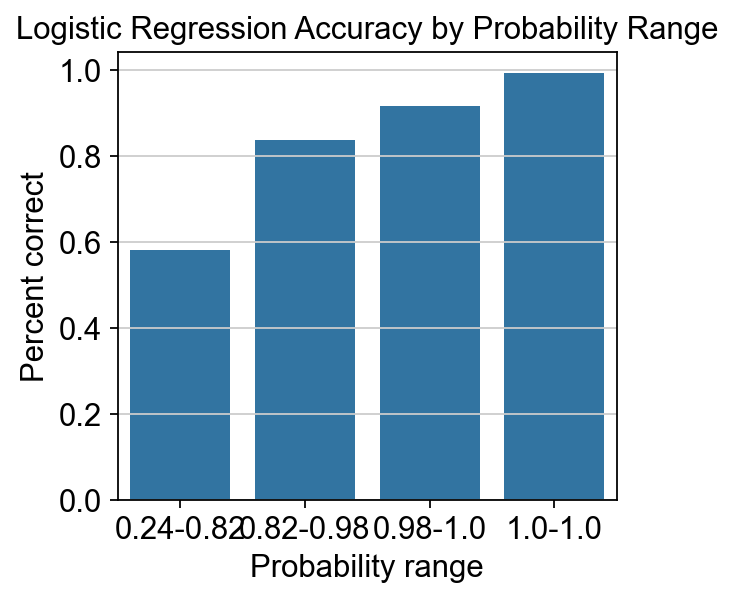

In [132]:
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns
plt.figure(figsize=(4,4))
plt.subplots_adjust(top=0.85)
#plt.figure(figsize=(11,9))
#plt.subplots_adjust(top=0.85)

ax = sns.barplot(x='prob range', y='correct', data=df_bins_grouped)
plt.title("Logistic Regression Accuracy by Probability Range")
plt.ylabel('Percent correct')
plt.xlabel('Probability range')
plt.show()

In [133]:
#reset size
from matplotlib import rcParams
FIGSIZE=(4,4)
rcParams['figure.figsize']=FIGSIZE

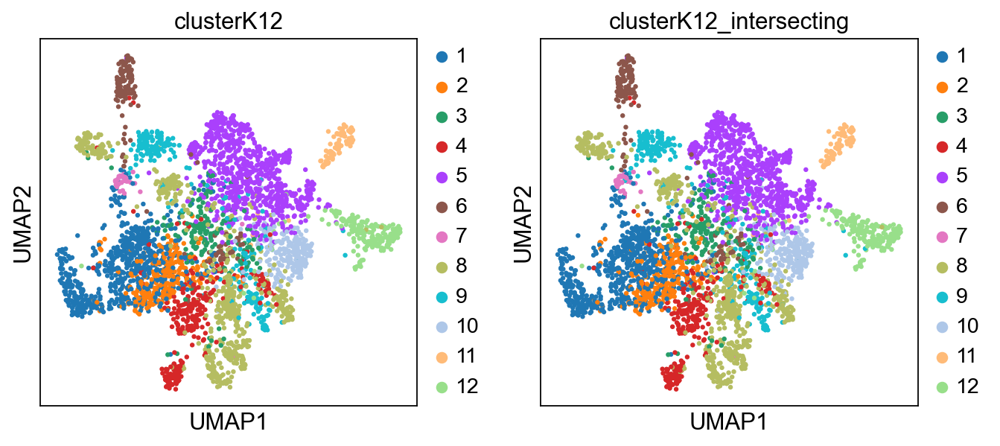

In [134]:
sc.pl.umap(smartseq, color=['clusterK12','clusterK12_intersecting'])

In [135]:
dict = {1: "01", 2: "02", 3: "03", 4: "04", 5: "05", 6: "06", 7: "07", 8: "08", 9: "09", 10: "10", 11: "11", 12: "12"}

In [136]:
from sklearn.metrics import accuracy_score
accuracy_score(smartseq.obs.replace({"clusterK12": dict})['clusterK12'], smartseq.obs['clusterK12_intersecting'])

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_9696/3184290090.py:2: FutureWarning: The behavior of Series.replace (and DataFrame.replace) with CategoricalDtype is deprecated. In a future version, replace will only be used for cases that preserve the categories. To change the categories, use ser.cat.rename_categories instead.
  accuracy_score(smartseq.obs.replace({"clusterK12": dict})['clusterK12'], smartseq.obs['clusterK12_intersecting'])


0.0

In [137]:
results_binary = logreg.predict(smartseq[:,names].X)
probs_binary = logreg.predict_proba(smartseq[:,names].X)

results_df_binary = pd.DataFrame()
results_df_binary['predicted'] = list(results_binary)
#results_df_binary['actual'] = list(smartseq.obs['clusterK12'])
for x in range(0,12):
    results_df_binary[x+1] = [i[x] for i in list(probs_binary)]
results_df_binary['highest_prob'] =results_df_binary[[x+1 for x in range(0,12)]].max(axis=1)
results_df_binary

,predicted,1,2,3,4,5,6,7,8,9,10,11,12,highest_prob
0,11,3.545185e-09,2.984144e-07,1.186764e-07,3.891847e-10,3.440365e-09,1.561415e-10,1.423478e-08,2.103837e-15,1.498202e-09,1.453514e-11,9.999996e-01,4.589887e-09,1.000000
1,12,5.775180e-10,9.616499e-10,4.928689e-10,1.470457e-08,3.969547e-13,7.897547e-07,1.118563e-08,1.081316e-09,4.026407e-07,1.699619e-07,3.908536e-09,9.999986e-01,0.999999
2,5,6.825534e-04,5.544599e-08,1.301474e-03,1.992614e-07,9.979283e-01,1.832034e-05,1.930694e-05,1.383417e-07,2.647909e-07,1.889051e-05,1.070025e-05,1.975735e-05,0.997928
3,10,9.644817e-06,1.102524e-05,5.167000e-06,3.464604e-03,7.644163e-08,1.457769e-05,3.437113e-06,5.675284e-04,1.541163e-05,9.958909e-01,3.652143e-06,1.402308e-05,0.995891
4,1,9.999995e-01,9.881027e-10,1.226652e-07,2.864932e-07,7.877806e-09,1.290301e-08,7.999339e-09,7.415283e-11,2.382664e-13,1.603375e-09,5.247534e-08,1.407107e-09,1.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3595,8,3.783225e-08,7.487809e-06,1.314382e-07,2.196656e-07,2.930845e-09,1.890982e-08,3.589909e-07,9.998221e-01,1.694802e-04,7.100405e-08,9.278300e-08,8.136423e-09,0.999822
3596,9,1.386972e-10,6.603218e-08,2.321768e-08,6.715344e-08,7.145914e-09,8.798909e-09,1.107240e-06,4.066201e-03,9.959322e-01,2.775961e-08,2.449845e-07,2.197610e-08,0.995932
3597,8,1.401636e-07,2.390544e-06,1.351676e-07,8.323129e-06,8.258163e-10,4.094208e-08,1.776162e-06,9.993532e-01,6.330685e-04,2.544852e-07,5.663831e-07,1.504954e-07,0.999353
3598,8,9.827236e-08,1.148979e-05,2.940243e-06,1.947799e-06,6.512653e-05,2.018854e-07,3.072898e-06,9.998863e-01,2.485868e-05,2.198594e-06,1.261622e-06,4.736423e-07,0.999886


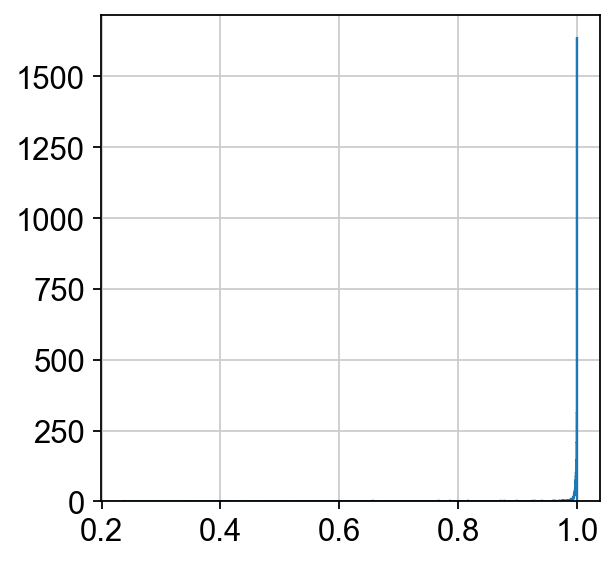

In [138]:
_ = plt.hist(results_df_binary['highest_prob'], bins='auto', histtype='step')

## End LogisticRegression

In [139]:
adata_ordered_genes = [adata_names.index(x) for x in names]

In [140]:
adata_log_ordered = adata_log[:,adata_ordered_genes]

In [141]:
y_pred = logreg.predict(adata_log_ordered.X)

In [142]:
adata_log_ordered.obs['clusterK12'] = [x for x in y_pred]
adata_log_ordered.obs['clusterK12'] = adata_log_ordered.obs['clusterK12'].astype('category')

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_9696/3908199522.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_log_ordered.obs['clusterK12'] = [x for x in y_pred]


In [143]:
#reset size
from matplotlib import rcParams
FIGSIZE=(4,4)
rcParams['figure.figsize']=FIGSIZE

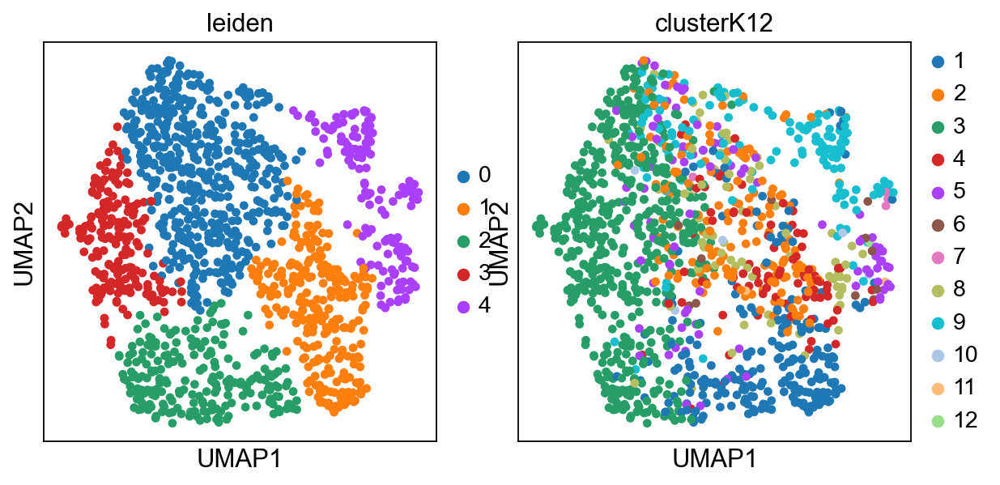

In [144]:
sc.pl.umap(adata_log_ordered,color=['leiden','clusterK12'], wspace=0.1)

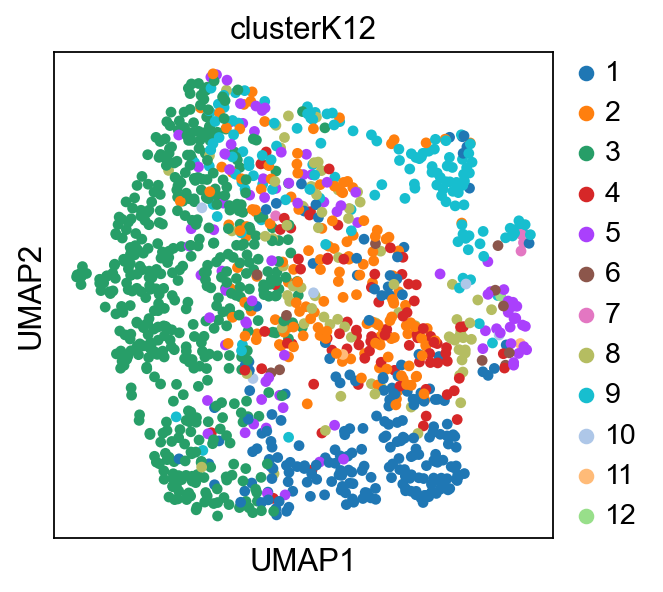

In [145]:
sc.pl.umap(adata_log_ordered,color=['clusterK12'])

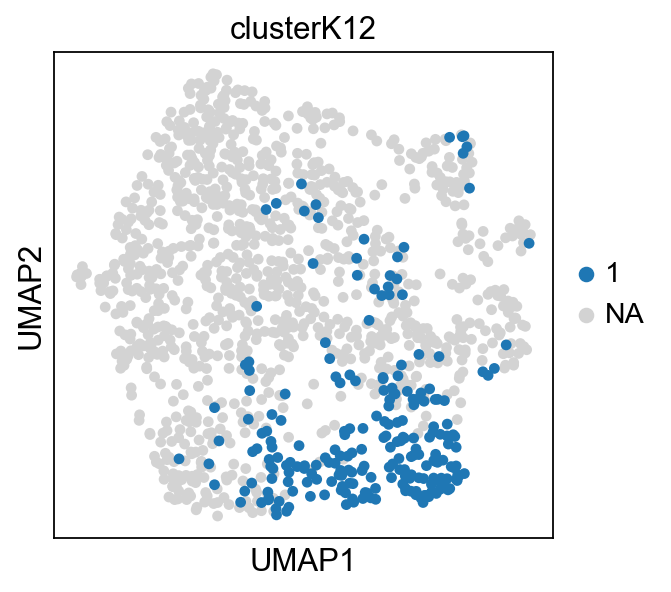

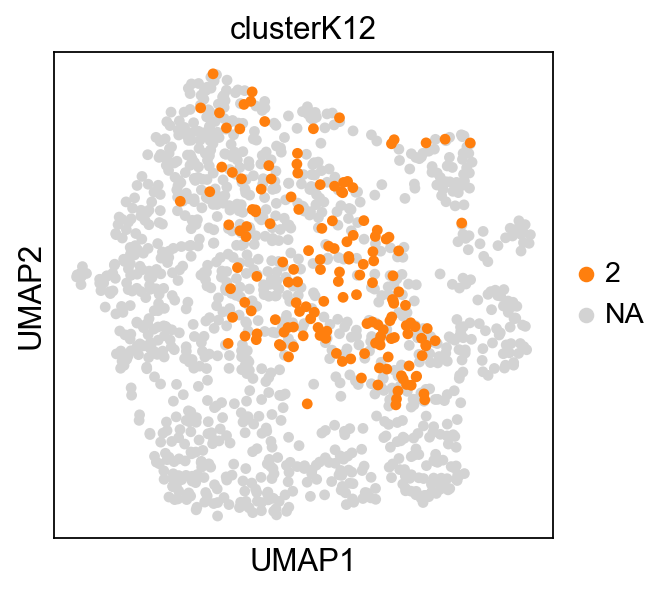

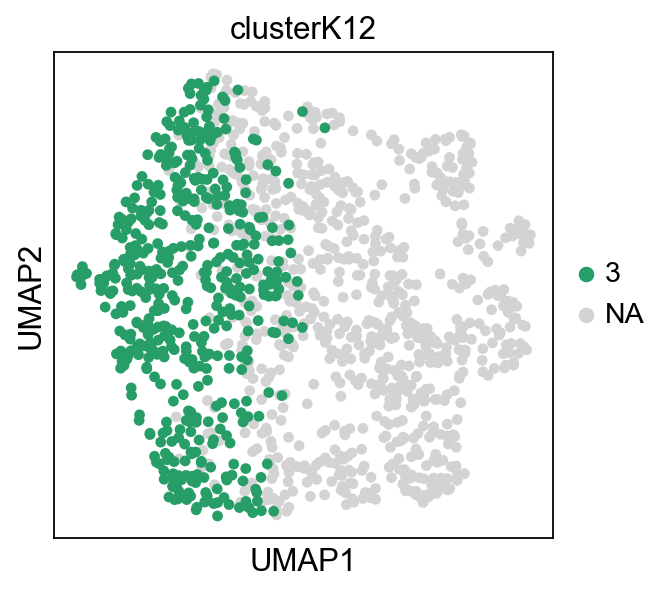

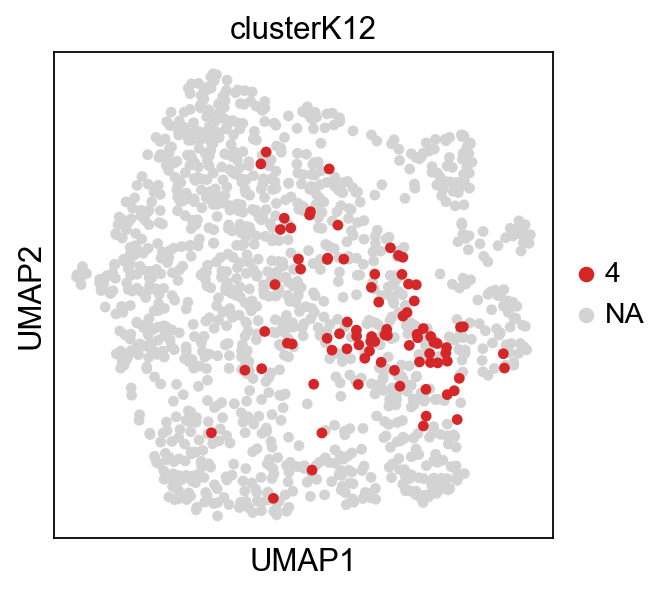

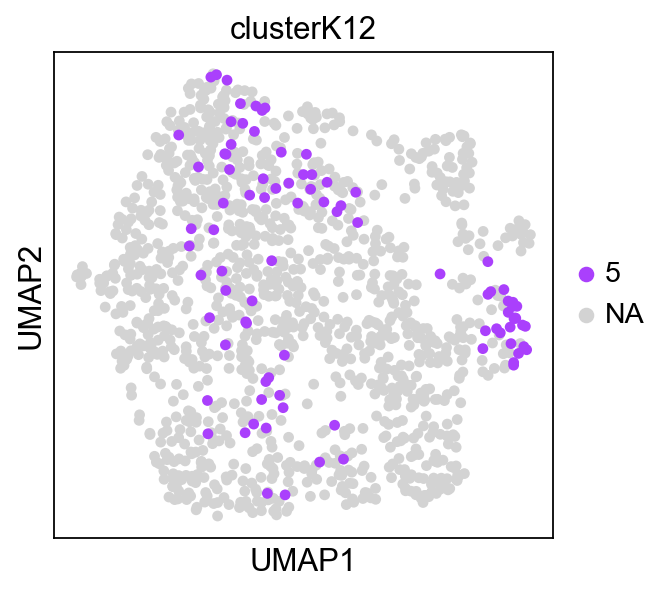

...

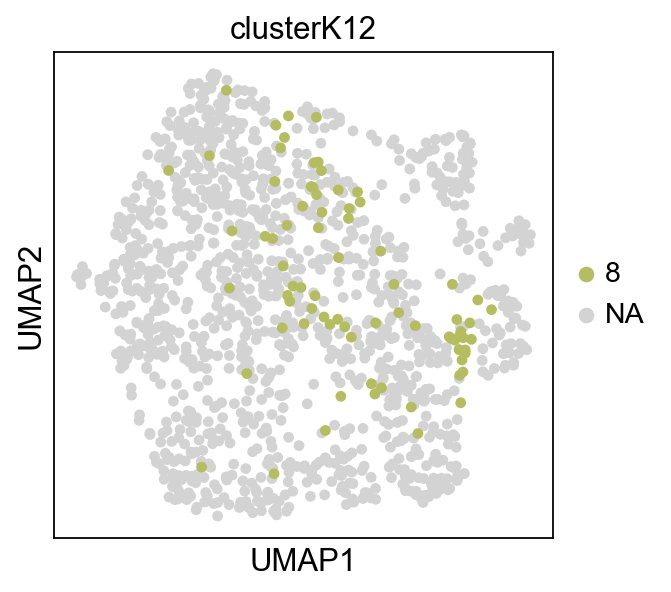

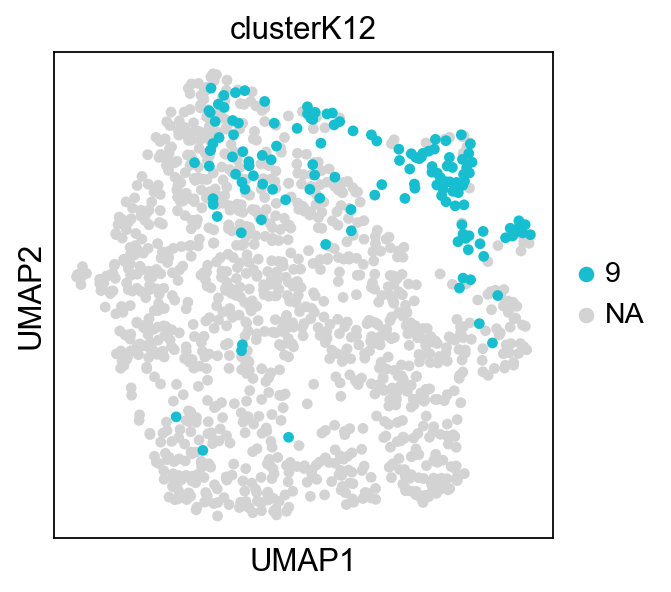

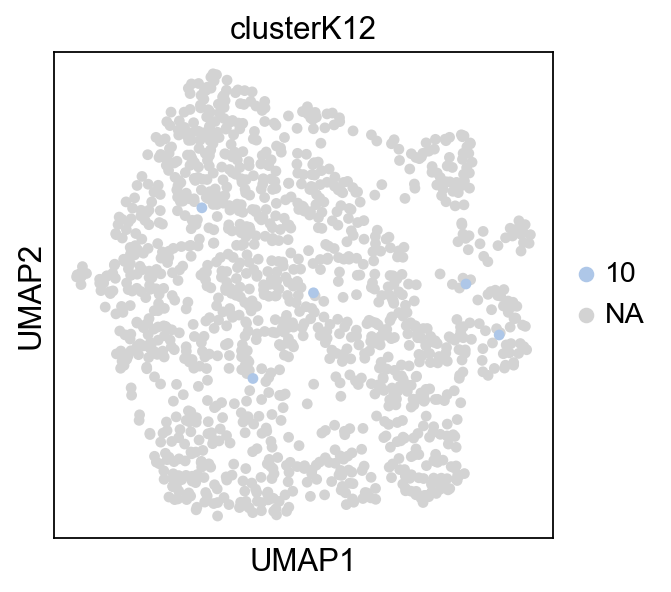

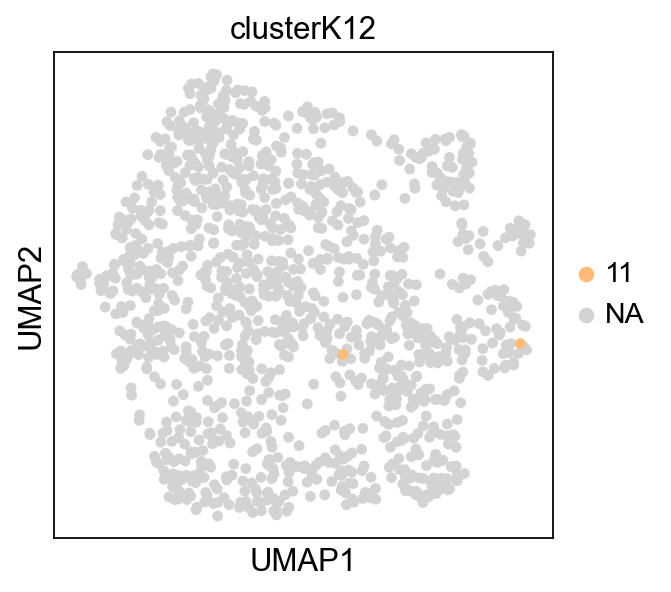

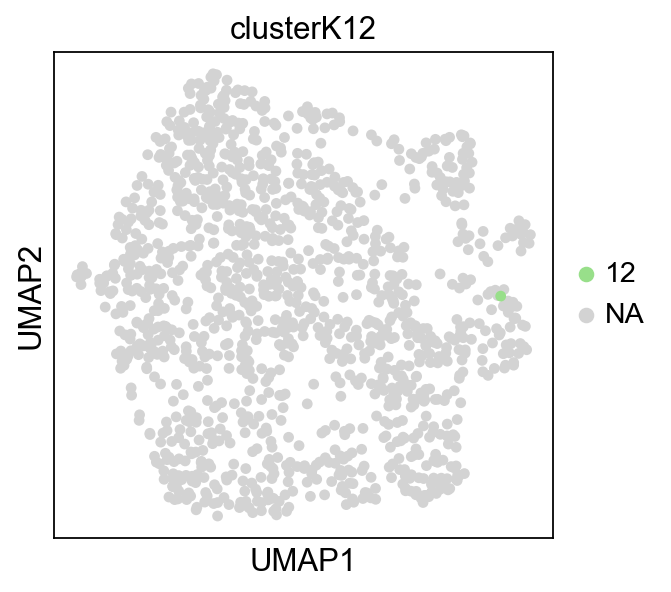

In [146]:
for x in adata_log_ordered.obs.clusterK12.cat.categories:
    sc.pl.umap(adata_log_ordered,color=['clusterK12'], groups=[x])

In [147]:
# bug fix
adata_log_ordered.uns['log1p']['base'] = None

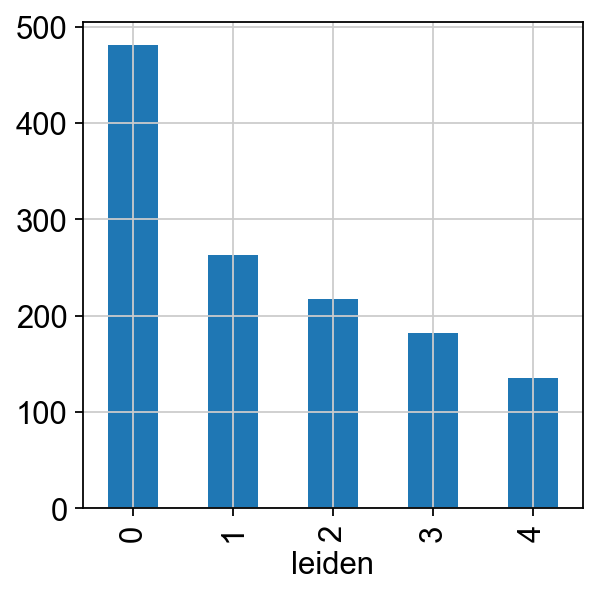

In [148]:
 cell_proportion_df = adata_log_ordered.obs.leiden.value_counts().T.plot(kind='bar', stacked=True, legend=False)

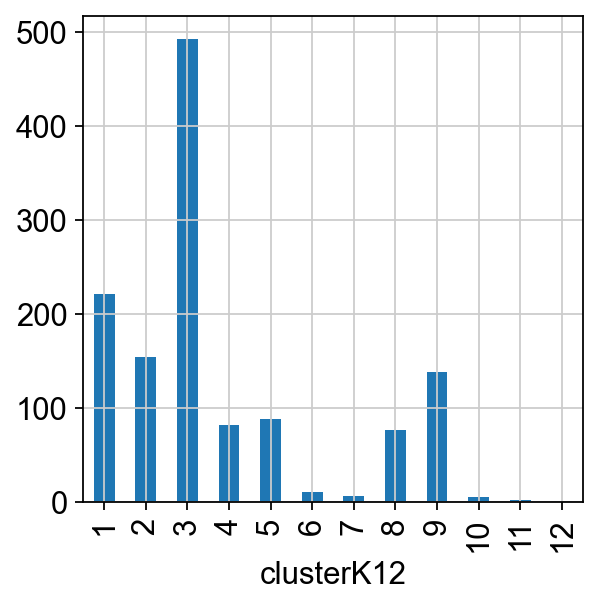

In [149]:
 cell_proportion_df = adata_log_ordered.obs.clusterK12.value_counts(sort=False).T.plot(kind='bar', stacked=True, legend=False)

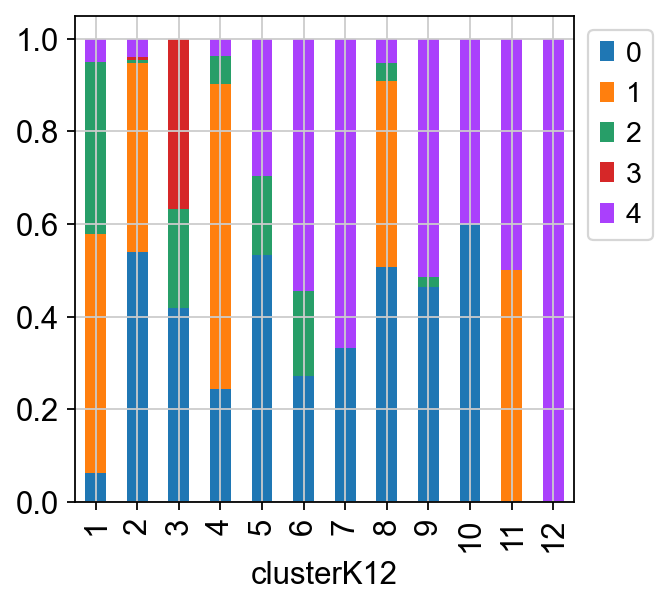

In [150]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['leiden'],adata_log_ordered.obs['clusterK12'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

In [151]:
results_binary = logreg.predict(adata_log_ordered.X)
probs_binary = logreg.predict_proba(adata_log_ordered.X)

results_df_binary = pd.DataFrame()
results_df_binary['predicted'] = list(results_binary)
#results_df_binary['actual'] = list(smartseq.obs['clusterK12'])
for x in range(0,12):
    results_df_binary[x+1] = [i[x] for i in list(probs_binary)]
results_df_binary['highest_prob'] =results_df_binary[[x+1 for x in range(0,12)]].max(axis=1)
results_df_binary

,predicted,1,2,3,4,5,6,7,8,9,10,11,12,highest_prob
0,10,2.795132e-02,3.459050e-06,3.892765e-06,0.270895,1.786189e-04,5.728230e-03,0.008665,0.149655,0.019855,0.503351,0.003330,0.010383,0.503351
1,1,9.936525e-01,1.356163e-07,2.307093e-04,0.000147,2.729447e-03,3.341802e-04,0.000475,0.000192,0.000043,0.000058,0.001197,0.000940,0.993653
2,5,1.843452e-07,3.983616e-04,2.904048e-02,0.000006,9.653459e-01,1.220092e-04,0.000534,0.000003,0.001048,0.000196,0.000378,0.002927,0.965346
3,4,1.115928e-03,1.456414e-01,4.888179e-04,0.805889,1.976023e-05,6.981050e-03,0.002267,0.030669,0.000005,0.005067,0.001467,0.000390,0.805889
4,3,1.789934e-02,4.255294e-04,5.776369e-01,0.000166,3.627597e-01,7.212577e-03,0.002514,0.000590,0.000316,0.018673,0.005086,0.006719,0.577637
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1273,2,2.173505e-01,7.626798e-01,1.379530e-07,0.001985,2.337853e-04,1.538956e-03,0.002302,0.000428,0.001100,0.009794,0.001266,0.001322,0.762680
1274,2,1.532765e-03,3.925483e-01,2.808615e-02,0.020468,6.370619e-03,3.666491e-02,0.018042,0.107634,0.035886,0.220011,0.058754,0.074002,0.392548
1275,9,1.062446e-04,1.195524e-01,1.843279e-01,0.096723,1.563799e-02,3.166546e-02,0.008129,0.006236,0.505153,0.021003,0.008588,0.002878,0.505153
1276,3,2.449829e-05,1.025515e-02,8.847738e-01,0.002793,2.759350e-03,3.652408e-03,0.003127,0.001574,0.085327,0.000751,0.003771,0.001192,0.884774


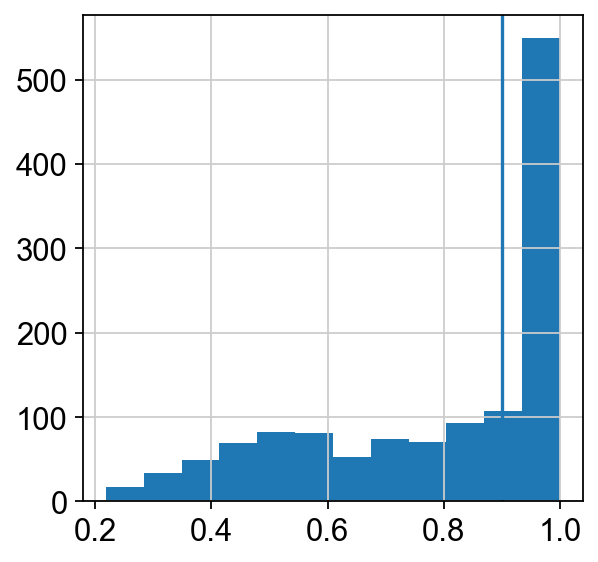

In [152]:
_ = plt.hist(results_df_binary['highest_prob'], bins='auto')
plt.axvline(x=0.9)

In [153]:
results_df_binary['bin'] = pd.qcut(results_df_binary['highest_prob'], q=7)
idx = pd.IntervalIndex(results_df_binary['bin'])
results_df_binary['low'] = idx.left
results_df_binary['high'] = idx.right
results_df_binary['prob range'] = results_df_binary['low'].round(2).astype(str) + "-" + results_df_binary['high'].round(2).astype(str)
df_bins_grouped = results_df_binary[['low','high','prob range']].groupby('prob range').mean().reset_index()
df_bins_grouped

,prob range,low,high
0,0.22-0.5,0.217,0.495
1,0.5-0.65,0.495,0.652
2,0.65-0.82,0.652,0.820
3,0.82-0.94,0.820,0.937
4,0.94-0.98,0.937,0.983
5,0.98-1.0,0.983,0.997
6,1.0-1.0,0.997,1.000


In [154]:
cutoff = 0.8
adata_log_ordered.obs['clusterK12_stringent'] = 'other'
adata_log_ordered.obs['clusterK12_stringent'][np.array(results_df_binary['highest_prob'] >= cutoff)] = ["%02d" % y for y in results_df_binary[[x+1 for x in range(0,12)]].idxmax(axis=1)[np.array(results_df_binary['highest_prob'] >= cutoff)].to_numpy()]

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_9696/4020989001.py:3: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata_log_ordered.obs['clusterK12_stringent'][np.array(results_df_binary['highest_prob'] >= cutoff)] = ["%02d" % y

In [155]:
adata_log_ordered.obs['clusterK12_stringent']

AAACCCTGTCCCGTAA-1    other
AAACCGCTCCCATGAA-1       01
AAACGAATCATGACTG-1       05
AAACGATGTCATTAGC-1       04
AAAGCAATCAATCACG-1    other
                      ...  
TGTCGTCCAAGCGAGG-1    other
TGTCTTGCAAGCCTAG-1    other
TGTCTTGCAGCCAGGT-1    other
TGTGCCAGTATAGTGG-1       03
TGTGCGCGTCCATCAG-1       08
Name: clusterK12_stringent, Length: 1278, dtype: object

In [156]:
adata_log_ordered.obs['clusterK12_stringent'] = adata_log_ordered.obs['clusterK12_stringent'].astype('category')

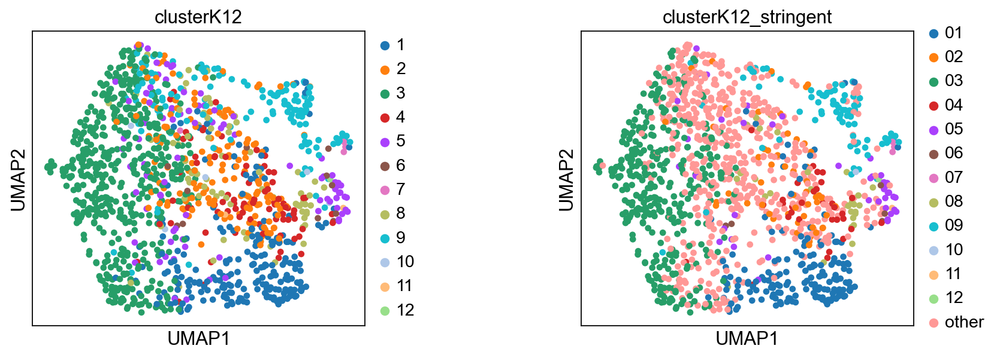

In [157]:
sc.pl.umap(adata_log_ordered, color=['clusterK12', 'clusterK12_stringent'], wspace=0.5)

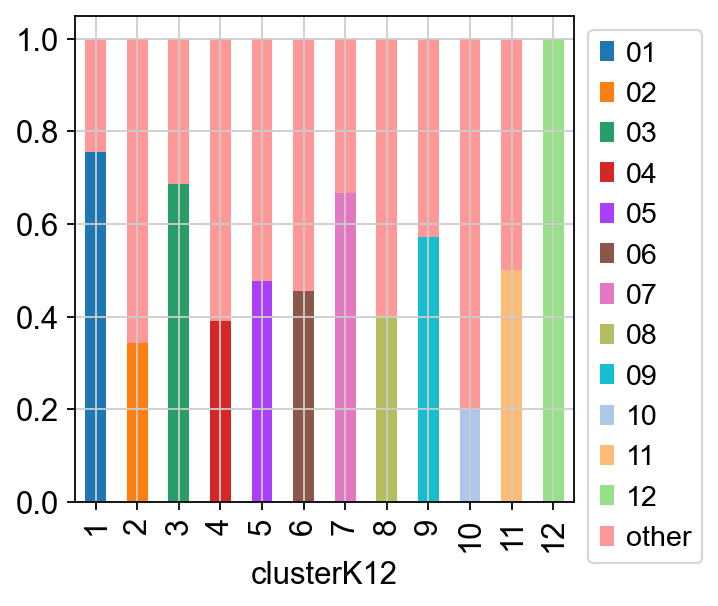

In [158]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['clusterK12_stringent'],adata_log_ordered.obs['clusterK12'],normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

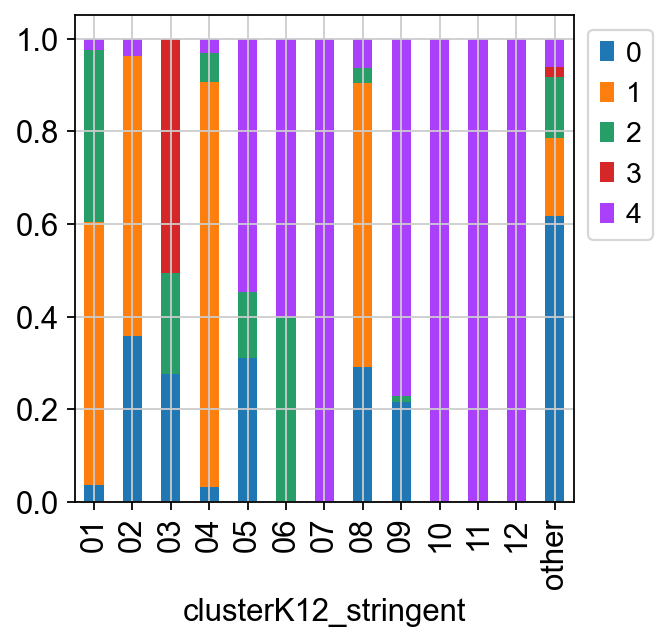

In [159]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['leiden'],adata_log_ordered.obs['clusterK12_stringent'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

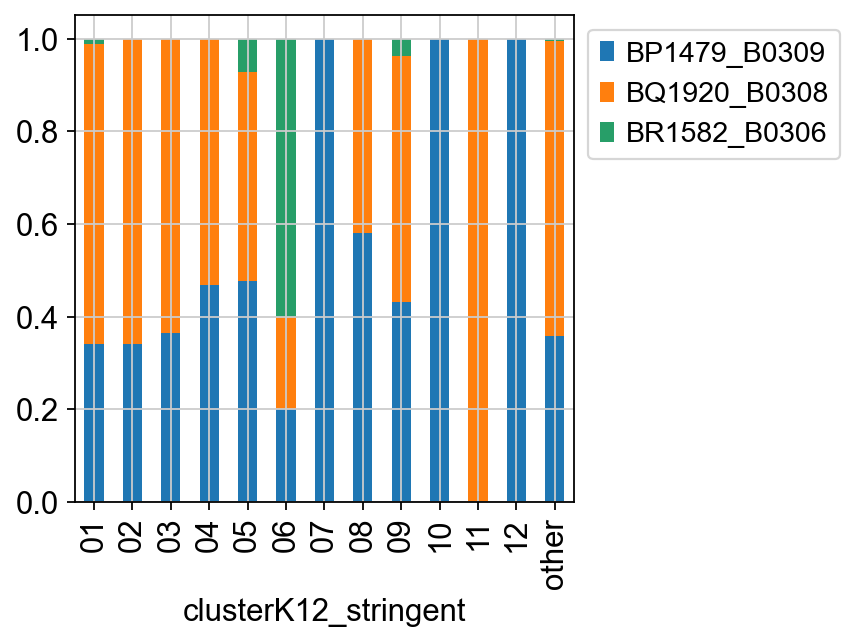

In [160]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['Classification'],adata_log_ordered.obs['clusterK12_stringent'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

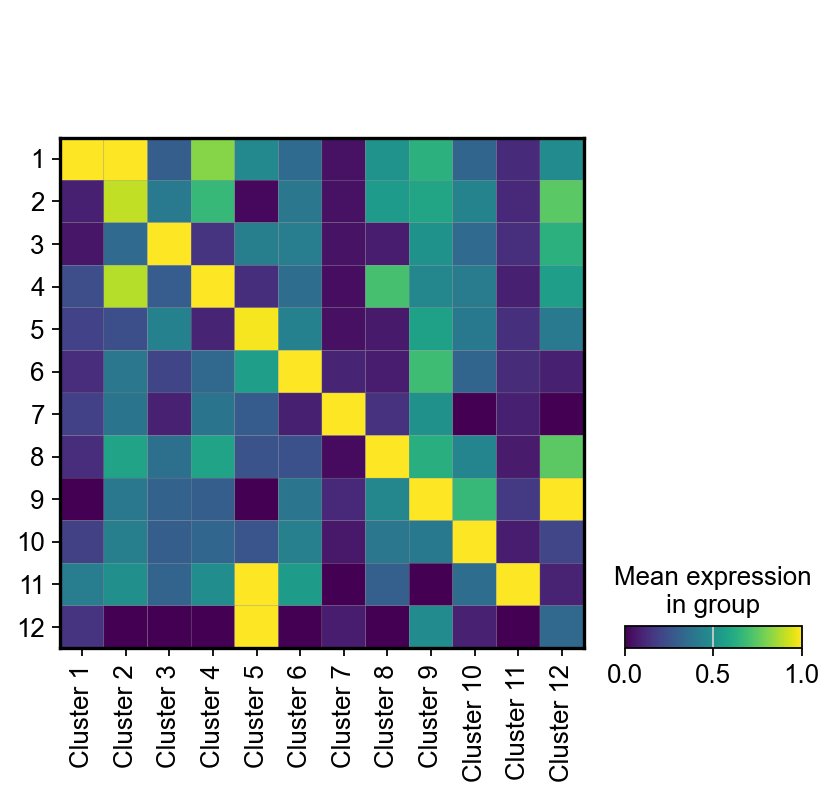

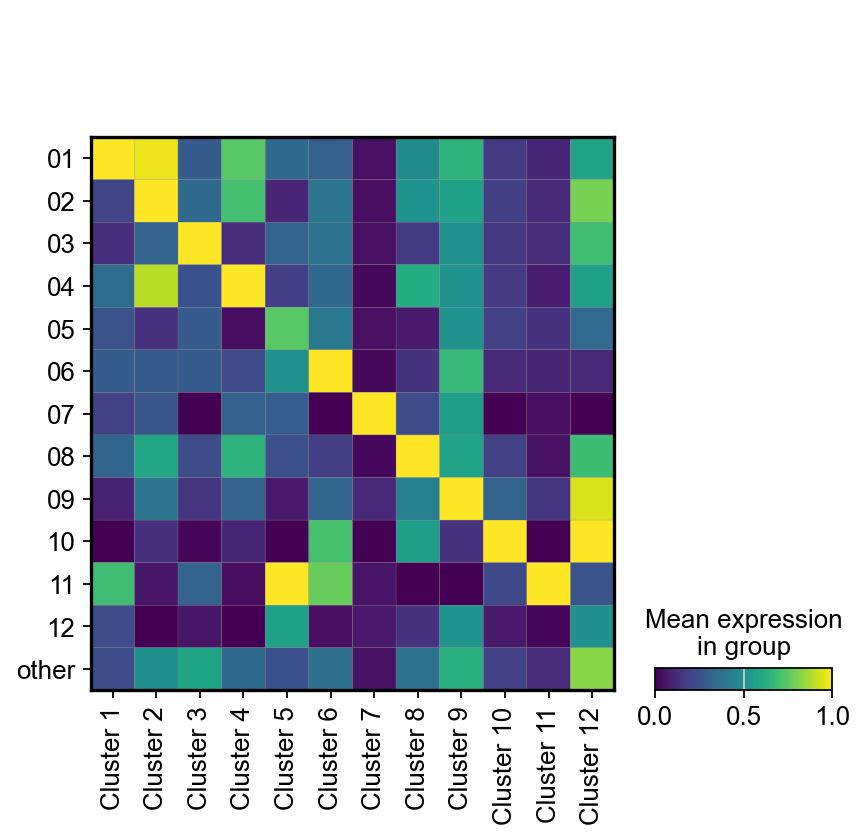

In [161]:
cancerCell = ['Cluster 1', 'Cluster 2','Cluster 3','Cluster 4','Cluster 5','Cluster 6', 'Cluster 7', 
              'Cluster 8', 'Cluster 9', 'Cluster 10', 'Cluster 11', 'Cluster 12']
#cell_proportion_df = pd.crosstab(adata_log_ordered.obs['Cluster 1'],adata_log_ordered.obs['clusterK12']).T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))
sc.pl.matrixplot(adata_log_ordered, cancerCell, 'clusterK12', standard_scale='var')
sc.pl.matrixplot(adata_log_ordered, cancerCell, 'clusterK12_stringent', standard_scale='var')

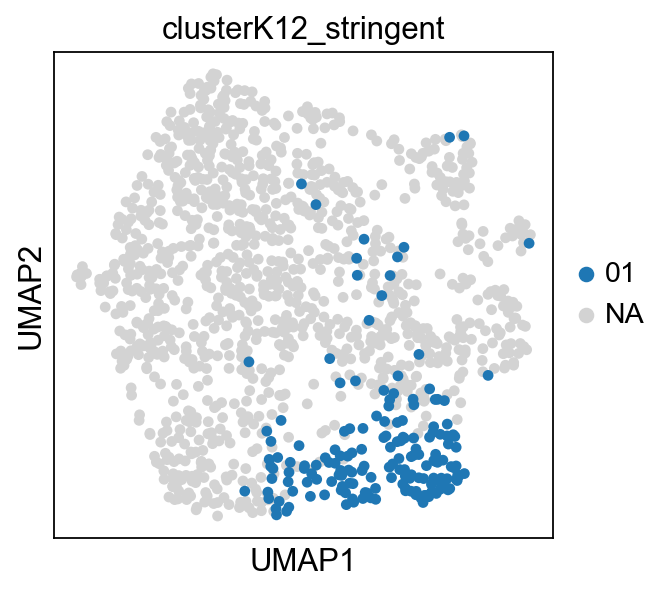

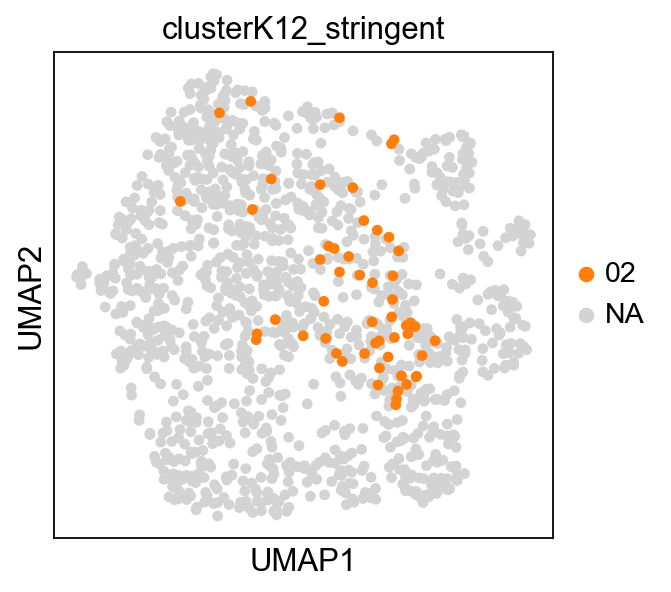

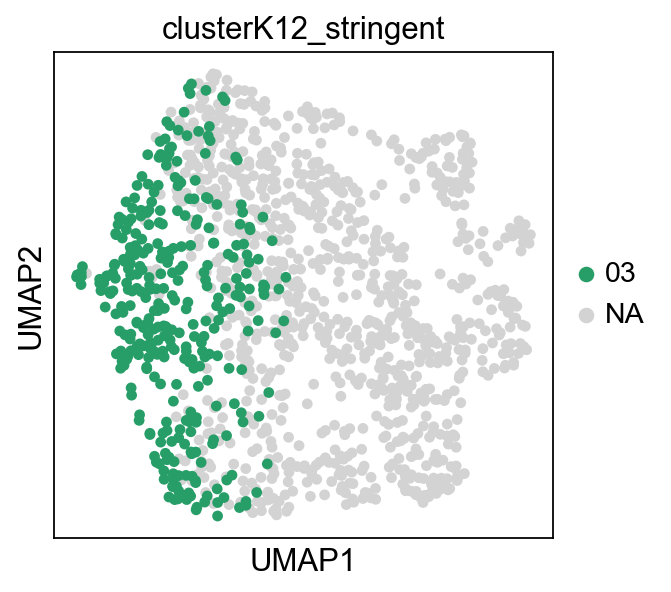

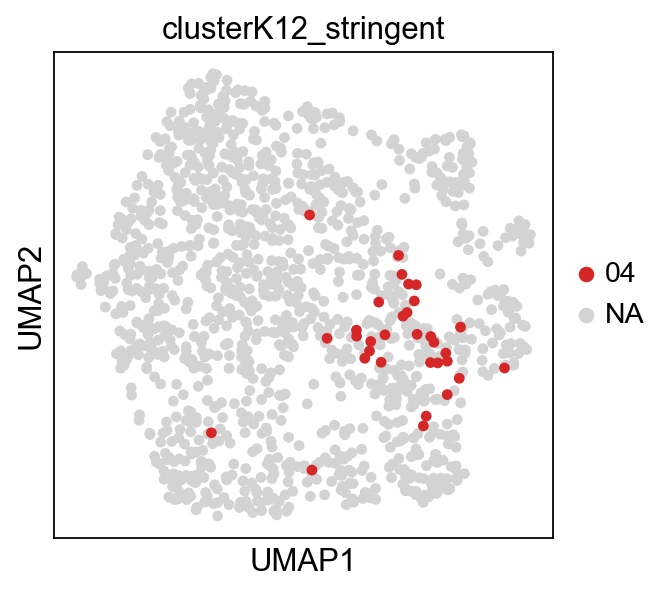

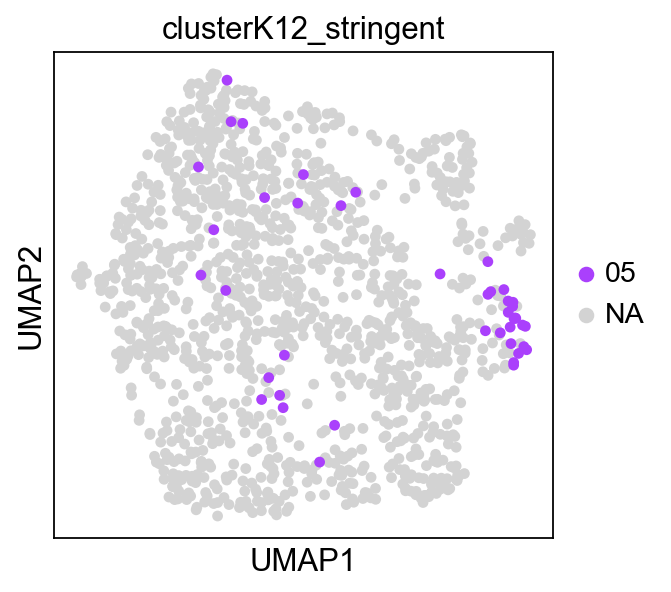

...

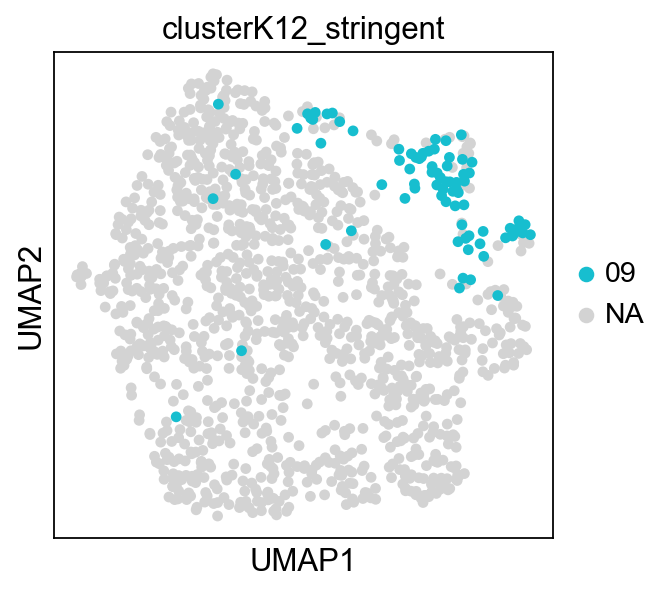

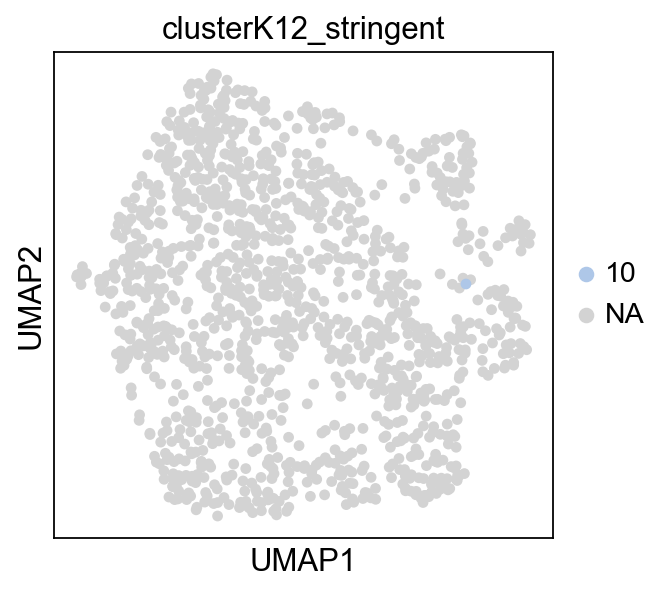

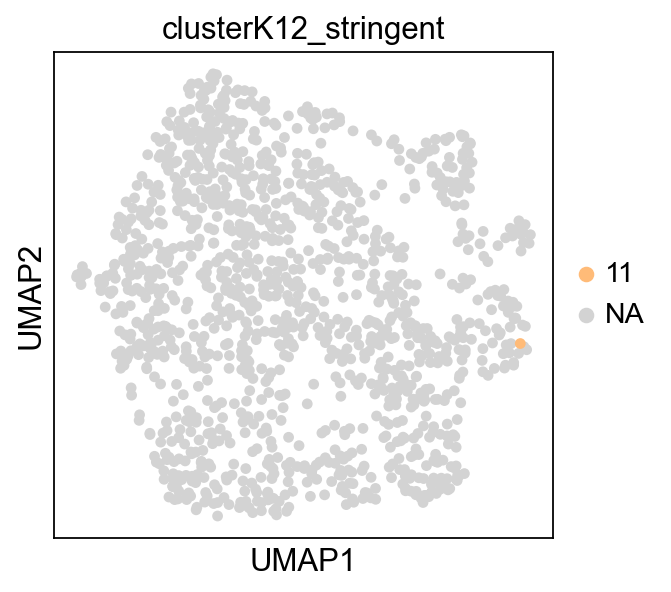

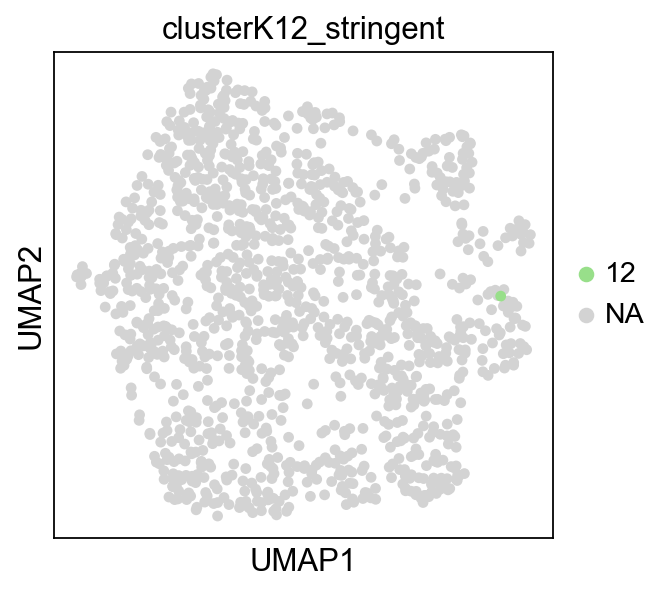

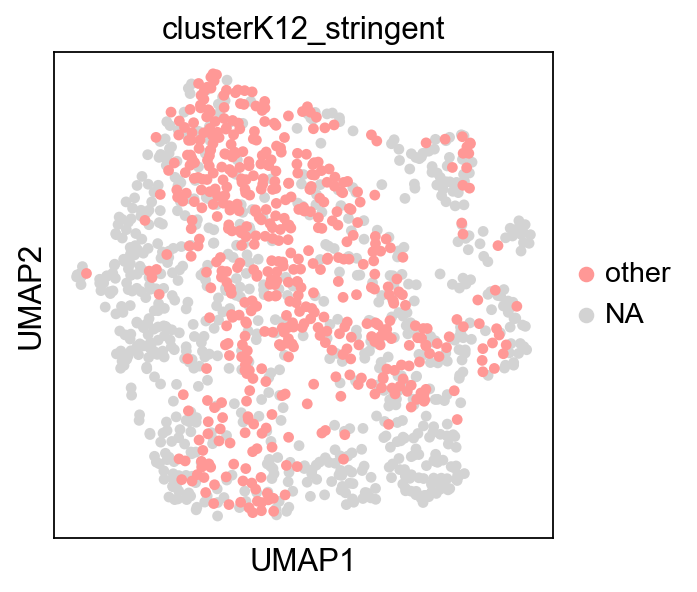

In [162]:
for x in adata_log_ordered.obs.clusterK12_stringent.cat.categories:
    # skip if NA
    sc.pl.umap(adata_log_ordered, color='clusterK12_stringent', groups=[x])

In [163]:
adata_log_ordered.obs.clusterK12.value_counts()

clusterK12
3     493
1     221
2     154
9     138
5      88
4      82
8      77
6      11
7       6
10      5
11      2
12      1
Name: count, dtype: int64

In [164]:
cancerCell = ['Cluster 1', 'Cluster 2','Cluster 3','Cluster 4','Cluster 5','Cluster 6', 'Cluster 7', 
              'Cluster 8', 'Cluster 9', 'Cluster 10', 'Cluster 11', 'Cluster 12']
#sc.pl.violin(adata_log_ordered, cancerCell, groupby='clusterK12')

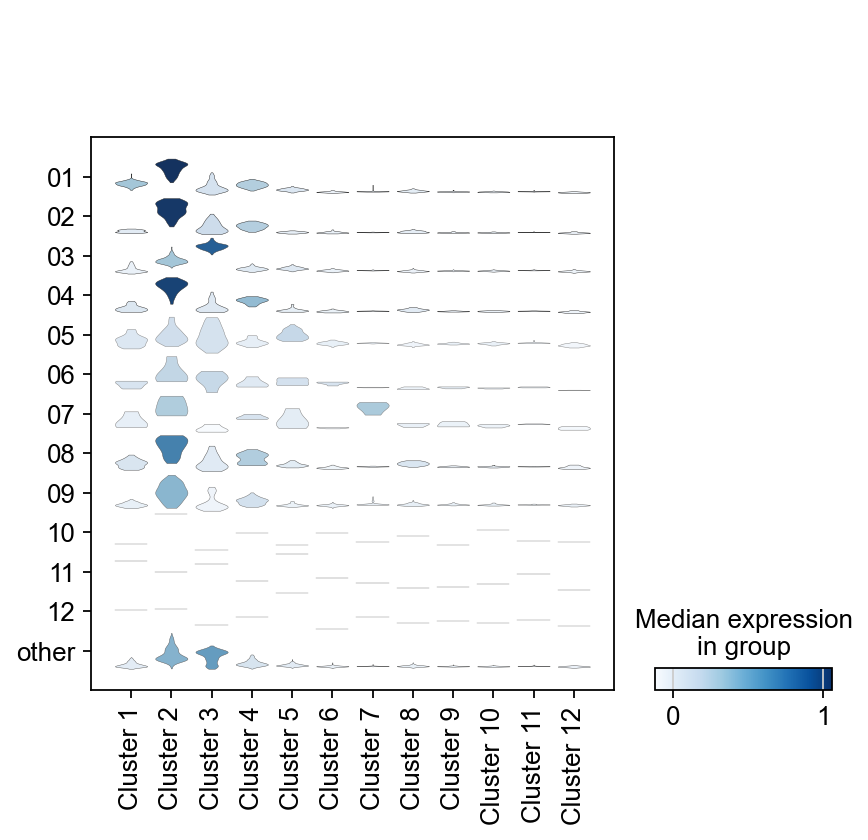

In [165]:
sc.pl.stacked_violin(adata_log_ordered, cancerCell, groupby='clusterK12_stringent')

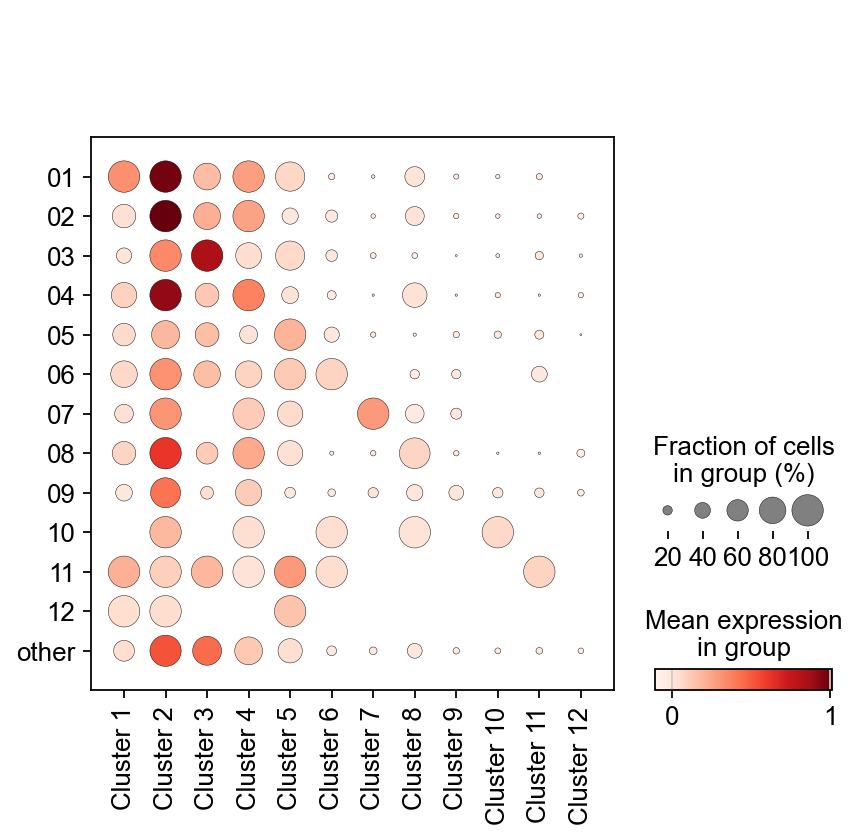

In [166]:
sc.pl.dotplot(adata_log_ordered, [*cancerCell], groupby='clusterK12_stringent')

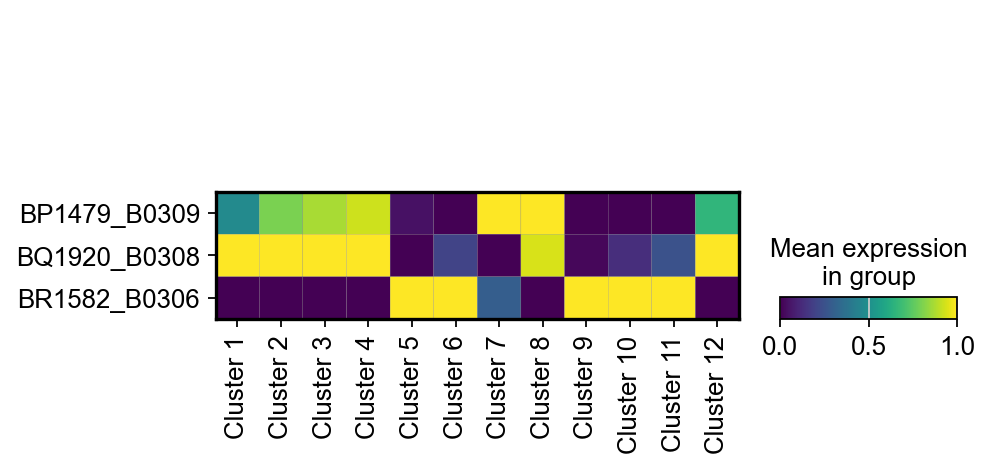

In [167]:
sc.pl.matrixplot(adata_log_ordered, [*cancerCell], groupby='Classification',standard_scale='var')

In [168]:
adata.obs['clusterK12'] = adata_log_ordered.obs['clusterK12'].astype('category')
adata.obs['clusterK12_stringent'] = adata_log_ordered.obs['clusterK12_stringent'].astype('category')

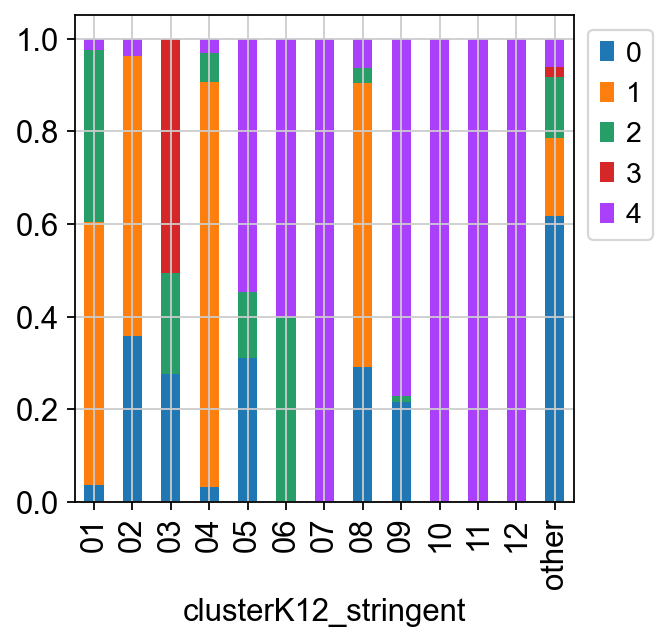

In [169]:
 cell_proportion_df = pd.crosstab(adata.obs['leiden'],adata_log_ordered.obs['clusterK12_stringent'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

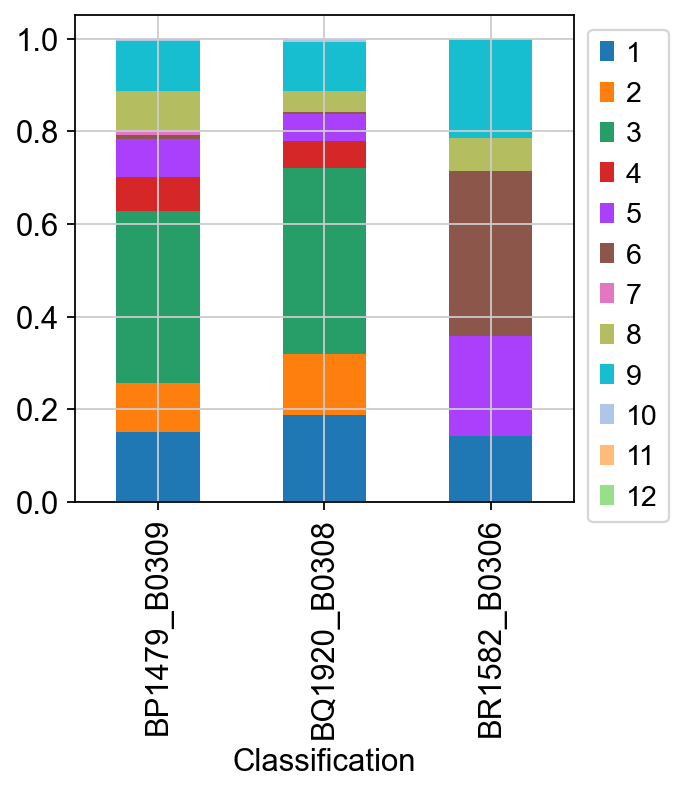

In [170]:
 cell_proportion_df = pd.crosstab(adata.obs['clusterK12'],adata_log_ordered.obs['Classification'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

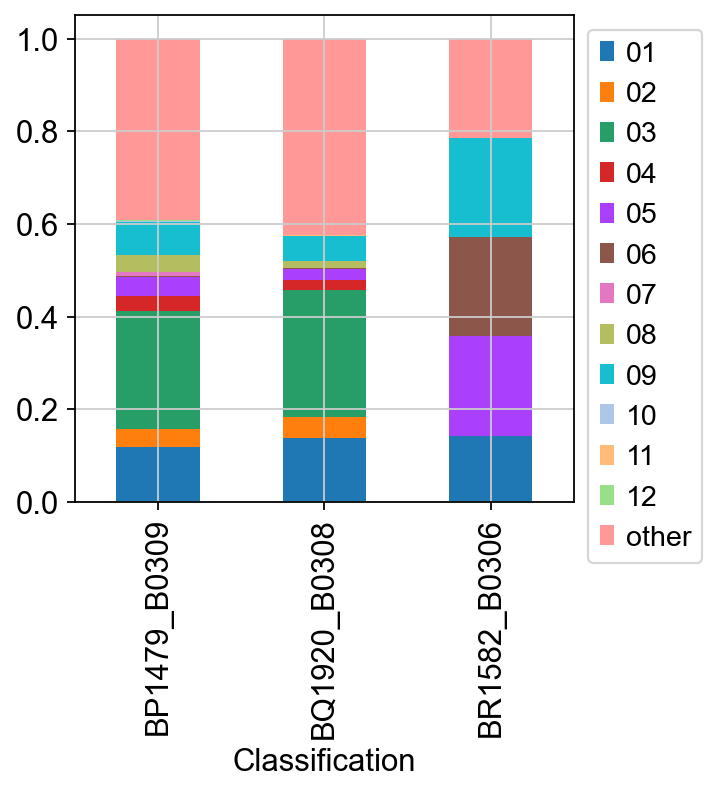

In [171]:
 cell_proportion_df = pd.crosstab(adata.obs['clusterK12_stringent'],adata_log_ordered.obs['Classification'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

## Examine Groupings

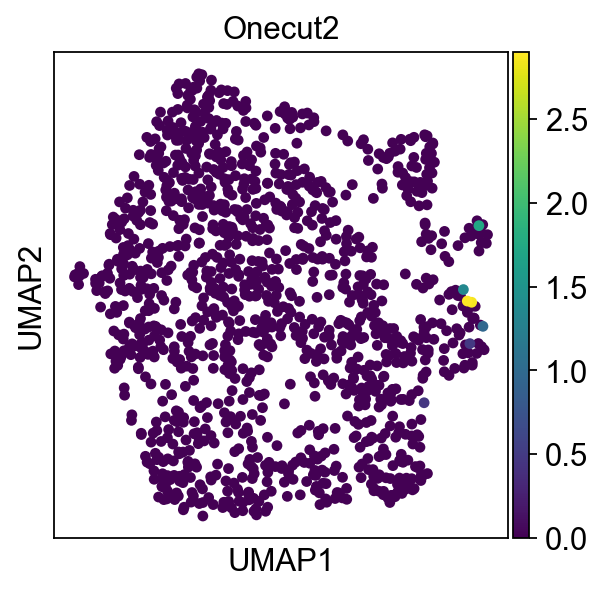

In [172]:
sc.pl.umap(adata, color=['Onecut2'])

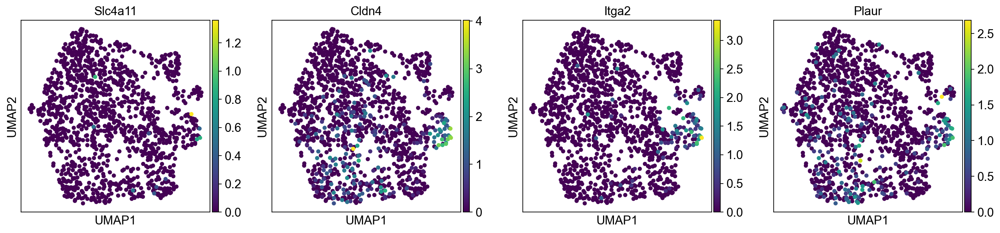

In [173]:
sc.pl.umap(adata, color=['Slc4a11','Cldn4','Itga2', 'Plaur']) #'Tigit',

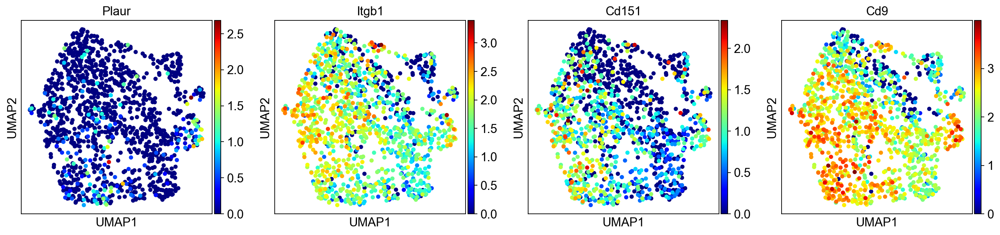

In [174]:
sc.pl.umap(adata, color=['Plaur','Itgb1','Cd151', 'Cd9'], cmap="jet")

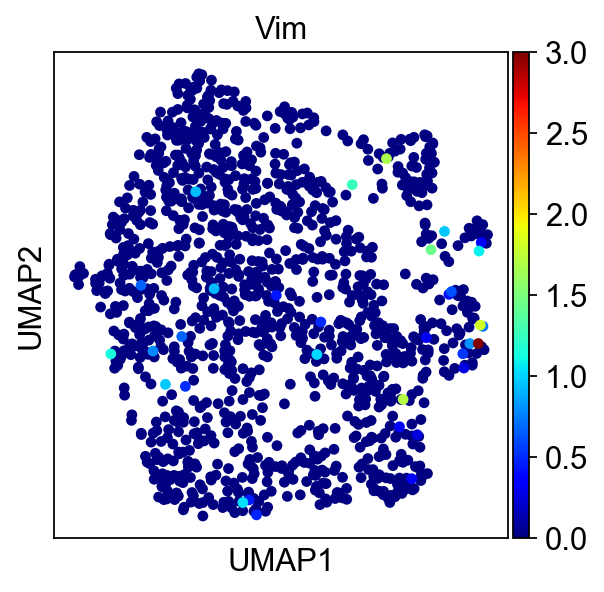

In [175]:
sc.pl.umap(adata, color=['Vim',], cmap="jet") #'Cd109'

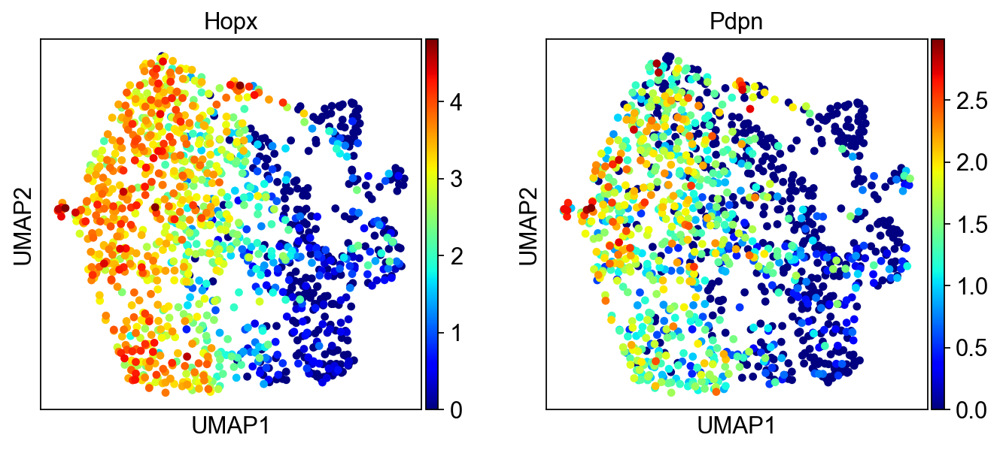

In [176]:
sc.pl.umap(adata, color=['Hopx','Pdpn'], cmap="jet")

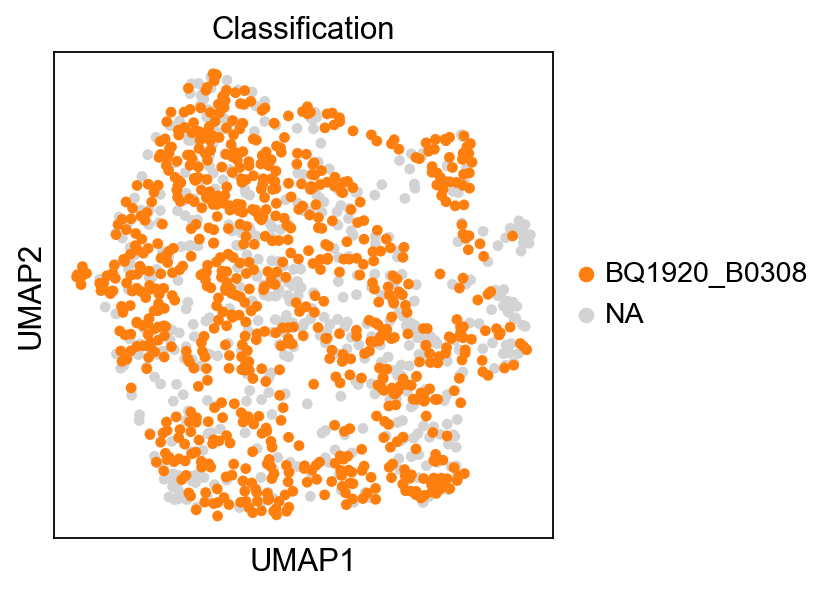

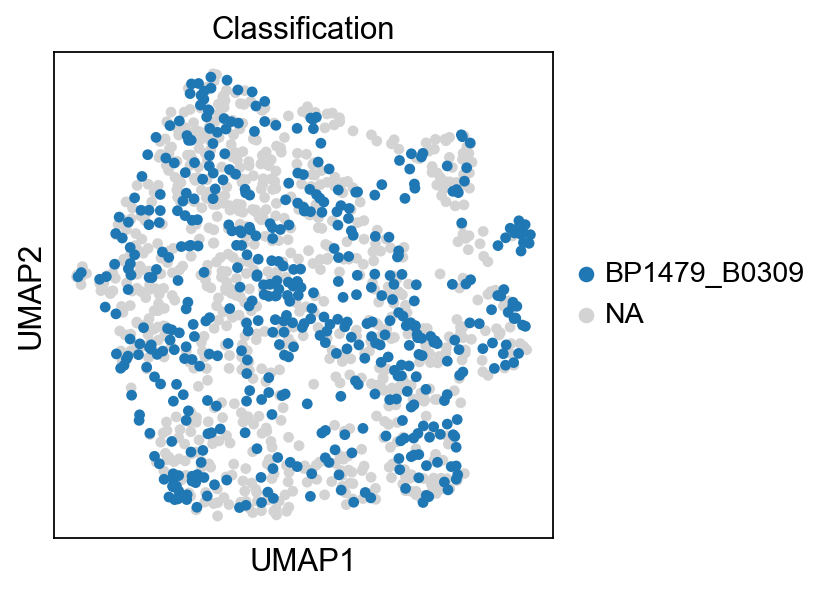

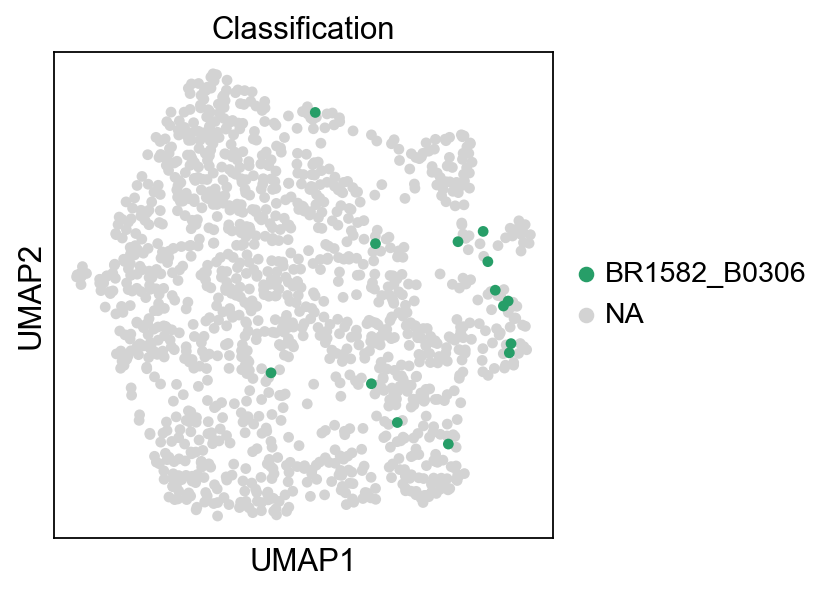

In [177]:
for label in adata.obs['Classification'].unique():
    sc.pl.umap(adata, color='Classification',groups=[label])

In [178]:
adata.obs.Group.value_counts()

Group
Hopx_12wk_14d       1264
Slc4a11_12wk_14d      14
Name: count, dtype: int64

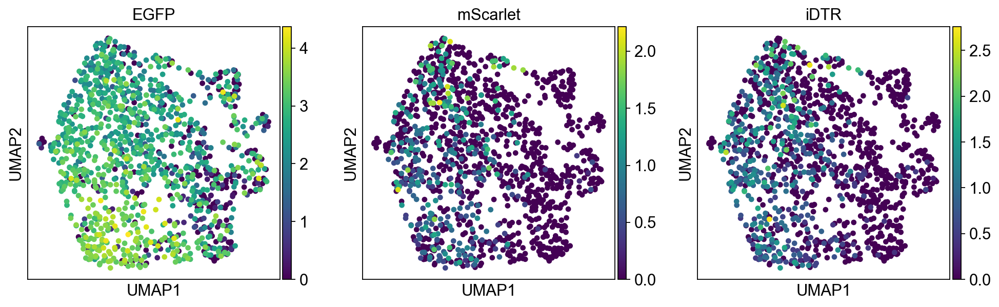

In [179]:
sc.pl.umap(adata, color=['EGFP','mScarlet','iDTR',])

In [180]:
sc.tl.embedding_density(adata,basis='umap', groupby='Group')

computing density on 'umap'
--> added
    'umap_density_Group', densities (adata.obs)
    'umap_density_Group_params', parameter (adata.uns)


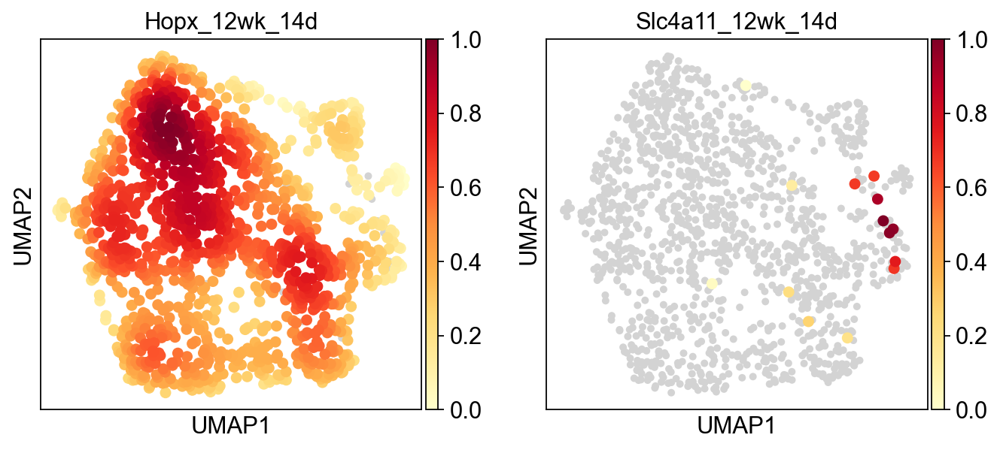

In [181]:
sc.pl.embedding_density(adata,basis='umap',key='umap_density_Group')

In [182]:
adata.obs["clusterK12"] = adata.obs["clusterK12"].astype(str).str.zfill(2).astype("category")

In [183]:
adata.obs.Classification.value_counts()

Classification
BQ1920_B0308    784
BP1479_B0309    480
BR1582_B0306     14
Name: count, dtype: int64

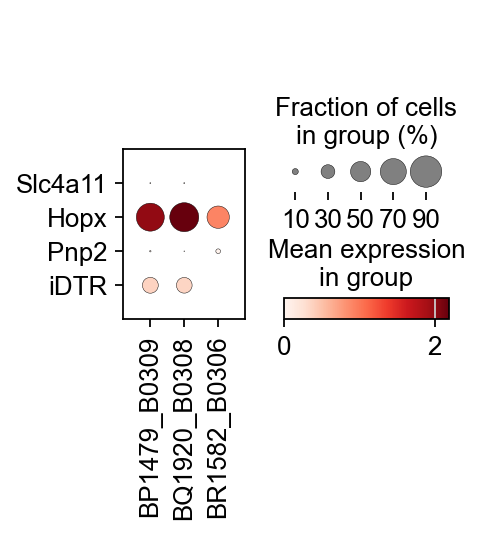

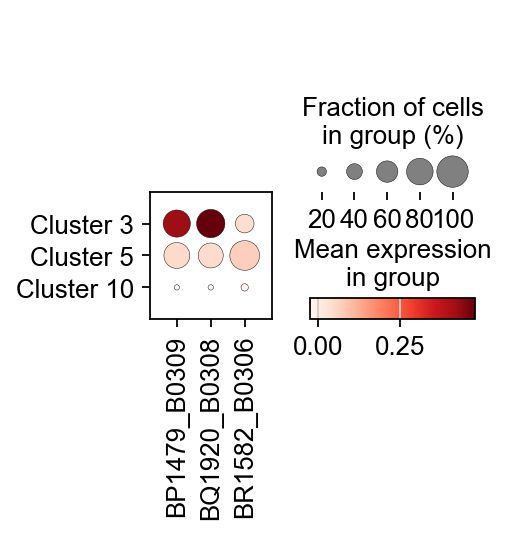

In [184]:
sc.pl.dotplot(adata, ['Slc4a11', 'Hopx','Pnp2','iDTR'], groupby='Classification',swap_axes=True)
sc.pl.dotplot(adata, ['Cluster 3', 'Cluster 5','Cluster 10'], groupby='Classification',swap_axes=True)

In [203]:
del adata.uns['leiden_colors']

running Leiden clustering
    finished: found 5 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


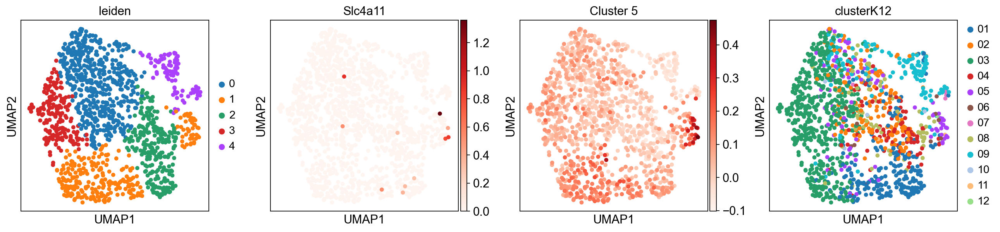

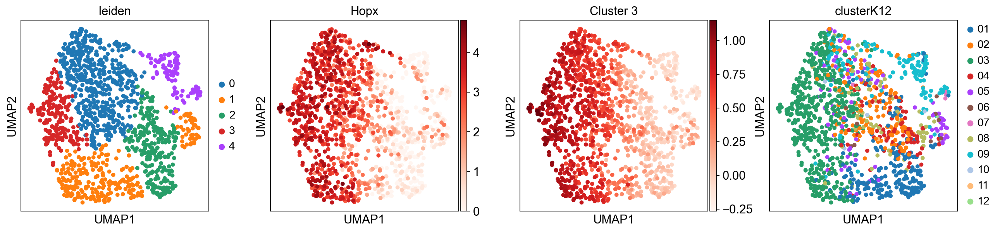

In [204]:
sc.tl.leiden(adata, resolution=.25)
sc.pl.umap(adata, color=['leiden','Slc4a11','Cluster 5', 'clusterK12'], cmap='Reds')
sc.pl.umap(adata, color=['leiden','Hopx','Cluster 3', 'clusterK12'], cmap='Reds')

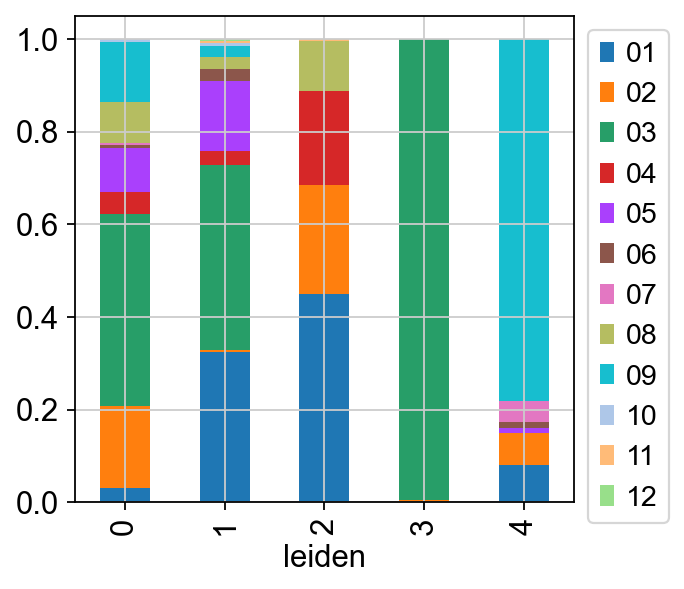

In [205]:
 cell_proportion_df = pd.crosstab(adata.obs['clusterK12'],adata.obs['leiden'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

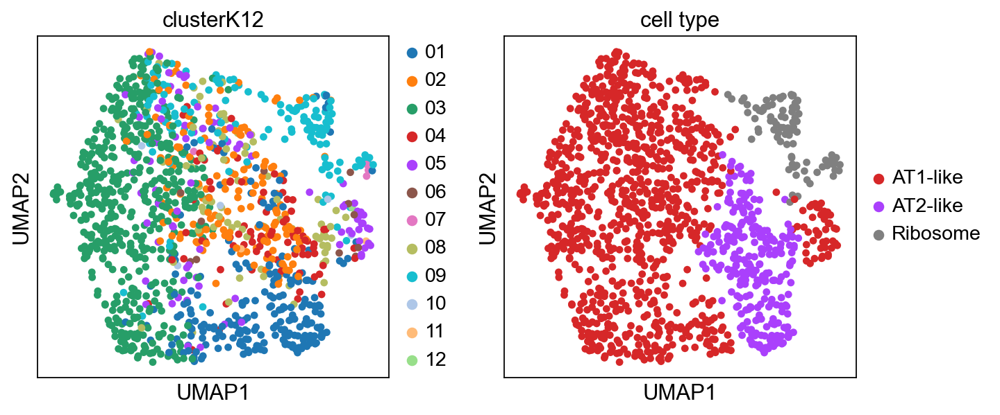

In [206]:
cluster2annotation = {
    "0": "AT1-like",
    "1": "AT1-like",
    "2": "AT2-like",
    "3": "AT1-like",
    "4": "Ribosome"
}
#"AT1-like","AT2-like",'EMT', 'HPCS',"Lung Endoderm-like",'Highly Proliferative','Embryonic liver-like'
#adata.uns['cell type_colors'] = ['#1f77b4','#279e68', '#ff7f0e', '#d62728', '#8c564b','#e377c2', '#aa40fc']

adata.obs["cell type"] = adata.obs["leiden"].map(cluster2annotation).astype("category")
#adata.obs['cell type'] = adata.obs['cell type'].cat.reorder_categories(['AT1-like', 'AT2-like', 'Embryonic liver-like','HPCS'], ordered=True)
adata.uns['cell type_colors'] = ['#d62728', '#aa40fc','grey' ] #'#ff7f0e' EMT,'#e377c2' lung endoderm, '#8c564b' highly proliferative

sc.pl.umap(adata, color=['clusterK12','cell type'])

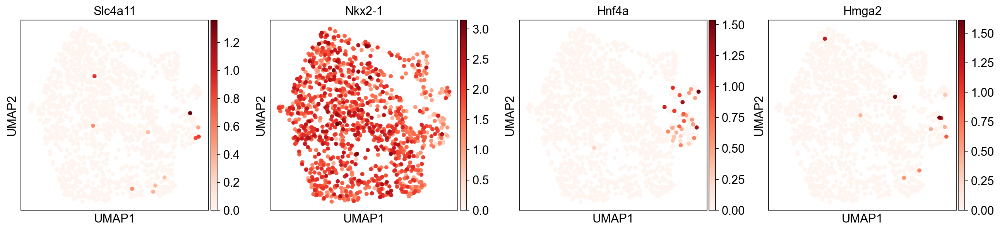

In [207]:
sc.pl.umap(adata, color=['Slc4a11','Nkx2-1','Hnf4a','Hmga2'], cmap='Reds')

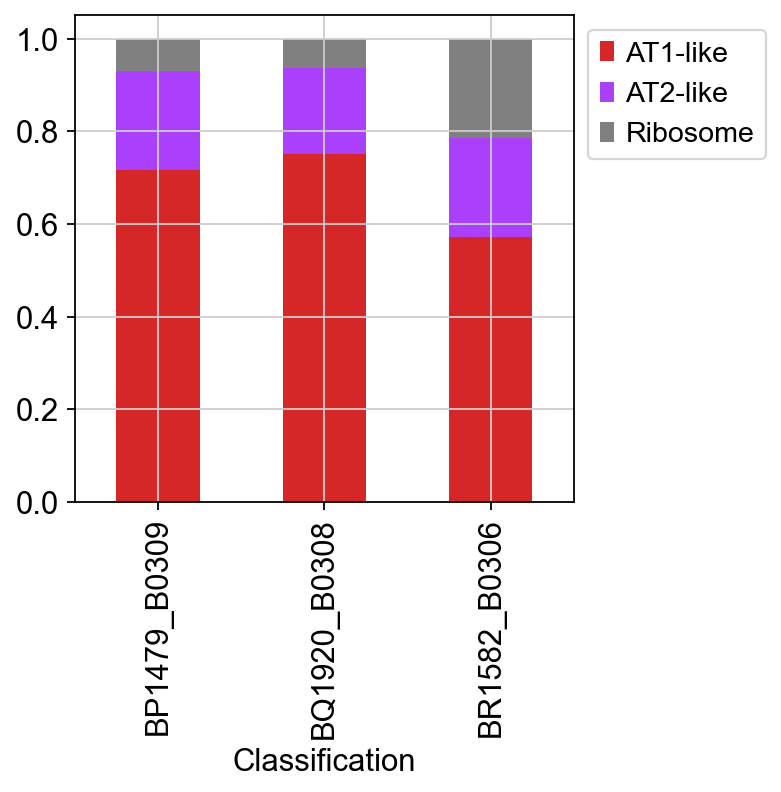

In [208]:
cell_proportion_df = pd.crosstab(adata.obs['cell type'],adata.obs['Classification'], normalize='columns').T.plot(kind='bar', stacked=True,color=adata.uns['cell type_colors']).legend(bbox_to_anchor=(1,1))

In [209]:
adata.obs.Classification.value_counts(sort=False)

Classification
BP1479_B0309    480
BQ1920_B0308    784
BR1582_B0306     14
Name: count, dtype: int64

In [210]:
adata.obs.Classification.value_counts(sort=False).index

CategoricalIndex(['BP1479_B0309', 'BQ1920_B0308', 'BR1582_B0306'], categories=['BP1479_B0309', 'BQ1920_B0308', 'BR1582_B0306'], ordered=False, dtype='category', name='Classification')

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


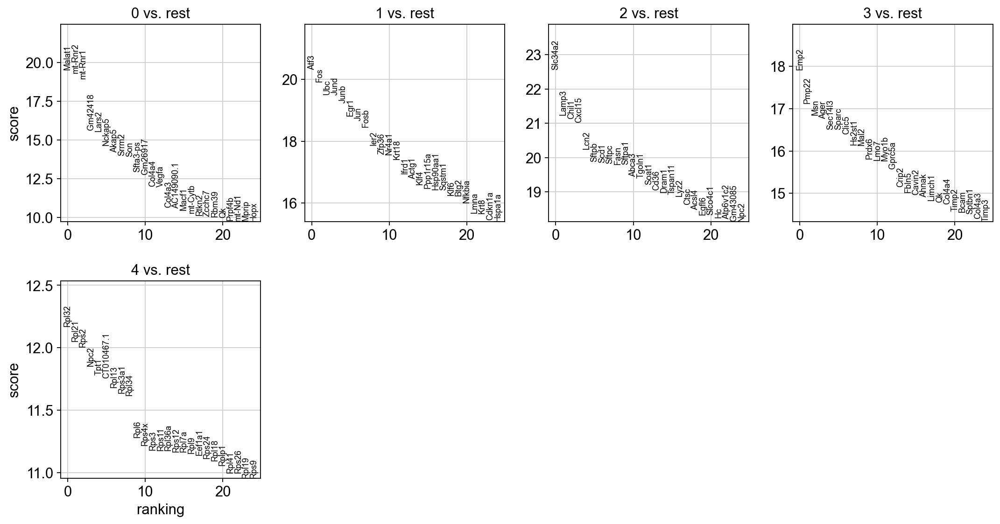

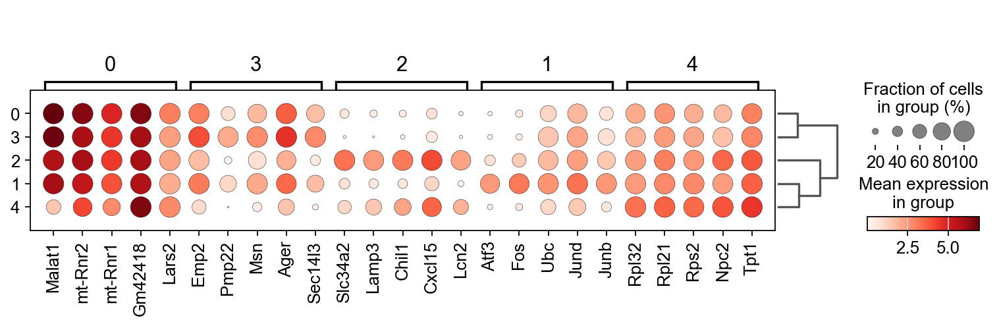

In [211]:
sc.tl.rank_genes_groups(adata, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)
sc.pl.rank_genes_groups_dotplot(adata, n_genes=5, groupby="leiden")

In [212]:
result = adata.uns['rank_genes_groups']
groups = result['names'].dtype.names
results_df = pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'pvals_adj','scores','logfoldchanges']})
results_df.to_excel('leiden_enriched_genes.xlsx')
results_df

,0_n,0_p,0_s,0_l,1_n,1_p,1_s,1_l,2_n,2_p,2_s,2_l,3_n,3_p,3_s,3_l,4_n,4_p,4_s,4_l
0,Malat1,1.055660e-80,19.545029,1.827686,Atf3,2.068543e-87,20.318016,4.763731,Slc34a2,2.288966e-108,22.563667,4.940874,Emp2,1.831064e-67,17.922384,2.107261,Rpl32,5.648234e-31,12.172050,1.754565
1,mt-Rnr2,3.142450e-79,19.335369,1.339291,Fos,2.668710e-84,19.928598,4.547592,Lamp3,4.282935e-96,21.244709,4.104875,Pmp22,9.988495e-62,17.131733,2.804842,Rpl21,2.042128e-30,12.050180,1.396838
2,mt-Rnr1,2.228724e-76,18.972477,1.184967,Ubc,6.815455e-81,19.509361,2.068234,Chil1,3.399804e-95,21.128048,4.901044,Msn,8.121203e-60,16.849981,1.897185,Rps2,3.301268e-30,12.006849,1.731965
3,Gm42418,9.910079e-52,15.666545,0.778608,Jund,6.815455e-81,19.496555,2.046347,Cxcl15,2.576197e-94,21.018539,4.873093,Ager,2.480611e-59,16.766727,2.173826,Npc2,1.905422e-29,11.853986,2.442177
4,Lars2,4.049927e-51,15.566936,1.112949,Junb,7.549366e-79,19.242676,2.832904,Lcn2,1.731839e-87,20.247597,4.532703,Sec14l3,1.306585e-57,16.505116,2.554116,Tpt1,4.100772e-29,11.783121,1.785231
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23210,Tmbim6,7.198857e-43,-14.269069,-1.041140,mt-Co1,4.284633e-28,-11.488136,-0.771718,Lmo7,3.186581e-68,-17.830221,-2.919899,Slc34a2,5.154142e-24,-10.613631,-5.575695,Son,3.318199e-37,-13.387586,-3.523605
23211,Slc25a5,2.675157e-44,-14.503436,-1.579781,Lars2,2.777486e-30,-11.923078,-1.010821,Emp2,2.667235e-69,-17.970253,-2.143225,Muc1,1.211796e-26,-11.180798,-3.336740,Vegfa,2.503157e-37,-13.425049,-4.537391
23212,Actg1,1.887774e-45,-14.699379,-1.159140,Gm42418,2.801571e-33,-12.493652,-0.695677,Clic5,1.593389e-72,-18.392450,-3.122342,Sftpa1,3.503480e-31,-12.095415,-4.869307,Neat1,9.707704e-38,-13.516225,-5.113912
23213,Eef1a1,2.543947e-52,-15.764282,-1.309491,mt-Rnr1,6.093118e-39,-13.512909,-0.833334,Akap5,9.354443e-77,-18.923868,-4.695887,Sftpc,5.860760e-32,-12.247061,-4.329937,Nckap5,3.555015e-39,-13.786745,-5.212441


## End here

## Calculate PV

## Figures for paper

# Save the result

In [194]:
adata.write(results_file, compression='gzip')